In [127]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn as skl

from pathlib import Path
# import aicsimageio
from tifffile import TiffFile

from scipy.spatial.distance import cdist

from sklearn.manifold import TSNE

from tqdm import tqdm

# from read_files import read_cizlif_files_get_data, read_cizlif_file, from_files_to_df, read_files_pipeline


import gudhi as gd
from sklearn.preprocessing import MinMaxScaler
from gudhi.hera.wasserstein import wasserstein_distance
from gudhi.bottleneck import bottleneck_distance
from gudhi.representations import Entropy, PersistenceImage, BettiCurve
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

from skimage.morphology import remove_small_objects, remove_small_holes, label
from skimage.morphology import binary_dilation
from skimage.filters import threshold_otsu
from scipy.ndimage import label
from skimage.morphology import remove_small_holes


import matplotlib
import matplotlib.pyplot as plt
from matplotlib import cm
import matplotlib as mpl
import matplotlib.patches as mpatches

import skimage
from skimage.filters import threshold_otsu
from skimage.morphology import area_closing, disk, binary_closing, remove_small_holes
from skimage.measure import label, regionprops
from skimage.io import imsave
from itertools import product
from skimage.morphology import convex_hull_image

from skimage.feature import peak_local_max
from skimage.segmentation import watershed
from scipy import ndimage as ndi

from skimage.morphology import convex_hull_image
import skimage
import skimage.io as skio

from scipy import ndimage as ndi

from skimage.segmentation import watershed
from skimage.feature import peak_local_max

from skimage import data
from skimage.filters import threshold_otsu
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import closing, square
from skimage.color import label2rgb
from skimage import data
from skimage import transform
from skimage.feature import (match_descriptors, corner_harris,
                             corner_peaks, ORB, plot_matches)
from skimage import segmentation
from skimage.segmentation import expand_labels
from skimage import filters
from skimage import morphology
from skimage import measure
from skimage.color import rgb2gray
import matplotlib.pyplot as plt

from sklearn.cluster import KMeans
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

from sklearn import metrics
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

from sklearn.preprocessing import LabelEncoder

from matplotlib import rc
rc('font',**{'family':'sans-serif','sans-serif':['Arial']})
rc('font',**{'family':'serif','serif':['Arial']})
rc('text', usetex=True)

# import cv2 as cv

In [2]:
data_dir = Path("data")
image_dir = data_dir / "images"
images_revision = image_dir / "STED_images_for_revision"
new_images = image_dir / "STED_images_for_revision" / 'Single-plane-nuclei'

segmented_dir = data_dir / "segmented"
persistence_dir = data_dir / "persistence"
persistenceregions_dir = data_dir / "persistence_regions"
persistenceminmax_dir = data_dir / "persistence_minmax"

In [3]:
import numpy as np  # For array operations and numerical computations
from skimage import filters, morphology, segmentation, measure, draw  # For image processing and analysis
from scipy import ndimage as ndi  # For distance transform and other ndimage operations
from skimage.measure import label  # For connected-component labeling
from scipy.ndimage import binary_fill_holes
from skimage.draw import ellipse_perimeter
from skimage.morphology import binary_dilation, convex_hull_image, disk

def watershed_segmentation_2d(image):
    """
    Perform watershed segmentation on a 2D image using pixels with values
    above the 90%-quantile as markers.
    
    Parameters:
        image (numpy.ndarray): 2D array representing the image to segment.
        
    Returns:
        segmented (numpy.ndarray): Segmented image with unique labels for each region.
    """
    # Compute the edges of the image for watershed algorithm
    edges = filters.scharr(image)
    
    # Denoise the image using a median filter
    denoised = ndi.median_filter(image, size=3)
    
    # Threshold the denoised image using Li's method
    threshold = filters.threshold_li(denoised)
    binary_image = denoised > threshold
    
    # Clean up small holes and objects in the binary image
    cleaned_image = morphology.remove_small_holes(binary_image, area_threshold=20**2)
    cleaned_image = morphology.remove_small_objects(cleaned_image, min_size=20**2)
    
    # Compute distance transform for marker identification
    distance = ndi.distance_transform_edt(cleaned_image)
    
    # Identify markers as local maxima above the 90%-quantile of the distance map
    quantile_threshold = np.percentile(image, 90)
    markers = (image > quantile_threshold).astype(np.uint32)
    markers = label(markers)
    
    # Perform watershed segmentation
    segmented = segmentation.watershed(edges, markers, mask=cleaned_image)

    # Join all components which are adjoined and where segmented > 0
    labelled = label(segmented > 0)


    # Find the largest component
    largest_component = (labelled == np.argmax(np.bincount(labelled.ravel())[1:]) + 1)

    # Thicken the largest component using morphological dilation
    thickened_component = binary_dilation(largest_component, footprint=disk(5))  # Adjust disk size as needed

    # Compute the convex hull of the thickened component
    convex_hull = convex_hull_image(thickened_component)

    # Update segmented to include the convex hull
    segmented = convex_hull.astype(np.uint32)

    return segmented

In [93]:
from scipy.ndimage import maximum_filter

In [4]:
file = np.load('newdata_figures/images.npz')
images_org = []
images = []
le = []
for name in tqdm(file.files):
    if 'img' in name:
        images_org.append(file[name].copy())

        img = file[name].copy()
        img = img.astype(np.float32)
        segmented = watershed_segmentation_2d(img)
        img[segmented == 0] = -1

        images.append(img.copy())
    else:
        le.append(file[name])
le = np.array(le)

  0%|          | 0/380 [00:00<?, ?it/s]

100%|██████████| 380/380 [00:06<00:00, 58.36it/s]


# Load the data and give overview

The data given are all wildtype ES or NS cells, which have already been givcen as single cells

In [ ]:
files = sorted(list(Path(new_images).rglob("*.tif")))

df_fixed = {'comparison': 'all', 'class': 'Wildtype', 'type':'WT', 'microscope':'STED'}

images = []
for i, file in enumerate(files):
    reader = aicsimageio.readers.TiffReader(file)
    print(f"Reading image from {file}:")
    print(i, reader.data.dtype)
    reader = aicsimageio.readers.TiffReader(file)
    image = reader.data.astype(np.float64)
    print(f" __ with shape {image.shape}")

    if np.max(image) > 450 and np.count_nonzero(image > 450) < 4:
        # Get the location of the maximum pixel
        max_pixel_loc = np.unravel_index(np.argmax(image), image.shape)
        # Replace the pixel with the mean of its neighbors
        x, y = max_pixel_loc
        neighbors = image[max(0, x-1):x+2, max(0, y-1):y+2]
        image[x, y] = np.mean(neighbors[neighbors != image[x, y]])
                          
    images.append(image)
    

In [ ]:
df = []
for file in files:
    tmp = {'comparison': 'all', 'class': 'Wildtype', 'type':'WT', 'microscope':'STED'}
    tmp['filename'] = file
    if 'NSC' in str(file):
        assert 'ES' not in str(file)
        tmp['type'] = 'NS'
        tmp['label'] = 1
    elif 'ESC' in str(file):
        assert 'NSC' not in str(file)
        tmp['type'] = 'ES'
        tmp['label'] = 0
    else:
        print(f"Error: {file}")
        continue
    
    print(file)
    try:
        zind = file.name.index('z_')
        zind = file.name[zind+2:zind+7]
        tmp['z1'] = int(zind.split('_')[0])
        tmp['z2'] = int(zind.split('_')[1])
    except ValueError:
        tmp['z1'] = -1
        tmp['z2'] = -1
    df.append(tmp)

df = pd.DataFrame(df)
le = df['label'].values

In [ ]:
sizes_es = [[i, images[i].shape] for i in range(len(images)) if le[i] == 0]
sizes_ns = [[i, images[i].shape] for i in range(len(images)) if le[i] == 1]

distances = cdist([s[1] for s in sizes_es], [s[1] for s in sizes_ns])
idxmin = np.where(distances == np.min(distances))

positionsES = sizes_es[idxmin[0][0]][0]
positionsNS = sizes_ns[idxmin[1][0]][0]


fig, ax = plt.subplots(1, 2, figsize=(10, 10), dpi=400)
ax[0].imshow(images[positionsES], cmap='viridis')
ax[1].imshow(images[positionsNS], cmap='viridis')

ax[0].set_title('ESC')
ax[1].set_title('NSC')

for i in range(2):
    ax[i].axis('off')

fig.tight_layout()
fig.savefig('newdata_figures/cell_images.png', dpi=400, bbox_inches='tight')

We can see that two images are larger than the others, so should probably be considered outliers

In [ ]:
## Remove images which are too large
# we can see that

sizes = [images[i].shape for i in range(len(images))]
sizes = np.array(sizes)

print(np.unique(sizes[:,0]))

idx_outliers = np.where(sizes[:,0] > 400)[0]
print('ouliers class:', le[idx_outliers])
# Hence both are ES cells!
idx_outliers_y = np.where(sizes[:,1] > 400)[0]

print('ouliers class:', le[idx_outliers_y])

print(idx_outliers, idx_outliers_y)

In [ ]:
images = [images[i] for i in range(len(images)) if i not in idx_outliers]
le = np.array([le[i] for i in range(len(le)) if i not in idx_outliers])
df = df.drop([15, 91]).reset_index(drop=True)

In [ ]:
dict_img = {f'img_{i:03d}': images[i] for i in range(len(images))}
for i in range(len(images)):
    dict_img[f'label_{i:03d}'] = le[i]

np.savez_compressed('newdata_figures/images.npz', **dict_img)

# compute persistence

In [6]:
diag0 = []
diag1 = []
diag0_scaled = []
diag1_scaled = []

images_org = [imguint.astype(np.float64) for imguint in images_org]
images_scaled = [MinMaxScaler().fit_transform(img.reshape(-1, 1)).reshape(img.shape) for img in images_org]

for img in tqdm(images_org):
    cc = gd.CubicalComplex(top_dimensional_cells=-img)
    cc.persistence()

    diag0.append(cc.persistence_intervals_in_dimension(0))
    diag1.append(cc.persistence_intervals_in_dimension(1))

    cc = gd.CubicalComplex(top_dimensional_cells=-MinMaxScaler().fit_transform(img.reshape(-1, 1)).reshape(img.shape))
    cc.persistence()

    diag0_scaled.append(cc.persistence_intervals_in_dimension(0))
    diag1_scaled.append(cc.persistence_intervals_in_dimension(1))

maxval = max([np.max(-img) for img in images_org])
for i in range(len(diag0)):
    diag0[i][diag0[i] == np.inf] = maxval

for i in range(len(diag0_scaled)):
    diag0_scaled[i][diag0_scaled[i] == np.inf] = 0


np.savez_compressed('new_persistence_diag0.npz', **{f'{i:03d}': diag0[i] for i in range(len(diag0))})
np.savez_compressed('new_persistence_diag1.npz', **{f'{i:03d}': diag1[i] for i in range(len(diag1))})
np.savez_compressed('new_persistence_diag0_scaled.npz', **{f'{i:03d}': diag0_scaled[i] for i in range(len(diag0_scaled))})
np.savez_compressed('new_persistence_diag1_scaled.npz', **{f'{i:03d}': diag1_scaled[i] for i in range(len(diag1_scaled))})

100%|██████████| 190/190 [00:34<00:00,  5.52it/s]


In [432]:
maxintensity_es = np.array([np.max(images[k]) for k in np.where(le==0)[0]])
maxintensity_ns = np.array([np.max(images[k]) for k in np.where(le==1)[0]])

# plt.plot(maxintensity_ns, 'o', label='NSC')
# plt.plot(maxintensity_es, 'o', label='ESC')

# now pick two indices where the values are close (or the same?!)
for xi, valx in enumerate(maxintensity_ns):
    for yi, valy in enumerate(maxintensity_es):
        if valx == valy:
            print(yi, xi, valx)


26 2 27.0
45 2 27.0
47 2 27.0
48 2 27.0
51 2 27.0
59 2 27.0
64 2 27.0
71 2 27.0
72 2 27.0
73 2 27.0
80 2 27.0
87 2 27.0
26 3 27.0
45 3 27.0
47 3 27.0
48 3 27.0
51 3 27.0
59 3 27.0
64 3 27.0
71 3 27.0
72 3 27.0
73 3 27.0
80 3 27.0
87 3 27.0
36 4 30.0
37 4 30.0
50 4 30.0
55 4 30.0
62 4 30.0
65 4 30.0
75 4 30.0
76 4 30.0
83 4 30.0
39 7 29.0
42 7 29.0
43 7 29.0
46 7 29.0
61 7 29.0
67 7 29.0
84 7 29.0
85 7 29.0
23 8 25.0
53 8 25.0
57 8 25.0
63 8 25.0
74 8 25.0
14 9 47.0
23 10 25.0
53 10 25.0
57 10 25.0
63 10 25.0
74 10 25.0
39 11 29.0
42 11 29.0
43 11 29.0
46 11 29.0
61 11 29.0
67 11 29.0
84 11 29.0
85 11 29.0
14 12 47.0
26 13 27.0
45 13 27.0
47 13 27.0
48 13 27.0
51 13 27.0
59 13 27.0
64 13 27.0
71 13 27.0
72 13 27.0
73 13 27.0
80 13 27.0
87 13 27.0
21 15 37.0
21 19 37.0
27 20 31.0
31 20 31.0
49 20 31.0
56 20 31.0
70 20 31.0
77 20 31.0
30 21 24.0
32 21 24.0
30 25 24.0
32 25 24.0
30 26 24.0
32 26 24.0
15 29 40.0
28 31 26.0
33 31 26.0
34 31 26.0
35 31 26.0
41 31 26.0
52 31 26.0
54 31 26.0
26

In [7]:
from matplotlib.ticker import MaxNLocator

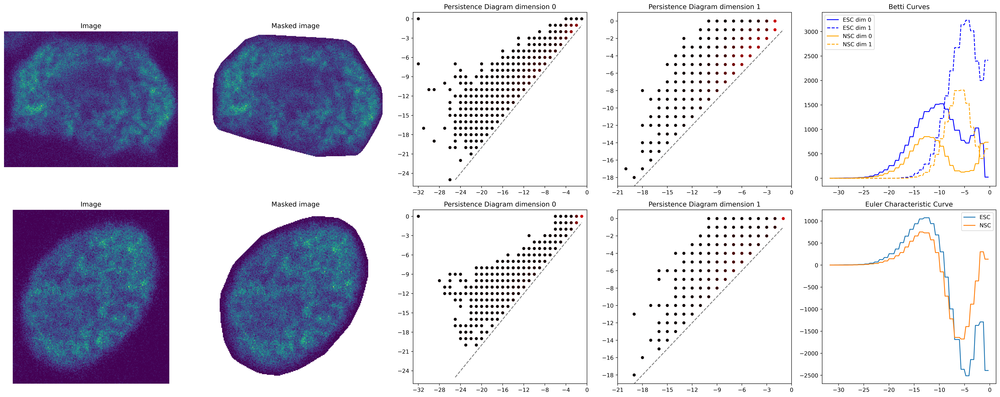

In [ ]:
fig, ax = plt.subplots(2, 5, figsize=(25, 10), dpi=400)

kimages =  [np.where(le==0)[0][79], np.where(le==1)[0][38]]

bc = BettiCurve()
betti = bc.fit_transform([diag0[kes] for kes in kimages] + [diag1[kes] for kes in kimages])
ecc = [betti[i] - betti[i+len(kimages)] for i in range(len(kimages))]

xmin = min([np.min(diag0[kes][:,0]) for kes in kimages] + [np.min(diag1[kes][:,0]) for kes in kimages])
xmax = max([np.max(diag0[kes][diag0[kes][:,1] != np.inf][:,0]) for kes in kimages]
           + [np.max(diag1[kes][diag1[kes][:,1] != np.inf][:,0]) for kes in kimages])
ymin = min([np.min(diag0[kes][:,1]) for kes in kimages] + [np.min(diag1[kes][:,1]) for kes in kimages])
ymax = max([np.max(diag0[kes][diag0[kes][:,1] != np.inf][:,1]) for kes in kimages]
           + [np.max(diag1[kes][diag1[kes][:,1] != np.inf][:,1]) for kes in kimages])

diagonal = [max(xmin, ymin), min(xmax, ymax)]

for ki, (k, kes) in enumerate(zip([0, 1], kimages)):
    ax[k, 0].imshow(images_org[kes], cmap='viridis')
    ax[k, 1].imshow(np.ma.masked_array(images[kes], images[kes]==-1), cmap='viridis')

val0, count0 = np.unique(diag0[kimages[0]], return_counts=True, axis=0)
val1, count1 = np.unique(diag0[kimages[1]], return_counts=True, axis=0)
val2, count2 = np.unique(diag1[kimages[0]], return_counts=True, axis=0)
val3, count3 = np.unique(diag1[kimages[1]], return_counts=True, axis=0)

vmax=max(np.max(count0), np.max(count1), np.max(count2), np.max(count3))

ax[0, 2].scatter(val0[:,0], val0[:,1], c=count0, s=20, vmin=1, vmax=vmax, cmap='hot')
ax[1, 2].scatter(val1[:,0], val1[:,1], c=count1, s=20, vmin=1, vmax=vmax, cmap='hot')

ax[0, 3].scatter(val2[:,0], val2[:,1], c=count2, s=20, vmin=1, vmax=vmax, cmap='hot')
ax[1, 3].scatter(val3[:,0], val3[:,1], c=count3, s=20, vmin=1, vmax=vmax, cmap='hot')

for k in range(2):
    ax[k, 2].plot([diagonal[0], diagonal[1]], [diagonal[0], diagonal[1]], c='gray', linestyle='--')
    ax[k, 3].plot([diagonal[0], diagonal[1]], [diagonal[0], diagonal[1]], c='gray', linestyle='--')

    ax[k, 2].set_xlim([min([np.min(val0[:,0]), np.max(val1[:,0])])-1, max(np.max(val0[:,0]), np.max(val1[:,0]))+1])
    ax[k, 2].set_ylim([min([np.min(val0[:,1]), np.max(val1[:,1])])-1, max(np.max(val0[:,1]), np.max(val1[:,1]))+1])

    ax[k, 3].set_xlim([min([np.min(val2[:,0]), np.max(val3[:,0])])-1, max(np.max(val2[:,0]), np.max(val3[:,0]))+1])
    ax[k, 3].set_ylim([min([np.min(val2[:,1]), np.max(val3[:,1])])-1, max(np.max(val2[:,1]), np.max(val3[:,1]))+1])

    # Force x-axis tick labels to be integers
    ax[k, 2].xaxis.set_major_locator(MaxNLocator(integer=True))
    ax[k, 2].yaxis.set_major_locator(MaxNLocator(integer=True))
    ax[k, 3].xaxis.set_major_locator(MaxNLocator(integer=True))
    ax[k, 3].yaxis.set_major_locator(MaxNLocator(integer=True))

ax[0, 4].plot(bc.grid_, betti[0], c='b', label='ESC dim 0')
ax[0, 4].plot(bc.grid_, betti[2], c='b', linestyle='--', label='ESC dim 1')
ax[0, 4].plot(bc.grid_, betti[1], c='orange', label='NSC dim 0')
ax[0, 4].plot(bc.grid_, betti[3], c='orange', linestyle='--', label='NSC dim 1')
ax[0, 4].legend()

ax[1, 4].plot(bc.grid_, ecc[0], label='ESC')
ax[1, 4].plot(bc.grid_, ecc[1], label='NSC')
ax[1, 4].legend()

ax[0, 4].set_title('Betti Curves')
ax[1, 4].set_title('Euler Characteristic Curve')
for k in range(2):
    # ax[k, 2].set_xlim([xmin, xmax])
    # ax[k, 2].set_xbound(lower=xmin, upper=xmax)
    # ax[k, 2].set_ylim([ymin, ymax])
    # ax[k, 2].set_ybound(lower=ymin, upper=ymax)

    ax[k, 0].set_title('Image')
    ax[k, 1].set_title('Masked image')
    ax[k, 2].set_title('Persistence Diagram dimension 0')
    ax[k, 3].set_title('Persistence Diagram dimension 1')

    ax[k, 0].axis('off')
    ax[k, 1].axis('off')

fig.tight_layout()
fig.savefig('newdata_figures/persistence_diagrams_pipeline.pdf', dpi=400, bbox_inches='tight')

In [6]:
diag0 = []
diag1 = []
diag0_scaled = []
diag1_scaled = []

images = [imguint.astype(np.float64) for imguint in images]
images_scaled = [MinMaxScaler().fit_transform(img.reshape(-1, 1)).reshape(img.shape) for img in images]

for img in tqdm(images):
    cc = gd.CubicalComplex(top_dimensional_cells=-img)
    cc.persistence()

    diag0.append(cc.persistence_intervals_in_dimension(0))
    diag1.append(cc.persistence_intervals_in_dimension(1))

    cc = gd.CubicalComplex(top_dimensional_cells=-MinMaxScaler(feature_range=(0, np.max(img))).fit_transform(img.reshape(-1, 1)).reshape(img.shape))
    cc.persistence()

    diag0_scaled.append(cc.persistence_intervals_in_dimension(0))
    diag1_scaled.append(cc.persistence_intervals_in_dimension(1))

maxval = max([np.max(-img) for img in images])
for i in range(len(diag0)):
    diag0[i][diag0[i] == np.inf] = maxval

for i in range(len(diag0_scaled)):
    diag0_scaled[i][diag0_scaled[i] == np.inf] = 0

np.savez_compressed('new_persistence_segmented_diag0.npz', **{f'{i:03d}': diag0[i] for i in range(len(diag0))})
np.savez_compressed('new_persistence_segmented_diag1.npz', **{f'{i:03d}': diag1[i] for i in range(len(diag1))})
np.savez_compressed('new_persistence_segmented_diag0_scaled.npz', **{f'{i:03d}': diag0_scaled[i] for i in range(len(diag0_scaled))})
np.savez_compressed('new_persistence_segmented_diag1_scaled.npz', **{f'{i:03d}': diag1_scaled[i] for i in range(len(diag1_scaled))})

100%|██████████| 190/190 [00:39<00:00,  4.82it/s]


In [ ]:
# diag0_sub = []
# diag1_sub = []
# diag0_scaled_sub = []
# diag1_scaled_sub = []

# images = [imguint.astype(np.float64) for imguint in images]
# images_scaled = [MinMaxScaler().fit_transform(img.reshape(-1, 1)).reshape(img.shape) for img in images]

# for img in tqdm(images):
#     cc = gd.CubicalComplex(top_dimensional_cells=img)
#     cc.persistence()

#     diag0_sub.append(cc.persistence_intervals_in_dimension(0))
#     diag1_sub.append(cc.persistence_intervals_in_dimension(1))

#     cc = gd.CubicalComplex(top_dimensional_cells=MinMaxScaler().fit_transform(img.reshape(-1, 1)).reshape(img.shape))
#     cc.persistence()

#     diag0_scaled_sub.append(cc.persistence_intervals_in_dimension(0))
#     diag1_scaled_sub.append(cc.persistence_intervals_in_dimension(1))

# maxval = max([np.max(img) for img in images])
# for i in range(len(diag0_sub)):
#     diag0_sub[i][diag0_sub[i] == np.inf] = maxval

# for i in range(len(diag0_scaled_sub)):
#     diag0_scaled_sub[i][diag0_scaled_sub[i] == np.inf] = 0


# np.savez_compressed('new_persistence_diag0_sublevel.npz', **{f'{i:03d}': diag0_sub[i] for i in range(len(diag0_sub))})
# np.savez_compressed('new_persistence_diag1_sublevel.npz', **{f'{i:03d}': diag1_sub[i] for i in range(len(diag1_sub))})
# np.savez_compressed('new_persistence_diag0_scaled_sublevel.npz', **{f'{i:03d}': diag0_scaled_sub[i] for i in range(len(diag0_scaled_sub))})
# np.savez_compressed('new_persistence_diag1_scaled_sublevel.npz', **{f'{i:03d}': diag1_scaled_sub[i] for i in range(len(diag1_scaled_sub))})

# LOAD THE COMPUITATIONS

In [7]:
# load the persistence diagrams
file = np.load('new_persistence_diag0.npz')
diag0 = [file[i] for i in file.files]
file = np.load('new_persistence_diag1.npz')
diag1 = [file[i] for i in file.files]
file = np.load('new_persistence_diag0_scaled.npz')
diag0_scaled = [file[i] for i in file.files]
file = np.load('new_persistence_diag1_scaled.npz')
diag1_scaled = [file[i] for i in file.files]

file = np.load('new_persistence_diag0_sublevel.npz')
diag0_sub = [file[i] for i in file.files]
file = np.load('new_persistence_diag1_sublevel.npz')
diag1_sub = [file[i] for i in file.files]
file = np.load('new_persistence_diag0_scaled_sublevel.npz')
diag0_scaled_sub = [file[i] for i in file.files]
file = np.load('new_persistence_diag1_scaled_sublevel.npz')
diag1_scaled_sub = [file[i] for i in file.files]

In [166]:
# load the persistence diagrams
file = np.load('new_persistence_segmented_diag0.npz')
diag0_seg = [file[i] for i in file.files]
file = np.load('new_persistence_segmented_diag1.npz')
diag1_seg = [file[i] for i in file.files]
file = np.load('new_persistence_segmented_diag0_scaled.npz')
diag0_seg_scaled = [file[i] for i in file.files]
file = np.load('new_persistence_segmented_diag1_scaled.npz')
diag1_seg_scaled = [file[i] for i in file.files]

In [ ]:
print('Number of ES cells: ', np.count_nonzero(le == 0), 'Number of NS cells: ', np.count_nonzero(le == 1))

# ML METTHODS

In [12]:
from sklearn.model_selection import train_test_split

def balanced_dropping_train_test_split(X, y, straty, test_size, random_state=None):
    # Ensure balanced splits
    X_train_balanced, X_test_balanced, y_train_balanced, y_test_balanced = train_test_split(
        X, y, test_size=test_size, stratify=straty, random_state=random_state
    )
    if np.std(np.bincount(y_train_balanced)) != 0 or np.std(np.bincount(y_test_balanced)) != 0:
        # Find the minimum count of samples in each class
        min_count = min(np.bincount(y_train_balanced))

        # Drop samples to balance the classes in the training set
        indices_to_keep = np.hstack([
            np.random.choice(np.where(y_train_balanced == 0)[0], min_count, replace=False),
            np.random.choice(np.where(y_train_balanced == 1)[0], min_count, replace=False)
        ])
        X_train_balanced = X_train_balanced[indices_to_keep]
        y_train_balanced = y_train_balanced[indices_to_keep]

        # Drop samples to balance the classes in the test set
        min_count_test = min(np.bincount(y_test_balanced))
        indices_to_keep_test = np.hstack([
            np.random.choice(np.where(y_test_balanced == 0)[0], min_count_test, replace=False),
            np.random.choice(np.where(y_test_balanced == 1)[0], min_count_test, replace=False)
        ])
        X_test_balanced = X_test_balanced[indices_to_keep_test]
        y_test_balanced = y_test_balanced[indices_to_keep_test]

    assert np.std(np.bincount(y_train_balanced)) == 0
    assert np.std(np.bincount(y_test_balanced)) == 0

    return X_train_balanced, X_test_balanced, y_train_balanced, y_test_balanced

# ML and histogram

In [99]:
histograms = []
histograms_scaled = []

bins = [min([np.min(img) for img in images]), max([np.max(img) for img in images])]
bins = np.linspace(bins[0], bins[1], 100)

for i in range(len(images)):
    hist, _ = np.histogram(images[i].flatten(), bins=bins)
    histograms.append(hist)
histograms = np.array(histograms)

Text(0.5, 1.0, 'NSC')

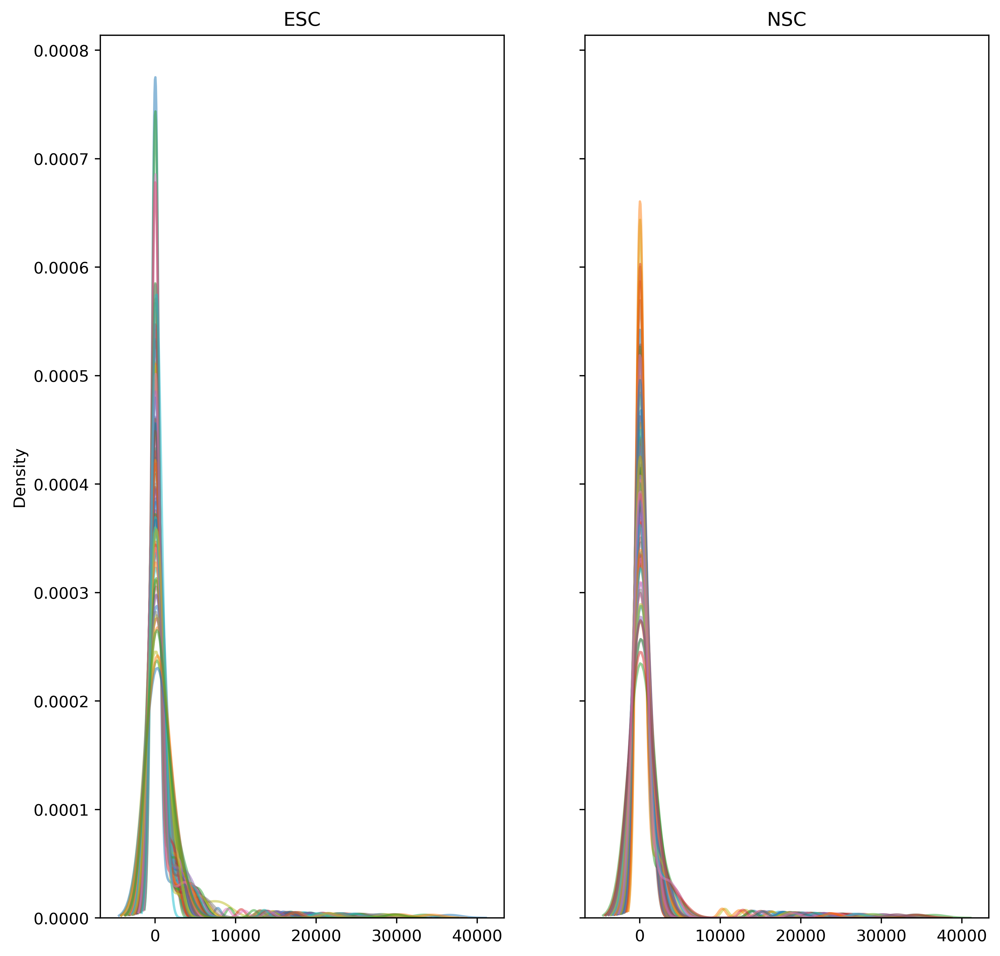

In [100]:
fig, ax = plt.subplots(1, 2, figsize=(10, 10), dpi=400, sharey=True, sharex=True)
for i in range(len(histograms)):
    # ax[le[i]].plot(bins[:-1], histograms[i], alpha=0.5)
    sns.kdeplot(histograms[i], ax=ax[le[i]], alpha=0.5)

ax[0].set_title('ESC')
ax[1].set_title('NSC')

In [101]:


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(histograms, le, test_size=0.2)

cols_keep = np.where(np.std(X_train, axis=0) != 0)[0]
X_train = X_train[:, cols_keep]
X_test = X_test[:, cols_keep]

# Create a random classifier
random_clf = RandomForestClassifier()

# Train the classifier
random_clf.fit(X_train, y_train)

# Make predictions
y_pred = random_clf.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(report)


Accuracy: 0.9736842105263158
Classification Report:
              precision    recall  f1-score   support

           0       0.94      1.00      0.97        16
           1       1.00      0.95      0.98        22

    accuracy                           0.97        38
   macro avg       0.97      0.98      0.97        38
weighted avg       0.98      0.97      0.97        38



In [102]:
confusion_matrices = []

for i in range(20):
    X_train, X_test, y_train, y_test = \
        balanced_dropping_train_test_split(histograms, le, le, test_size=0.2, random_state=i)

    cols_keep = np.where(np.std(X_train, axis=0) != 0)[0]
    X_train = X_train[:, cols_keep]
    X_test = X_test[:, cols_keep]

    # Create a random classifier
    random_clf = RandomForestClassifier()

    # Train the classifier
    random_clf.fit(X_train, y_train)

    # Make predictions
    y_pred = random_clf.predict(X_test)

    confusion_matrices.append(confusion_matrix(y_test, y_pred))

agg_confusionmatrix = np.mean(confusion_matrices, axis=0)

# Calculate accuracy, precision, recall, and F1-score from the aggregated confusion matrix
tn, fp, fn, tp = agg_confusionmatrix.ravel()

accuracy = (tp + tn) / (tp + tn + fp + fn)
precision = tp / (tp + fp)
recall = tp / (tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)

print(f"Aggregated Accuracy: {accuracy}")
print(f"Aggregated Precision: {precision}")
print(f"Aggregated Recall: {recall}")
print(f"Aggregated F1 Score: {f1_score}")

Aggregated Accuracy: 0.9539473684210527
Aggregated Precision: 0.9575596816976127
Aggregated Recall: 0.9500000000000001
Aggregated F1 Score: 0.9537648612945839


now let's consider the scaled images

In [103]:
histograms = []
histograms_scaled = []

bins = np.linspace(0, 1, 100)

for i in range(len(images)):
    hist, _ = np.histogram(MinMaxScaler().fit_transform(images[i].reshape(-1,1)), bins=bins)
    histograms.append(hist)

histograms = np.array(histograms)

confusion_matrices = []

for i in range(20):
    X_train, X_test, y_train, y_test = \
        balanced_dropping_train_test_split(histograms, le, le, test_size=0.2, random_state=i)

    cols_keep = np.where(np.std(X_train, axis=0) != 0)[0]
    X_train = X_train[:, cols_keep]
    X_test = X_test[:, cols_keep]

    # Create a random classifier
    random_clf = RandomForestClassifier()

    # Train the classifier
    random_clf.fit(X_train, y_train)

    # Make predictions
    y_pred = random_clf.predict(X_test)

    confusion_matrices.append(confusion_matrix(y_test, y_pred))

agg_confusionmatrix = np.mean(confusion_matrices, axis=0)

# Calculate accuracy, precision, recall, and F1-score from the aggregated confusion matrix
tn, fp, fn, tp = agg_confusionmatrix.ravel()

accuracy = (tp + tn) / (tp + tn + fp + fn)
precision = tp / (tp + fp)
recall = tp / (tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)

print(f"Aggregated Accuracy: {accuracy}")
print(f"Aggregated Precision: {precision}")
print(f"Aggregated Recall: {recall}")
print(f"Aggregated F1 Score: {f1_score}")

Aggregated Accuracy: 0.8697368421052633
Aggregated Precision: 0.8935574229691877
Aggregated Recall: 0.8394736842105263
Aggregated F1 Score: 0.8656716417910448


Do otsu thresholding and then do histogramn

In [104]:
from skimage.filters import threshold_otsu



In [105]:
otsu_min = np.inf
otsu_max = -np.inf

for img in images:
    thresh = threshold_otsu(img)
    otsu_max = max(otsu_max, thresh)
    otsu_min = min(otsu_min, thresh)

In [106]:
histograms_min = []
histograms_max = []

bins = [min([np.min(img) for img in images]), max([np.max(img) for img in images])]
bins_min = [otsu_min, bins[1]]
bins_max = [bins[0], otsu_max]

for i in range(len(images)):
    img = images[i].reshape(-1,1)
    img_min = img[img >= otsu_min]
    img_max = img[img >= otsu_max]
    
    hist, _ = np.histogram(img_min, bins=bins_min)
    histograms_min.append(hist)

    hist, _ = np.histogram(img_max, bins=bins_max)
    histograms_max.append(hist)

histograms_min = np.array(histograms_min)
histograms_max = np.array(histograms_max)

In [107]:
confusion_matrices = []

for i in range(20):
    X_train, X_test, y_train, y_test = \
        balanced_dropping_train_test_split(histograms_min, le, le, test_size=0.2, random_state=i)

    cols_keep = np.where(np.std(X_train, axis=0) != 0)[0]
    X_train = X_train[:, cols_keep]
    X_test = X_test[:, cols_keep]

    # Create a random classifier
    random_clf = RandomForestClassifier()

    # Train the classifier
    random_clf.fit(X_train, y_train)

    # Make predictions
    y_pred = random_clf.predict(X_test)

    confusion_matrices.append(confusion_matrix(y_test, y_pred))

agg_confusionmatrix = np.mean(confusion_matrices, axis=0)

# Calculate accuracy, precision, recall, and F1-score from the aggregated confusion matrix
tn, fp, fn, tp = agg_confusionmatrix.ravel()

accuracy = (tp + tn) / (tp + tn + fp + fn)
precision = tp / (tp + fp)
recall = tp / (tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)

print(f"Aggregated Accuracy: {accuracy}")
print(f"Aggregated Precision: {precision}")
print(f"Aggregated Recall: {recall}")
print(f"Aggregated F1 Score: {f1_score}")

Aggregated Accuracy: 0.7223684210526315
Aggregated Precision: 0.7315068493150685
Aggregated Recall: 0.7026315789473684
Aggregated F1 Score: 0.7167785234899328


threshold via percentage

In [108]:
histograms = []

bins = np.linspace(0, 1, 100)

for i in range(len(images)):
    img = MinMaxScaler().fit_transform(images[i].reshape(-1,1))
    img = img[img >= 0.1]
    hist, _ = np.histogram(img, bins=bins)
    histograms.append(hist)

histograms = np.array(histograms)

confusion_matrices = []
for i in range(20):
    X_train, X_test, y_train, y_test = \
        balanced_dropping_train_test_split(histograms, le, le, test_size=0.2, random_state=i)

    cols_keep = np.where(np.std(X_train, axis=0) != 0)[0]
    X_train = X_train[:, cols_keep]
    X_test = X_test[:, cols_keep]

    # Create a random classifier
    random_clf = RandomForestClassifier()

    # Train the classifier
    random_clf.fit(X_train, y_train)

    # Make predictions
    y_pred = random_clf.predict(X_test)

    confusion_matrices.append(confusion_matrix(y_test, y_pred))

agg_confusionmatrix = np.mean(confusion_matrices, axis=0)

# Calculate accuracy, precision, recall, and F1-score from the aggregated confusion matrix
tn, fp, fn, tp = agg_confusionmatrix.ravel()

accuracy = (tp + tn) / (tp + tn + fp + fn)
precision = tp / (tp + fp)
recall = tp / (tp + fn)
f1_score = 2 * (precision * recall) / (precision + recall)

print(f"Aggregated Accuracy: {accuracy}")
print(f"Aggregated Precision: {precision}")
print(f"Aggregated Recall: {recall}")
print(f"Aggregated F1 Score: {f1_score}")

Aggregated Accuracy: 0.8276315789473684
Aggregated Precision: 0.8448753462603877
Aggregated Recall: 0.8026315789473685
Aggregated F1 Score: 0.8232118758434548


# ML and persistence

In [131]:
# load the methods from helper_functions.py
from helper_functions import grid_search_noscaling, same_size_training,\
    combine_data, drop_all_same, persistence_statistics, majority_labels

In [14]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import precision_score, recall_score, balanced_accuracy_score

In [18]:
def large_classification(data_0, data_1, labels, train_test_splits, results, prefix):
    for k, train_test in tqdm(enumerate(train_test_splits)):
        train_idx = train_test[0]
        test_idx = train_test[1]

        y_train = labels[train_idx]
        y_test = labels[test_idx]   

        # DO IT FOR DIMENSION 0
        data = data_0.copy()

        persstats_ls, colnames = persistence_statistics(data, return_names=True, lifespan=True)

        ent = Entropy(mode='scalar', normalized=False)
        pers_ent_train = ent.fit_transform([data[i] for i in train_idx])
        pers_ent_test = ent.transform([data[i] for i in test_idx])

        ent = Entropy(mode='scalar', normalized=True)
        pers_entnorm_train = ent.fit_transform([data[i] for i in train_idx])
        pers_entnorm_test = ent.transform([data[i] for i in test_idx])

        inv_bc = BettiCurve(resolution=250)
        inv_pi = PersistenceImage(bandwidth=5, resolution=[20, 20])

        pers_bc_train = inv_bc.fit_transform([data[i] for i in train_idx])
        pers_pi_train = inv_pi.fit_transform([data[i] for i in train_idx])

        pers_bc_test = inv_bc.transform([data[i] for i in test_idx])
        pers_pi_test = inv_pi.transform([data[i] for i in test_idx])

        # exclude all which are the same for each sample in the training set
        idx_keep, pers_bc_train = drop_all_same(pers_bc_train)
        pers_bc_test = pers_bc_test[:, idx_keep]

        idx_keep, pers_pi_train = drop_all_same(pers_pi_train)
        pers_pi_test = pers_pi_test[:, idx_keep]

        # NOW DO IT FOR DIMENSION 1
        data = data_1.copy()

        persstats_ls1, colnames = persistence_statistics(data, return_names=True, lifespan=True)

        ent = Entropy(mode='scalar', normalized=False)
        pers_ent_train1 = ent.fit_transform([data[i] for i in train_idx])
        pers_ent_test1 = ent.transform([data[i] for i in test_idx])

        ent = Entropy(mode='scalar', normalized=True)
        pers_entnorm_train1 = ent.fit_transform([data[i] for i in train_idx])
        pers_entnorm_test1 = ent.transform([data[i] for i in test_idx])

        inv_bc = BettiCurve(resolution=250)
        inv_pi = PersistenceImage(bandwidth=5, resolution=[20, 20])

        pers_bc_train1 = inv_bc.fit_transform([data[i] for i in train_idx])
        pers_pi_train1 = inv_pi.fit_transform([data[i] for i in train_idx])

        pers_bc_test1 = inv_bc.transform([data[i] for i in test_idx])
        pers_pi_test1 = inv_pi.transform([data[i] for i in test_idx])

        # exclude all which are the same for each sample in the training set
        idx_keep, pers_bc_train1 = drop_all_same(pers_bc_train1)
        pers_bc_test1 = pers_bc_test1[:, idx_keep]

        idx_keep, pers_pi_train1 = drop_all_same(pers_pi_train1)
        pers_pi_test1 = pers_pi_test1[:, idx_keep]

        
        for invarianttype in ['statistics', 'entropy', 'entropynorm', 'betti', 'image']:
            if invarianttype == 'statistics':
                X_train = np.hstack([persstats_ls, persstats_ls1])
                X_test = X_train[test_idx]
                X_train = X_train[train_idx]
            elif invarianttype == 'entropy':
                X_train = np.hstack([pers_ent_train, pers_ent_train1])
                X_test = np.hstack([pers_ent_test, pers_ent_test1])
            elif invarianttype == 'entropynorm':
                X_train = np.hstack([pers_entnorm_train, pers_entnorm_train1])
                X_test = np.hstack([pers_entnorm_test, pers_entnorm_test1])
            elif invarianttype == 'betti':
                X_train = np.hstack([pers_bc_train, pers_bc_train1])
                X_test = np.hstack([pers_bc_test, pers_bc_test1])
            elif invarianttype == 'image':
                X_train = np.hstack([pers_pi_train, pers_pi_train1])
                X_test = np.hstack([pers_pi_test, pers_pi_test1])
            else:
                raise ValueError('Invariant type not recognized')

            idx_keep, X_train = drop_all_same(X_train)
            X_test = X_test[:, idx_keep]

            # Due to different scaling and outliers in the test set, we need to take care of these
            # before trying to use the classifiers, here we just replace them with the mean values
            # of the training sets.
            ss = StandardScaler()
            X_train = ss.fit_transform(X_train)
            X_test = ss.transform(X_test)

            idx_fill = np.where(np.abs(X_test) >= np.finfo(np.float32).max)
            X_test[idx_fill] = np.mean(X_train[:, idx_fill[1]], axis=0)
            idx_fill = np.where(np.isnan(X_test))
            X_test[idx_fill] = np.mean(X_train[:, idx_fill[1]], axis=0)

            gs = grid_search_noscaling(X_train, y_train.ravel(),
                                       verbose=0, disable_tqdm=True)

            # now for the dictionary to add
            accuracy_train = gs.score(X_train, y_train.ravel())
            # since accuracy is the same as weighted recall in this case, just ignore accuracy
            # accuracy = gs.score(X_test, y_test.ravel())

            y_pred = gs.predict(X_test)

            precision = precision_score(y_test.ravel(), y_pred, average='weighted', zero_division=0)
            recall = recall_score(y_test.ravel(), y_pred, average='weighted', zero_division=0)

            tmp_dict = {'prefix': prefix,
                        'type': invarianttype,
                        'accuracy_balanced': balanced_accuracy_score(y_test, y_pred),
                        'accuracy_train': accuracy_train,
                        'precision': precision,
                        'recall': recall,
                        'run': k}
            results.append(tmp_dict.copy())
    return results

In [25]:
train_percent = '70'
runs = 20

train_test_splits = same_size_training(le, size=2*runs, train_size=int(train_percent)/100, seed=42)

_, indices_unique = np.unique([x[0] for x in train_test_splits], axis=0, return_index=True)
train_test_splits = [train_test_splits[indices_unique[i]] for i in indices_unique]
train_test_splits = train_test_splits[:runs]

In [ ]:
results = []
labels = le.copy()

results = large_classification(diag0_seg, diag1_seg, labels, train_test_splits, results, '2D')
results = large_classification(diag0_seg_scaled, diag1_seg_scaled, labels, train_test_splits, results, '2D_minmax')

20it [07:21, 22.09s/it]
20it [06:58, 20.94s/it]


In [ ]:
# results = []
# labels = le.copy()

# results = large_classification(diag0, diag1, labels, train_test_splits, results, '2D_nonseg')
# results = large_classification(diag0_scaled, diag1_scaled, labels, train_test_splits, results, '2D_nonseg_minmax')

20it [08:06, 24.32s/it]
20it [08:08, 24.43s/it]


In [50]:
df_results = pd.DataFrame(results)
df_results_table = df_results.groupby(['prefix', 'type']).median().reset_index().sort_values('accuracy_balanced', ascending=False)
df_results_table.rename(columns={'accuracy_balanced': 'Balanced Accuracy', 'type': 'Invariant', 'prefix': 'Image preprocessing'}, inplace=True)
df_results_table.drop(columns='run', inplace=True)

In [ ]:
# df_results = pd.DataFrame(results)
# df_results.to_csv('newdata_figures/results_classification70percentTraining_20runs_nonmaskedimage.csv', index=False)

In [54]:
df_results = pd.DataFrame(results)
df_results.to_csv(f'newdata_figures/classification_{train_percent}percentTraining_{runs}runs_maskedimage2.csv', index=False)

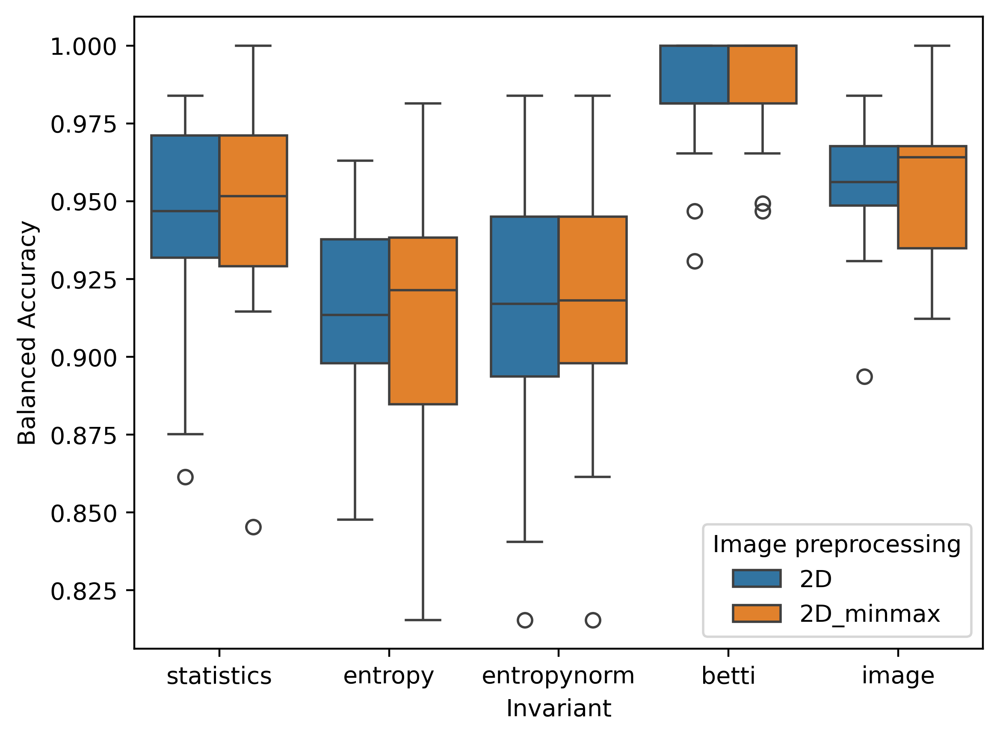

In [52]:
fig, ax = plt.subplots(1,1,dpi=400)
df_results.rename(columns={'accuracy_balanced': 'Balanced Accuracy', 'type': 'Invariant', 'prefix': 'Image preprocessing'}, inplace=True)
sns.boxplot(data=df_results, x='Invariant', y='Balanced Accuracy', hue='Image preprocessing', ax=ax)
fig.savefig('newdata_figures/boxplot_accuracy_maskedimages2.png', dpi=400, bbox_inches='tight')

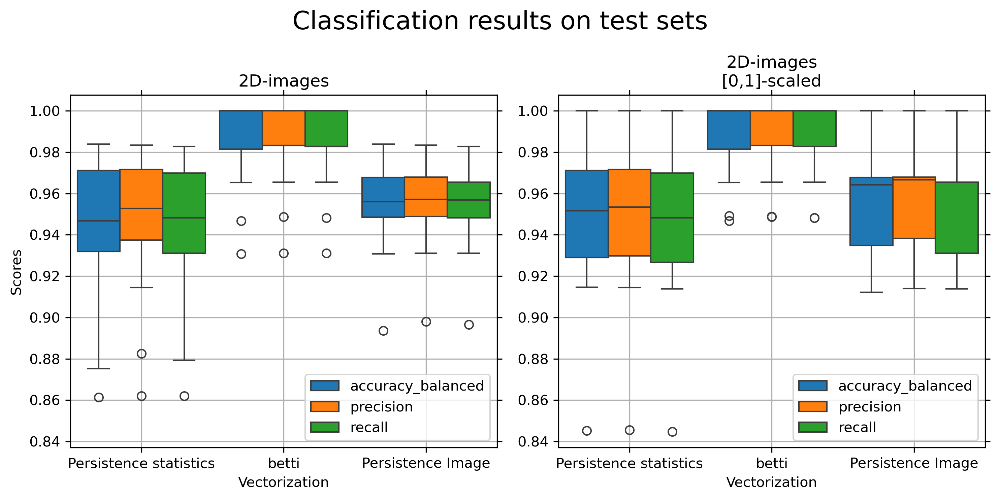

In [75]:
fig, ax = plt.subplots(1,2, dpi=300, figsize=(10,5), sharey=True)

df_plot = df_results.loc[(df_results['type'] != 'entropy') & (df_results['type'] != 'entropynorm')]

for i, prefix_i in enumerate(prefix_new):
    # axi = np.unravel_index(i, [2,2])
    axi = i
    
    sns.boxplot(data=df_plot.loc[df_plot['prefix']==prefix_i].melt(id_vars=['prefix', 'invariant'],
                                                                         value_vars=['accuracy_balanced', 'precision', 'recall']),
                x="invariant", y="value", hue="variable",
                saturation=1, width=0.9, #notch=True,
                ax=ax[axi])
    ax[axi].tick_params(reset=True)
    ax[axi].legend()
    ax[axi].set_axisbelow(True)
    ax[axi].grid()
    ax[axi].set_xlabel('Vectorization')
    ax[axi].set_ylabel('Scores')
    ax[axi].set_title(prefix_names_short[i])

fig.suptitle('Classification results on test sets', fontsize=18, y=0.98)
fig.tight_layout()
# fig.savefig(Path(plot_path, f'classification_resultsontestset_{train_percent}percentTraining_{runs}runs_box.pdf'), bbox_inches='tight')

In [66]:
file_to_load = Path('newdata_figures/classification_70percentTraining_20runs_maskedimage2.csv')

assert file_to_load.is_file()

train_percent = int(file_to_load.name.split('_')[1][:file_to_load.name.split('_')[1].index('p')])
runs = int(file_to_load.name.split('_')[2][:file_to_load.name.split('_')[2].index('r')])

df_results = pd.read_csv(file_to_load)
df_results['invariant'] = df_results['type'].replace({'statistics': 'Persistence statistics',
                                                      'bc': 'Betti Curve',
                                                      'image': 'Persistence Image',
                                                      'entropy': 'Entropy',
                                                      'entropynorm': 'Normalized entropy'})

prefix = ['2D', '2D_minmax']
prefix_new = ['pers_2d', 'pers_2d_minmax']
prefix_names = ['Persistence on 2D-aggregated images with original intensity values', 
                'Persistence on 2D-aggregated images with [0,1]-scaled intensity values']
df_results['prefix_long'] = df_results['prefix'].replace({prefix[i]: prefix_names[i] for i in range(len(prefix))})
df_results['prefix'] = df_results['prefix'].replace({prefix[i]: prefix_new[i] for i in range(len(prefix))})
df_results.head()

,prefix,type,accuracy_balanced,accuracy_train,precision,recall,run,invariant,prefix_long
0,pers_2d,statistics,0.946834,0.992424,0.948690,0.948276,0,Persistence statistics,Persistence on 2D-aggregated images with origi...
1,pers_2d,entropy,0.951613,0.992424,0.953448,0.948276,0,Entropy,Persistence on 2D-aggregated images with origi...
2,pers_2d,entropynorm,0.951613,0.984848,0.953448,0.948276,0,Normalized entropy,Persistence on 2D-aggregated images with origi...
3,pers_2d,betti,0.981481,1.000000,0.983297,0.982759,0,betti,Persistence on 2D-aggregated images with origi...
4,pers_2d,image,0.949223,0.992424,0.948933,0.948276,0,Persistence Image,Persistence on 2D-aggregated images with origi...


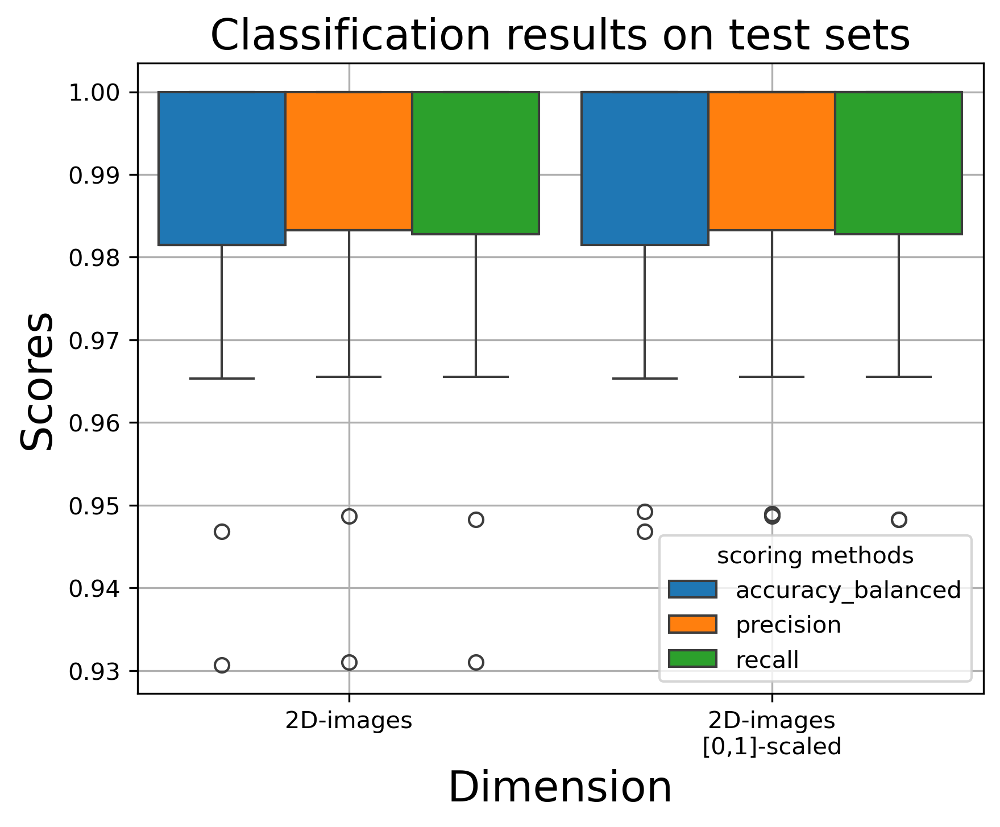

In [90]:
# now let's just pick the best perfoming vectorization

df_plot_selec = df_results[['type', 'prefix', 'accuracy_balanced', 'accuracy_train', 'precision', 'recall']]\
    .groupby(['type', 'prefix']).agg(['mean', 'std'])
for col in np.unique([x[0] for x in df_plot_selec.columns]):
    df_plot_selec[f'{col}-std'] = df_plot_selec[(col, 'mean')] - df_plot_selec[(col, 'std')]
df_plot_selec = df_plot_selec.reset_index().sort_values(by=[('prefix', ''), ('accuracy_balanced-std', ''), ('precision-std', ''), ('recall-std', ''), ('accuracy_balanced', 'mean'), ('precision', 'mean'), ('recall', 'mean'), 
                        ('accuracy_train-std', ''), ('accuracy_train', 'mean')], ascending=False)
df_plot = df_plot_selec.drop_duplicates(subset=('prefix', ''))

# get the conditions for the best perfomaing vectorizations
condition = df_results['type'].isna()
for cond in df_plot[['type', 'prefix']].values:
    condition |= (df_results['type'] == cond[0]) & (df_results['prefix'] == cond[1])

df_plot = df_results.loc[condition]
df_plot = df_plot.melt(id_vars=['prefix'], value_vars=['accuracy_balanced', 'precision', 'recall'],
                       var_name='scoring methods')


prefix = ['pers_2d', 'pers_2d_minmax']
prefix_names_short = ['2D-images', '2D-images\n[0,1]-scaled']
df_plot['prefix_short'] = df_plot['prefix'].replace({prefix[i]: prefix_names_short[i] for i in range(len(prefix))})

## NOW plot
fig, ax = plt.subplots(1,1, dpi=300)
sns.boxplot(data=df_plot, x="prefix_short", y="value", hue="scoring methods",
            saturation=1, width=0.9, #notch=True,
            ax=ax)

ax.set_axisbelow(True)
ax.grid()
ax.set_xlabel('Dimension', fontsize=18)
ax.set_ylabel('Scores', fontsize=18)
ax.set_title('Classification results on test sets', fontsize=18)

fig.savefig(Path('newdata_figures', f'classification_{train_percent}percentTraining_{runs}runs_box.pdf'), bbox_inches='tight')

# K-means

In [ ]:
pers_all = {'pers_2d': [diag0_seg, diag1_seg], 'pers_2d_minmax': [diag0_seg_scaled, diag1_seg_scaled]}

In [ ]:
inv_bc = BettiCurve(resolution=250)
inv_pi = PersistenceImage(bandwidth=5, resolution=[20, 20])

# set the parameters which are to be used if the
# dataframes df_bc and df_pi do not exist
resolution_bc = 250
resolution_pi = 20
bandwidth = 5
# decide to overwrite these parameters with those form the dataframe
overwrite_pi_parameters = True

data_df = []
data_df_cols = []

num_samples = len(labels)
train_idx = np.arange(len(labels))

for prefixi in tqdm(range(len(prefix))):
    resolution_pi = 20
    bandwidth = 4
    
    for dim in range(len(pers_all[prefix[prefixi]])):
        data = pers_all[prefix[prefixi]][dim]

        # for the persistence statistics we also include having the values encountered
        # in the persistence diagrams to be included as individual points
        persstats, colnames = persistence_statistics(data, return_names=True, lifespan=False)
        persstats_ls, colnames_ls = persistence_statistics(data, return_names=True)
        pers_st_train = persstats[train_idx, :]
        pers_stlt_train = persstats[train_idx, :]

        # for entropy we mix the scalar version with its vector version
        # once for the unnormalized
        ent = Entropy(mode='vector', normalized=False)
        pers_ent_train = ent.fit_transform([data[i] for i in train_idx])
        ent = Entropy(mode='scalar', normalized=False)
        pers_ent_train = np.hstack([ent.fit_transform([data[i] for i in train_idx]),
                                    pers_ent_train])

        # ...and once for the normalized version
        ent = Entropy(mode='vector', normalized=True)
        pers_entnorm_train = ent.fit_transform([data[i] for i in train_idx])
        ent = Entropy(mode='scalar', normalized=True)
        pers_entnorm_train = np.hstack([ent.fit_transform([data[i] for i in train_idx]),
                                        pers_entnorm_train])

        inv_bc = BettiCurve(resolution=resolution_bc)
        inv_pi = PersistenceImage(bandwidth=bandwidth, resolution=[resolution_pi, resolution_pi])

        pers_bc_train = inv_bc.fit_transform([data[i] for i in train_idx])
        pers_pi_train = inv_pi.fit_transform([data[i] for i in train_idx])

        # exclude all which are the same for each sample in the training set
        # idx_keep, pers_st_train = drop_all_same(pers_st_train)
        idx_keep, pers_bc_train = drop_all_same(pers_bc_train)
        idx_keep, pers_pi_train = drop_all_same(pers_pi_train)
        # idx_keep = np.where(np.std(pers_st_train, axis=0) != 0)[0]

        # stack_array = []
        # [np.asarray([prefix]*num_samples).reshape(-1,1),
        #                dim*np.ones([num_samples, 1])]
        # columnsnames_list = ['prefix', 'dim']
        for name_i, arr_i in zip(['stat', 'stat_ls', 'ent', 'entnorm', 'bc', 'pi'],
                                 [pers_st_train, pers_stlt_train, pers_ent_train,
                                  pers_entnorm_train, pers_bc_train, pers_pi_train]):
            if 'stat' in name_i:
                if 'ls' in name_i:
                    columnnames = [f'{name_i}_{x}_{prefix[prefixi]}_{dim}' for x in colnames_ls]
                else:
                    columnnames = [f'{name_i}_{x}_{prefix[prefixi]}_{dim}' for x in colnames]
            else:
                columnnames = [f'{name_i}_{i:04d}_{prefix[prefixi]}_{dim}' for i in range(np.shape(arr_i)[1])]
            
            assert len(columnnames) == np.shape(arr_i)[1]
            data_df_cols.extend(columnnames)
            data_df.append(arr_i)
df_data = pd.DataFrame(data=np.hstack(data_df), columns=data_df_cols)

df_data['labels'] = labels
df_data.to_csv(Path('newdata_figures', 'df_alldata_clustering.csv'), index=False)

100%|██████████| 2/2 [01:45<00:00, 52.63s/it]


In [126]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

from sklearn import metrics

In [128]:
# Pick which scaling should be chosen for the clustering, choices are Standard, MinMax and None
# The one which we picked for the results is Standard scaling

scaling = 'Standard'

In [138]:
perstype_choice = ['pers_2d_minmax']
invariant_choice = [['stat', 'stat_ls'], ['ent', 'entnorm'], 'bc', 'pi']

perstype_dict = {}
for i in range(len(perstype_choice)):
    if isinstance(perstype_choice[i], list):
        perstype_dict[perstype_choice[i][0]] = perstype_choice[i]
    else:
        perstype_dict[perstype_choice[i]] = perstype_choice[i]
invariant_dict = {}
for i in range(len(invariant_choice)):
    if isinstance(invariant_choice[i], list):
        invariant_dict[invariant_choice[i][0]] = invariant_choice[i]
    else:
        invariant_dict[invariant_choice[i]] = invariant_choice[i]

In [141]:
from sklearn.preprocessing import MinMaxScaler

easy_clustering = []

for perstype in tqdm(perstype_choice):
    for invariant in invariant_choice:
        
        tmp_dict = {}
        col_selected = []
        for col in df_data.columns:
            condition = True
            if isinstance(perstype, list):
                condition = condition and (perstype[0] in col) and (perstype[1] not in col)
                tmp_dict['perstype'] = perstype[0]
            else:
                condition = condition and (perstype in col)
                tmp_dict['perstype'] = perstype

            if isinstance(invariant, list):
                condition = condition and (invariant[0] in col) and (invariant[1] not in col)
                tmp_dict['invariant'] = invariant[0]
            else:
                condition = condition and (invariant in col)
                tmp_dict['invariant'] = invariant

            if condition:
                col_selected.append(col)
        
        assert len(col_selected) > 0, f'{perstype}, {invariant}'

        df_plot = df_data[col_selected].copy()
        if scaling == 'Standard':
            df_plot = pd.DataFrame(StandardScaler().fit_transform(df_plot),
                                   columns=df_plot.columns)
        elif scaling == 'Minmax':
            df_plot = pd.DataFrame(MinMaxScaler().fit_transform(df_plot),
                                   columns=df_plot.columns)

        Xi = df_plot[[col for col in df_plot.columns if col not in ['ids', 'labels']]]

        for run in tqdm(range(100)):
            for n_comp in [2, 5, 10, 15, 20, 100]:
                for n_clusters in [2, 3, 4]:
                    if n_comp > min(np.shape(Xi)):
                        continue
                    Xt = PCA(n_components=n_comp).fit_transform(Xi)
                    labels_pred = KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xt)
                    # labels_maj = majority_labels(labels,
                    #                              KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xt),
                    #                              thresh=None, function=metrics.accuracy_score)

                    labels_maj = majority_labels(labels, labels_pred, function=metrics.accuracy_score)
                    tmp_dict['bal_accuracy'] = metrics.balanced_accuracy_score(labels, labels_maj)
                    tmp_dict['nmi'] = metrics.normalized_mutual_info_score(labels, labels_pred)
                    tmp_dict['mi'] = metrics.mutual_info_score(labels, labels_pred)
                    tmp_dict['rand'] = metrics.rand_score(labels, labels_pred)
                    tmp_dict['homogeneity'] = metrics.homogeneity_score(labels, labels_pred)

                    tmp_dict['run'] = run
                    tmp_dict['n_comp'] = n_comp
                    tmp_dict['n_clusters'] = n_clusters
                    easy_clustering.append(tmp_dict.copy())
easy_clustering = pd.DataFrame(easy_clustering)
easy_clustering.to_csv(Path('newdata_figures', 'clustering_unsupervised.csv'), index=False)

100%|██████████| 1/1 [04:10<00:00, 250.53s/it]


In [142]:
perstype_choice = [['pers_2d', 'pers_2d_minmax'], ['pers_3d', 'pers_3d_minmax'],
                  'pers_2d_minmax', 'pers_3d_minmax']
invariant_choice = [['stat', 'stat_ls'], 'stat_ls', ['ent', 'entnorm'], 'entnorm', 'bc', 'pi']

perstype_dict = {}
for i in range(len(perstype_choice)):
    if isinstance(perstype_choice[i], list):
        perstype_dict[perstype_choice[i][0]] = perstype_choice[i]
    else:
        perstype_dict[perstype_choice[i]] = perstype_choice[i]
invariant_dict = {}
for i in range(len(invariant_choice)):
    if isinstance(invariant_choice[i], list):
        invariant_dict[invariant_choice[i][0]] = invariant_choice[i]
    else:
        invariant_dict[invariant_choice[i]] = invariant_choice[i]

renaming_invariants = {'stat': 'pers. stats (indiv)',
                       'stat_ls': 'pers. stats',
                       'ent': 'entropy (vector)', 
                       'entnorm': 'entropy normalized (vector)',
                       'bc': 'BettiCurves',
                       'pi': 'persistence Image',
                       'pers_2d': '2D input',
                       'pers_3d': '3D input',
                       'pers_2d_minmax': '2D input, [0,1]-scaled',
                       'pers_3d_minmax': '3D input, [0,1]-scaled',
                       }

In [158]:
def get_specific_clustering_unsupervised(df_data, row):
    perstype = perstype_dict[row['perstype']]
    invariant = invariant_dict[row['invariant']]

    n_comp = row['n_comp']
    n_clusters = row['n_clusters']

    tmp_dict = {}
    col_selected = []
    for col in df_data.columns:
        condition = True
        if isinstance(perstype, list):
            condition = condition and (perstype[0] in col) and (perstype[1] not in col)
            tmp_dict['perstype'] = perstype[0]
        else:
            condition = condition and (perstype in col)
        if isinstance(invariant, list):
            condition = condition and (invariant[0] in col) and (invariant[1] not in col)
        else:
            condition = condition and (invariant in col)
        if condition:
            col_selected.append(col)

    assert len(col_selected) > 0, f'{perstype}, {invariant}'

    df_plot = df_data[col_selected].copy()
    df_plot = pd.DataFrame(StandardScaler().fit_transform(df_plot), columns=df_plot.columns)

    Xi = df_plot[[col for col in df_plot.columns]].values

    Xt = PCA(n_components=n_comp).fit_transform(Xi)
    labels_pred = KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xt)
    labels_maj = majority_labels(labels, labels_pred,
                                 function=metrics.accuracy_score)
    print('Bal_acc:', metrics.balanced_accuracy_score(labels, labels_maj))

    # now get a LDA if we have more than 3 clusters
    if n_clusters == 2:
        lda_used = False

        silhouette_matrix = np.zeros([3, np.shape(Xt)[1], np.shape(Xt)[1]])
        for i in range(np.shape(Xt)[1]-1):
            for j in range(i+1, np.shape(Xt)[1]):
                silhouette_matrix[0, i,j] = silhouette_score(Xt[:, (i, j)], labels=labels)
                silhouette_matrix[1, i,j] = calinski_harabasz_score(Xt[:, (i, j)], labels=labels)
                silhouette_matrix[2, i,j] = davies_bouldin_score(Xt[:, (i, j)], labels=labels)

        for i in range(3):
            silhouette_matrix[i] = MinMaxScaler().fit_transform(silhouette_matrix[i].reshape(-1,1)).\
                reshape(np.shape(silhouette_matrix[i]))

        sumsum = np.sum(silhouette_matrix, axis=0)
        idx = np.where(sumsum == np.max(sumsum))

        Xplot = Xt[:, (idx[0][0], idx[1][0])].copy()
    else:
        lda_used = True
        Xplot = LinearDiscriminantAnalysis(n_components=2).fit_transform(Xt, labels_pred)

    
    return(Xplot, labels_maj, lda_used)

In [ ]:
labels_pred = KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xt)

In [144]:
easy_clustering_u = easy_clustering.copy()

clust_results = easy_clustering_u.groupby(['perstype', 'invariant', 'n_clusters', 'n_comp']).\
                    median().reset_index()
clust_results_std = easy_clustering_u.groupby(['perstype', 'invariant', 'n_clusters', 'n_comp']).\
                    std().reset_index()
clust_results_std = clust_results_std.rename(columns={'bal_accuracy': 'bal_accuracy_std'})
clust_results = pd.merge(clust_results, clust_results_std, how='left',
                         on=['perstype', 'invariant', 'n_clusters', 'n_comp'],
                         suffixes=['_median', '_std'])

clust_results = clust_results.sort_values(['nmi_median', 'bal_accuracy'], ascending=False).drop(columns=['run_median', 'run_std'])
clust_results = clust_results.drop_duplicates(subset=['perstype', 'invariant'])
clust_results_unsupervised = clust_results.reset_index(drop=True)
clust_results_unsupervised.head(10)

,perstype,invariant,n_clusters,n_comp,bal_accuracy,nmi_median,mi_median,rand_median,homogeneity_median,bal_accuracy_std,nmi_std,mi_std,rand_std,homogeneity_std
0,pers_2d_minmax,stat,3,5,0.817648,0.345996,0.302252,0.688443,0.436197,0.044293,0.086539,0.077523,0.045334,0.111878
1,pers_2d_minmax,pi,3,2,0.760004,0.249025,0.218052,0.610471,0.314683,0.009903,0.013007,0.020440,0.008415,0.029499
2,pers_2d_minmax,bc,3,100,0.762194,0.226294,0.201197,0.625675,0.290359,0.021309,0.031275,0.028683,0.022494,0.041394
3,pers_2d_minmax,ent,3,2,0.645549,0.070986,0.062720,0.534057,0.090515,0.026750,0.023925,0.021425,0.013485,0.030920


In [171]:
from gudhi.hera import wasserstein_distance

dist = np.zeros([len(diag0_seg), len(diag0_seg)])
for i in tqdm(range(len(diag0_seg))):
    for j in range(i+1, len(diag0_seg)):
        dist[i,j] = wasserstein_distance(diag0_seg[i], diag0_seg[j])
        dist[j,i] = dist[i,j]

  0%|          | 0/190 [01:29<?, ?it/s]


KeyboardInterrupt: 

Bal_acc: 0.8232457598935816


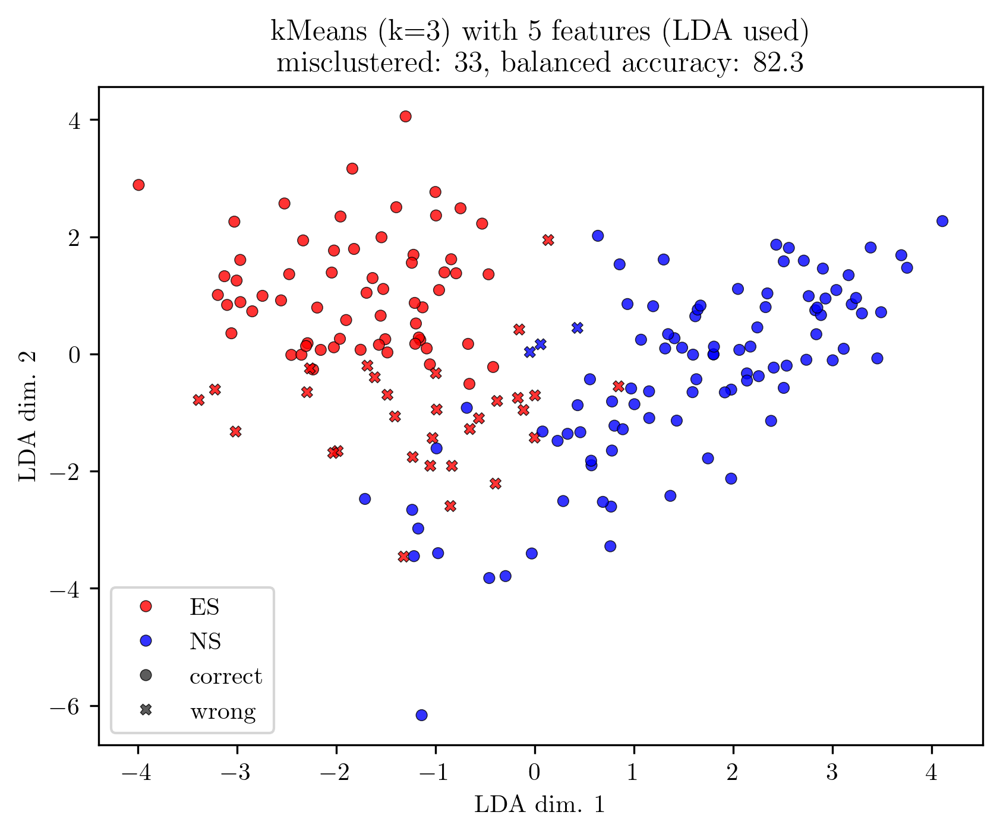

In [163]:
row = clust_results_unsupervised.iloc[0]
n_comp = row['n_comp']
n_clusters = row['n_clusters']

Xplot, labels_maj, lda_used = get_specific_clustering_unsupervised(df_data, row)
acc = metrics.balanced_accuracy_score(labels, labels_maj)

fig, ax = plt.subplots(1,1, dpi=300)
sns.scatterplot(x = Xplot[:, 0], y=Xplot[:, 1],
                hue=np.array(['ES' if x==0 else 'NS' for x in labels]),
                palette={'ES':'red', 'NS':'blue'},
                style=np.array(['correct' if x else 'wrong' for x in (labels == labels_maj)]), 
                style_order=['correct', 'wrong'],
                edgecolor='black',
                alpha=0.8,
                s=20, ax=ax)

leg = ax.legend()
# ax.text(0, 1, 
#         f"{renaming_invariants[row['perstype']]}\n{renaming_invariants[row['invariant']]}",
#         va='bottom',
#         transform=ax.transAxes)
if lda_used:
    ax.set_title(f'kMeans (k={n_clusters}) with {n_comp} features (LDA used)'
                + f'\nmisclustered: {np.count_nonzero(labels != labels_maj)},   balanced accuracy: {100*acc:.1f}%')
    ax.set_xlabel('LDA dim. 1')
    ax.set_ylabel('LDA dim. 2')
else:
    ax.set_title(f'kMeans (k={n_clusters}) with {n_comp} features (only 2 dim. plotted)'
                + f'misclustered: {np.count_nonzero(labels != labels_maj)},   Bal.Acc: {100*acc:.1f}%')
    ax.set_xlabel('most important feature')
    ax.set_ylabel('2nd most important feature')

Bal_acc: 0.8232457598935816


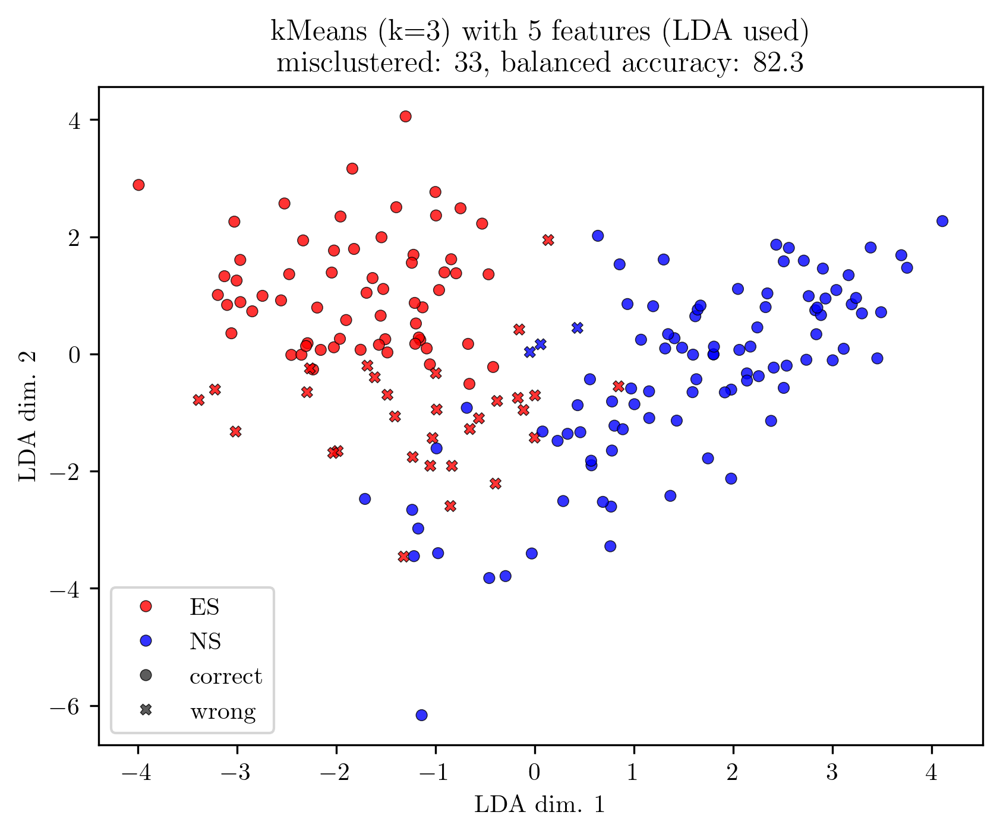

In [ ]:
row = clust_results_unsupervised.iloc[0]
n_comp = row['n_comp']
n_clusters = row['n_clusters']

Xplot, labels_maj, lda_used = get_specific_clustering_unsupervised(df_data, row)
acc = metrics.balanced_accuracy_score(labels, labels_maj)

fig, ax = plt.subplots(1,1, dpi=300)
sns.scatterplot(x = Xplot[:, 0], y=Xplot[:, 1],
                hue=np.array(['ES' if x==0 else 'NS' for x in labels]),
                palette={'ES':'red', 'NS':'blue'},
                style=np.array(['correct' if x else 'wrong' for x in (labels == labels_maj)]), 
                style_order=['correct', 'wrong'],
                edgecolor='black',
                alpha=0.8,
                s=20, ax=ax)

leg = ax.legend()
# ax.text(0, 1, 
#         f"{renaming_invariants[row['perstype']]}\n{renaming_invariants[row['invariant']]}",
#         va='bottom',
#         transform=ax.transAxes)
if lda_used:
    ax.set_title(f'kMeans (k={n_clusters}) with {n_comp} features (LDA used)'
                + f'\nmisclustered: {np.count_nonzero(labels != labels_maj)},   balanced accuracy: {100*acc:.1f}%')
    ax.set_xlabel('LDA dim. 1')
    ax.set_ylabel('LDA dim. 2')
else:
    ax.set_title(f'kMeans (k={n_clusters}) with {n_comp} features (only 2 dim. plotted)'
                + f'misclustered: {np.count_nonzero(labels != labels_maj)},   Bal.Acc: {100*acc:.1f}%')
    ax.set_xlabel('most important feature')
    ax.set_ylabel('2nd most important feature')

In [334]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Select the columns to scale (all columns except 'labels')
columns_to_scale = df_data.columns.difference(['labels'])

# Fit and transform the data
df_data[columns_to_scale] = scaler.fit_transform(df_data[columns_to_scale])

# Print the scaled dataframe
invariant_choice = ['stat', 'ent', 'entnorm', 'bc', 'pi']
for inv in invariant_choice:
    selection = [x for x in df_data.columns if inv in x and 'ls' not in x]
    Xt = df_data[selection]
    y = df_data['labels']

    for n_clusters in [2,3,4,5,6,7,8,9,10]:
        labels_pred = KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xt)
        labels_maj = {x: 0.5-np.abs(np.mean(labels[labels_pred == x]) -0.5) for x in np.unique(labels_pred)}
        print(inv, n_clusters, np.sum(list(labels_maj.values())))


stat 2 0.34536541889483063
stat 3 0.5768148773988692
stat 4 0.6883296979078712
stat 5 0.25203588681849554
stat 6 0.7087782587782587
stat 7 0.6998670919723551
stat 8 0.5307862030442676
stat 9 0.9494220676776457
stat 10 1.1210076473234367
ent 2 0.8851393575803024
ent 3 1.1702808241940845
ent 4 1.278941141674061
ent 5 1.6623927319806575
ent 6 1.1828840393667093
ent 7 1.5750100248061694
ent 8 1.3299631930066713
ent 9 1.8207530773320246
ent 10 1.8538205980066444
entnorm 2 0.8980654761904762
entnorm 3 1.1735780042742068
entnorm 4 1.5148902821316614
entnorm 5 1.1014430014430014
entnorm 6 1.1720641983155886
entnorm 7 1.3026072124756336
entnorm 8 1.4546526562570108
entnorm 9 1.9097388632872505
entnorm 10 2.097279641816809
bc 2 0.897571606475716
bc 3 0.34920165582495566
bc 4 0.47983567013417766
bc 5 0.6930205949656751
bc 6 0.798192517864649
bc 7 1.036254607887694
bc 8 0.7377126099706746
bc 9 1.319916568852739
bc 10 0.7179805646598816
pi 2 0.3701945894636925
pi 3 0.3874843945068664
pi 4 0.7558922

In [ ]:
# from sklearn.preprocessing import MinMaxScaler, StandardScaler

# # Initialize the MinMaxScaler
# scaler = StandardScaler()

# # Select the columns to scale (all columns except 'labels')
# columns_to_scale = df_data.columns.difference(['labels'])

# # Fit and transform the data
# df_data[columns_to_scale] = scaler.fit_transform(df_data[columns_to_scale])

# # Print the scaled dataframe
# invariant_choice = ['stat', 'ent', 'entnorm', 'bc', 'pi']
# for inv in invariant_choice:
#     selection = [x for x in df_data.columns if inv in x and 'ls' not in x]
#     Xt = df_data[selection]
#     y = df_data['labels']

#     for n_clusters in [2,3,4,5,6,7,8,9,10]:
#         labels_pred = KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xt)
#         labels_maj = {x: 0.5-np.abs(np.mean(labels[labels_pred == x]) -0.5) for x in np.unique(labels_pred)}
#         print(inv, n_clusters, np.sum(list(labels_maj.values())))


stat 2 0.8406153846153845
stat 3 1.0337436332767402
stat 4 0.4878312244438005
stat 5 0.4037449017426771
stat 6 0.47803114571746375
stat 7 0.4242424242424242
stat 8 0.3676176660219214
stat 9 0.5091787439613528
stat 10 0.4913888888888889
ent 2 0.9473832698547044
ent 3 1.2644747657405886
ent 4 1.2242879927090455
ent 5 1.265114174324701
ent 6 0.9607447594098846
ent 7 1.4924900437713333
ent 8 1.2222912885662431
ent 9 1.7341944492057157
ent 10 1.7575689887849597
entnorm 2 0.8742028985507246
entnorm 3 1.164329156982698
entnorm 4 0.9024875056792367
entnorm 5 0.8552066654806381
entnorm 6 1.2517146377787527
entnorm 7 1.231998556998557
entnorm 8 1.2781969629957246
entnorm 9 1.615611946532999
entnorm 10 1.6170103045577429
bc 2 0.3026315789473684
bc 3 0.29198635976129583
bc 4 0.6468468468468468
bc 5 0.5703985992378207
bc 6 0.6941421721909525
bc 7 1.0654582188826587
bc 8 0.7867244482333995
bc 9 1.0608437314319668
bc 10 1.652587593751387
pi 2 0.41243961352657005
pi 3 0.4747416762342136
pi 4 0.6571517

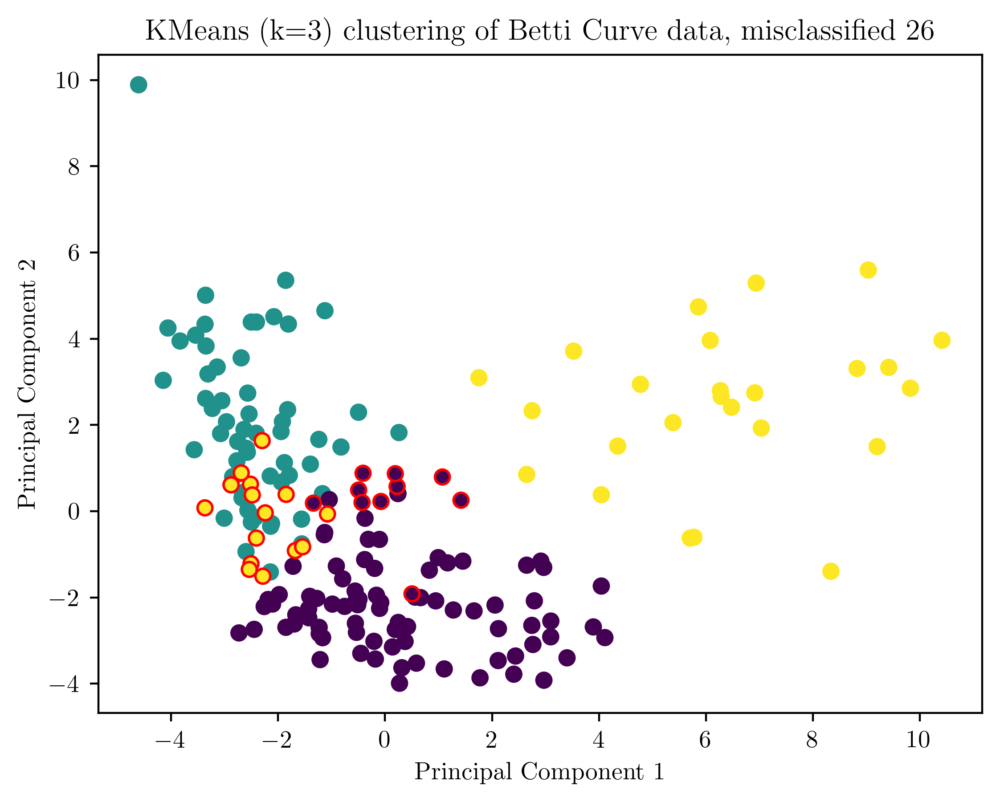

In [336]:
selection = [x for x in df_data.columns if 'bc' in x and 'ls' not in x]
Xt = df_data[selection]
y = df_data['labels']

n_clusters = 3
labels_pred = KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xt)
labels_maj = majority_labels(labels, labels_pred,
                                 function=metrics.accuracy_score)

# Xi = LinearDiscriminantAnalysis(n_components=2).fit_transform(Xt, labels)

pca = PCA(n_components=2)
Xi = pca.fit_transform(Xt)


fig, ax = plt.subplots(1,1,dpi=400)

idx_correct = np.where(labels_maj == labels)[0]
idx_incorrect = np.where(labels_maj != labels)[0]
ax.scatter(Xi[idx_correct, 0], Xi[idx_correct, 1], c=labels_pred[idx_correct], cmap='viridis')
# plt.scatter(Xi[idx_incorrect, 0], Xi[idx_incorrect, 1], color='red', s=30)
# plt.scatter(Xi[idx_incorrect, 0], Xi[idx_incorrect, 1], c=labels_pred[idx_incorrect], s=20)
ax.scatter(Xi[idx_incorrect, 0], Xi[idx_incorrect, 1], c=labels_pred[idx_incorrect], edgecolors= "red")


text = f'KMeans (k={n_clusters}) clustering of Betti Curve data, misclassified {len(idx_incorrect)}'
ax.set_title(text)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')

fig.savefig('newdata_figures/kmeans_bc.png', dpi=400)

Text(0, 0.5, 'Principal Component 2')

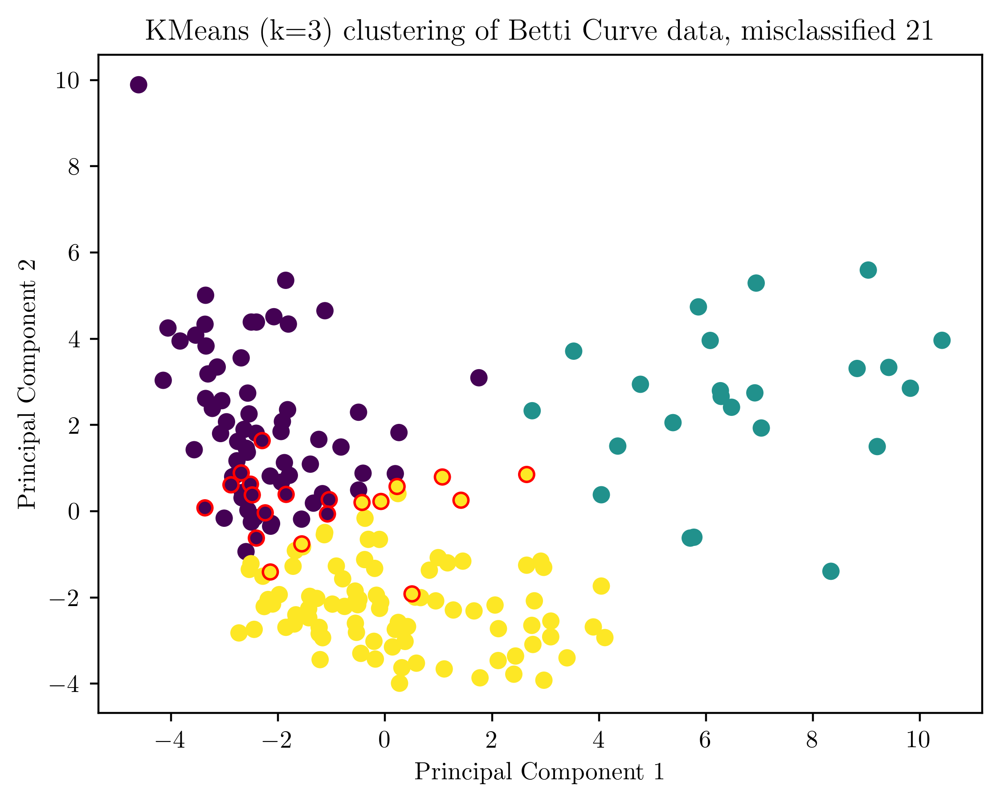

In [468]:
selection = [x for x in df_data.columns if 'bc' in x and 'ls' not in x and 'pers_2d_' in x]
Xt = df_data[selection]
y = df_data['labels']

pca = PCA(n_components=2)
Xi = pca.fit_transform(Xt)

n_clusters = 3
labels_pred = KMeans(n_clusters=n_clusters, n_init='auto').fit_predict(Xi)
labels_maj = majority_labels(labels, labels_pred,
                                 function=metrics.accuracy_score)

fig, ax = plt.subplots(1,1,dpi=400)

idx_correct = np.where(labels_maj == labels)[0]
idx_incorrect = np.where(labels_maj != labels)[0]
ax.scatter(Xi[idx_correct, 0], Xi[idx_correct, 1], c=labels_pred[idx_correct], cmap='viridis')
# plt.scatter(Xi[idx_incorrect, 0], Xi[idx_incorrect, 1], color='red', s=30)
# plt.scatter(Xi[idx_incorrect, 0], Xi[idx_incorrect, 1], c=labels_pred[idx_incorrect], s=20)
ax.scatter(Xi[idx_incorrect, 0], Xi[idx_incorrect, 1], c=labels_pred[idx_incorrect], edgecolors= "red")


text = f'KMeans (k={n_clusters}) clustering of Betti Curve data, misclassified {len(idx_incorrect)}'
ax.set_title(text)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')

<Axes: >

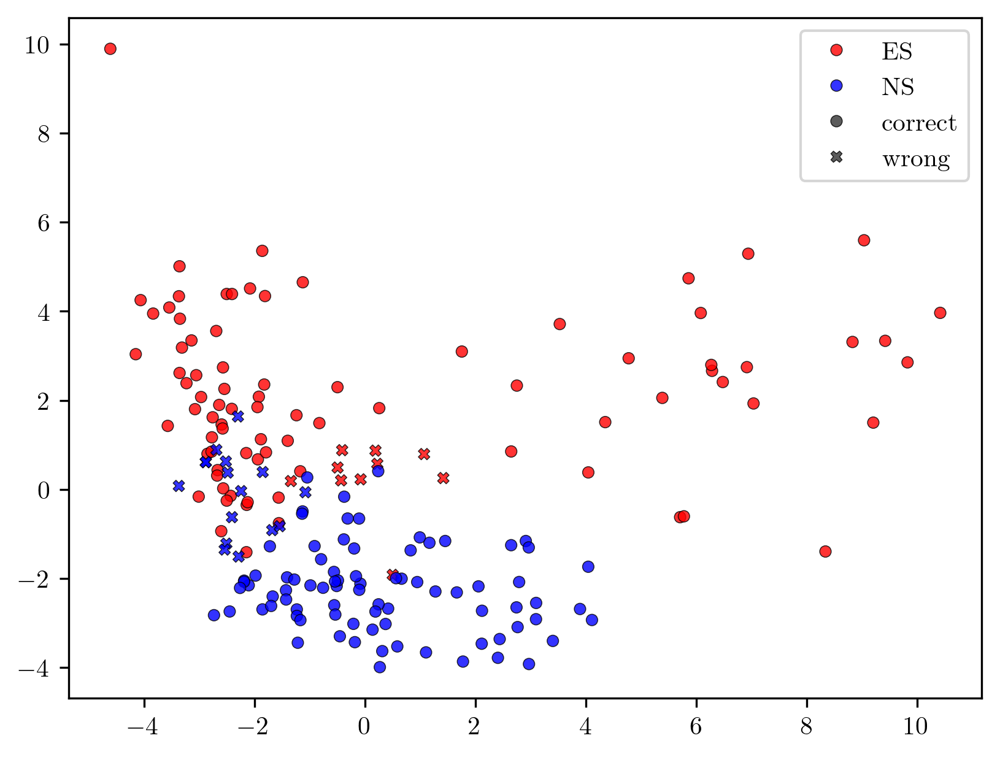

In [ ]:
fig, ax = plt.subplots(1,1, dpi=300)
sns.scatterplot(x = Xi[:, 0], y=Xi[:, 1],
                hue=np.array(['ES' if x==0 else 'NS' for x in labels_pred]),
                palette={'ES':'red', 'NS':'blue'},
                style=np.array(['correct' if x else 'wrong' for x in (le == labels_maj)]), 
                style_order=['correct', 'wrong'],
                edgecolor='black',
                alpha=0.8,
                s=20, ax=ax)

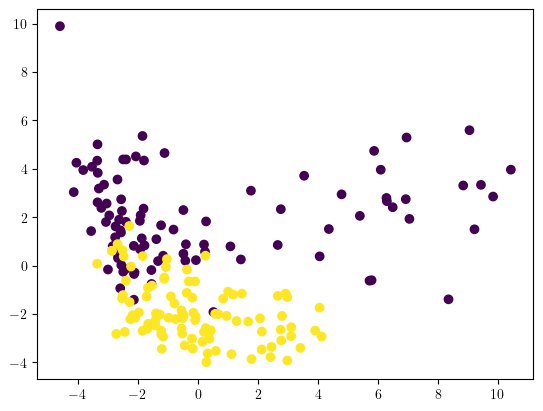

In [424]:
selection = [x for x in df_data.columns if 'bc' in x and 'labels' not in x]
Xt = df_data[selection]
y = df_data['labels']
Xi = PCA(n_components=2).fit_transform(Xt)

plt.scatter(Xi[:, 0], Xi[:, 1], c=labels, cmap='viridis')

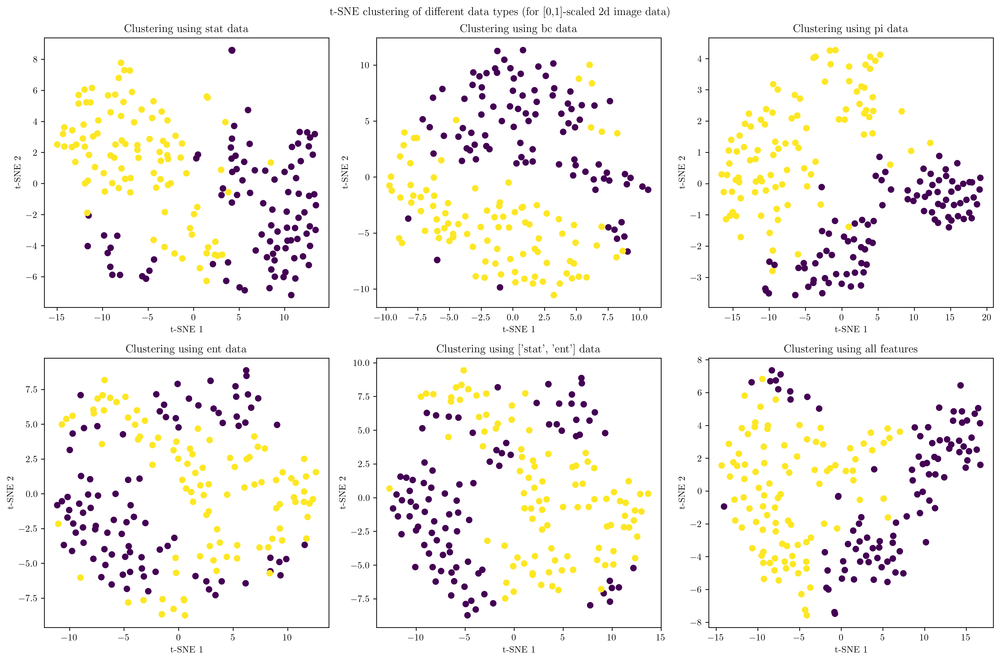

In [490]:
from openTSNE import TSNE
cluster_invs = ['stat', 'bc', 'pi', 'ent', ['stat', 'ent'], '']

fig, ax = plt.subplots(2, 3, figsize=(15, 10), dpi=300)
for i, cond in enumerate(cluster_invs):
    if isinstance(cond, list):
        selection = [x for x in df_data.columns if 'labels' not in x and ('pers_2d_minmax' in x) and (cond[0] in x or cond[1] in x)]
    else:
        selection = [x for x in df_data.columns if 'labels' not in x and ('pers_2d_minmax' in x) and cond in x]
    Xt = df_data[selection]
    y = df_data['labels']
    embedding = TSNE().fit(Xt)

    if cond == 'pi':
        embediing_save = embedding.copy()

    axi = np.unravel_index(i, (2,3))
    ax[axi].scatter(embedding[:, 0], embedding[:, 1], c=y, cmap='viridis')
    if cond == '':
        ax[axi].set_title('Clustering using all features')
    else:
        ax[axi].set_title(f'Clustering using {cond} data')
    ax[axi].set_xlabel('t-SNE 1')
    ax[axi].set_ylabel('t-SNE 2')
fig.suptitle('t-SNE clustering of different data types (for [0,1]-scaled 2d image data)', y=0.98)
fig.tight_layout()

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Initialize the MinMaxScaler
# scaler = MinMaxScaler()
scaler = StandardScaler()

# Fit and transform the data (excluding 'labels')
df_data_scaled = pd.DataFrame(scaler.fit_transform(df_data), columns=df_data.columns)

# Add the 'labels' column back to the scaled dataframe
df_data_scaled['labels'] = labels

Text(0.5, 1.0, 't-SNE embedding using persistence image data')

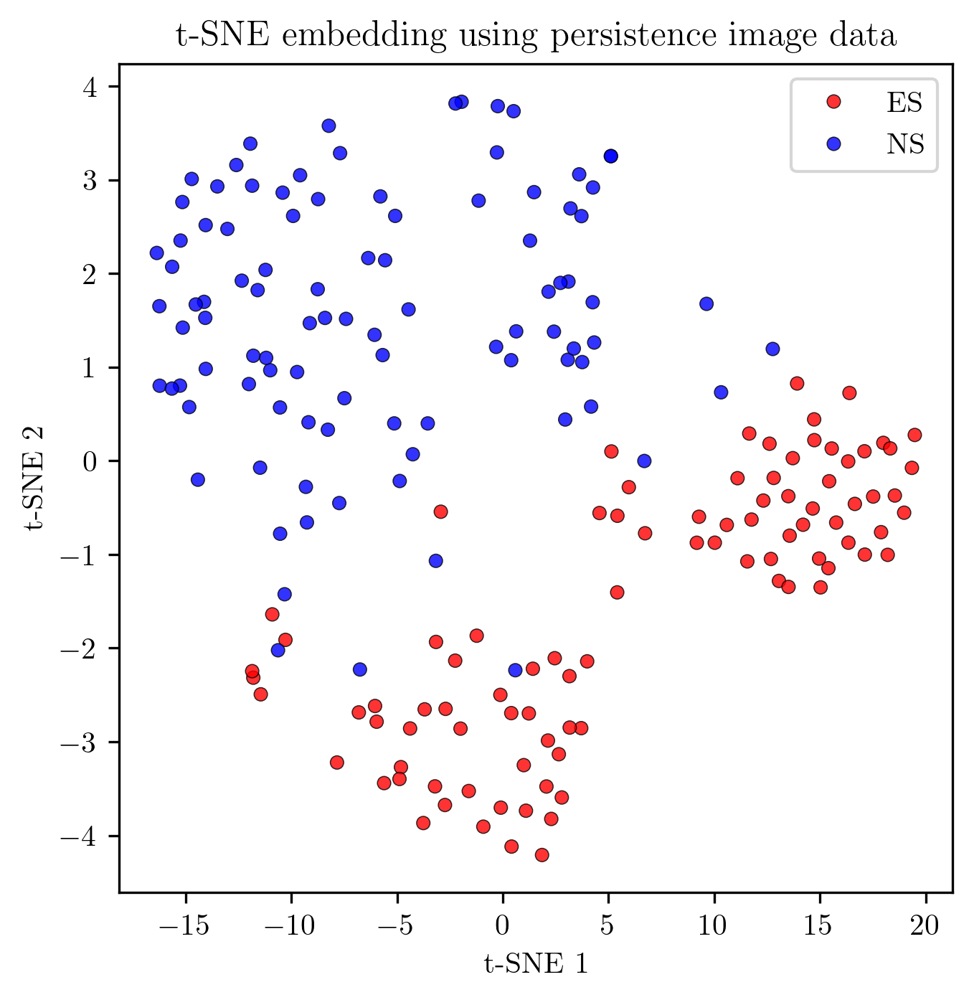

In [ ]:
from openTSNE import TSNE

fig, ax = plt.subplots(1,1, figsize=(5, 5), dpi=300)
selection = [x for x in df_data_scaled.columns if 'labels' not in x and ('pers_2d_minmax' in x) and 'pi' in x]
Xt = df_data_scaled[selection]
y = df_data_scaled['labels']
embedding = TSNE().fit(Xt)
sns.scatterplot(x=embedding[:, 0], y=embedding[:, 1],
                hue=np.array(['ES' if x==0 else 'NS' for x in y]),
                palette={'ES':'red', 'NS':'blue'},
                edgecolor='black',
                alpha=0.8,
                s=20, ax=ax)

ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')
ax.set_title('t-SNE embedding using persistence image data')
# fig.savefig('newdata_figures/tsne_emebdding_pi_2dminmax_nopca.png', dpi=400, bbox_inches='tight')
# np.save('newdata_figures/tsne_embedding_pi_2dminmax_nopca.npy', embedding)

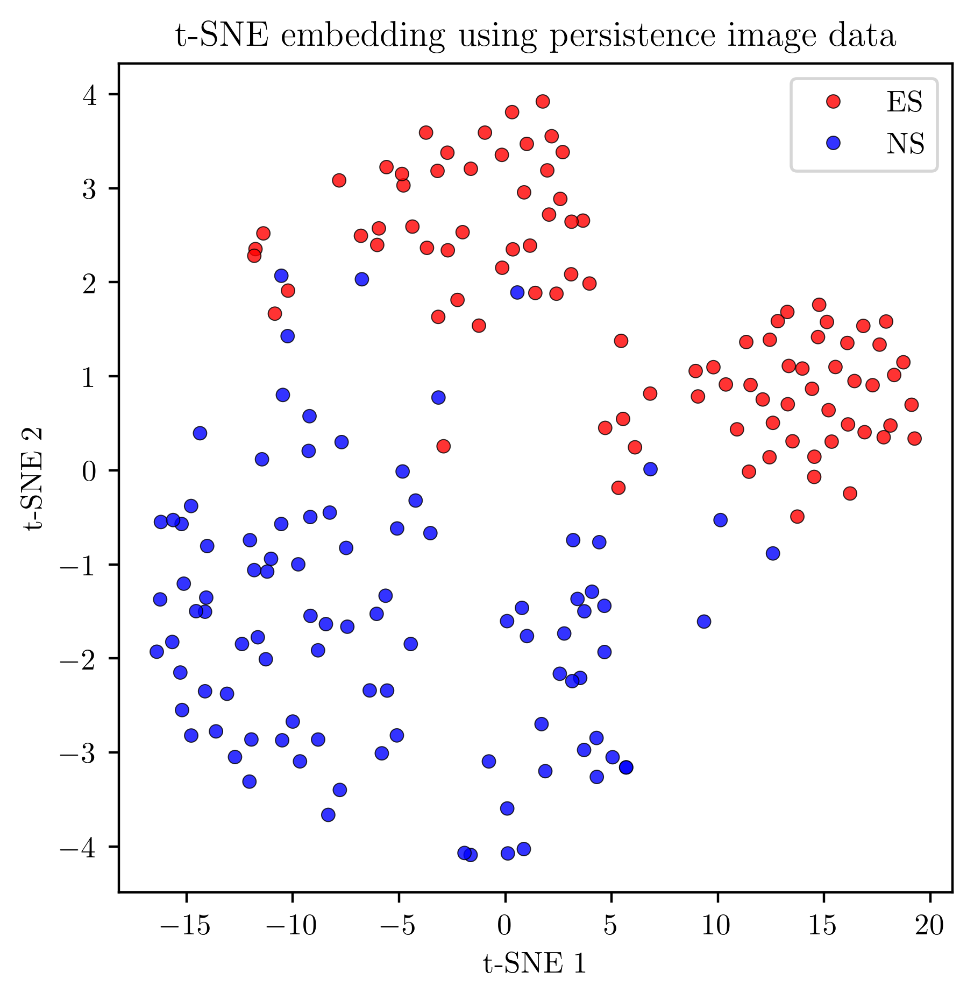

In [ ]:
from openTSNE import TSNE

fig, ax = plt.subplots(1,1, figsize=(5, 5), dpi=400)
selection = [x for x in df_data_scaled.columns if 'labels' not in x and ('pers_2d_minmax' in x) and 'pi' in x]
Xt = df_data_scaled[selection]
y = df_data_scaled['labels']

Xt = PCA(n_components=50).fit_transform(Xt)
embedding = TSNE().fit(Xt)
sns.scatterplot(x=embedding[:, 0], y=embedding[:, 1],
                hue=np.array(['ES' if x==0 else 'NS' for x in y]),
                palette={'ES':'red', 'NS':'blue'},
                edgecolor='black',
                alpha=0.8,
                s=20, ax=ax)

ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')
ax.set_title('t-SNE embedding using persistence image data')
# fig.savefig('newdata_figures/sted_tsne_emebdding_pi_2dminmax.png', dpi=400, bbox_inches='tight')
# np.save('newdata_figures/sted_tsne_embedding_pi_2dminmax.npy', embedding)

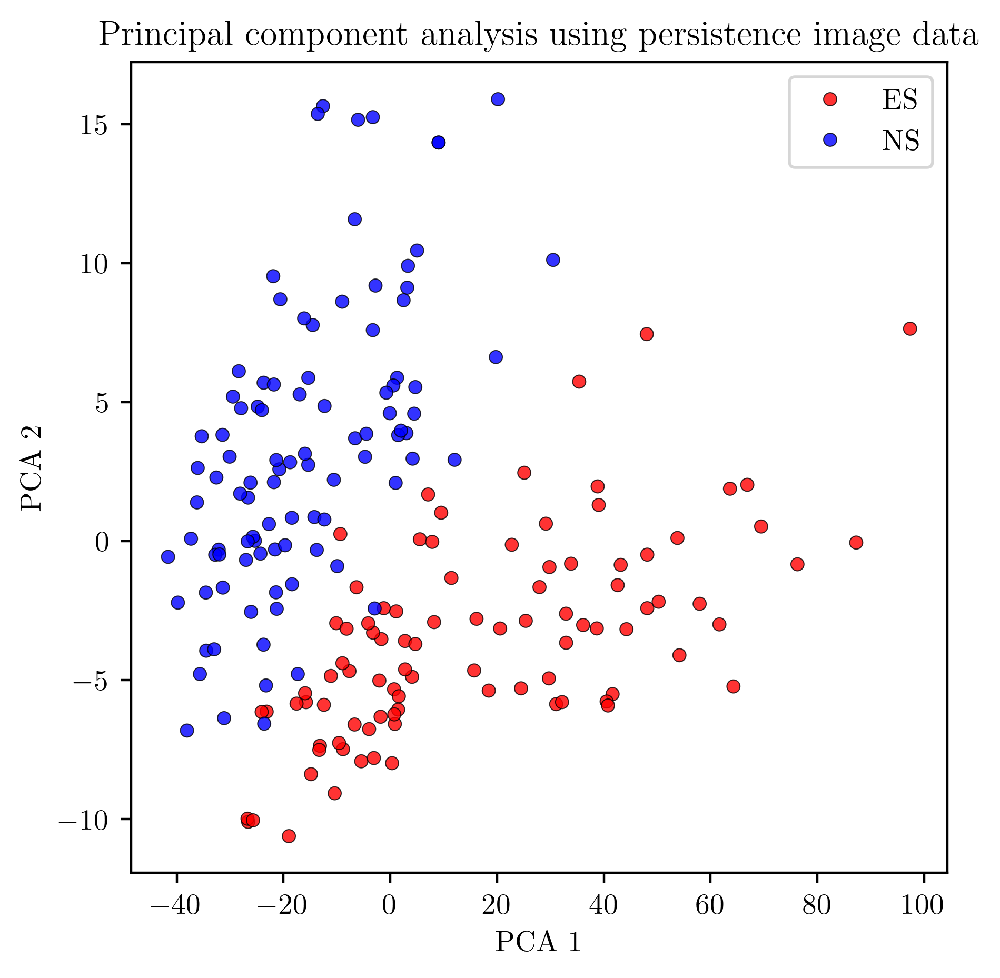

In [ ]:
from openTSNE import TSNE

fig, ax = plt.subplots(1,1, figsize=(5, 5), dpi=400)
selection = [x for x in df_data_scaled.columns if 'labels' not in x and ('pers_2d_minmax' in x) and 'pi' in x]
Xt = df_data_scaled[selection]
y = df_data_scaled['labels']

embedding = PCA(n_components=2).fit_transform(Xt)
sns.scatterplot(x=embedding[:, 0], y=embedding[:, 1],
                hue=np.array(['ES' if x==0 else 'NS' for x in y]),
                palette={'ES':'red', 'NS':'blue'},
                edgecolor='black',
                alpha=0.8,
                s=20, ax=ax)

ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_title('Principal component analysis using persistence image data')
# fig.savefig('newdata_figures/sted_pca_pi_2dminmax.png', dpi=400, bbox_inches='tight')
# np.save('newdata_figures/sted_pca_embedding_pi_2dminmax.npy', embedding)

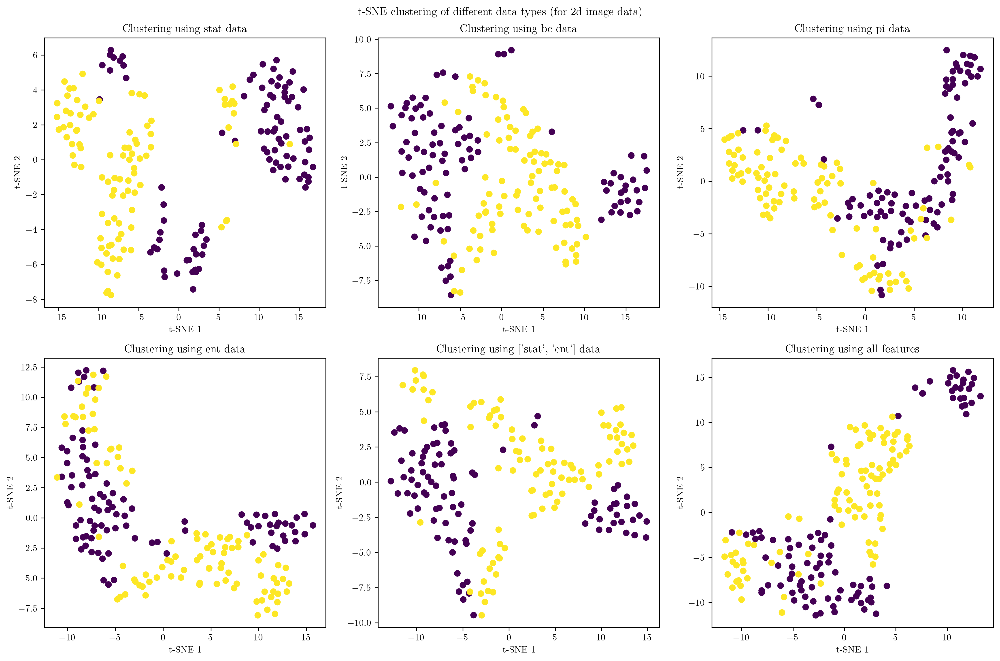

In [478]:
from openTSNE import TSNE
cluster_invs = ['stat', 'bc', 'pi', 'ent', ['stat', 'ent'], '']

fig, ax = plt.subplots(2, 3, figsize=(15, 10), dpi=300)
for i, cond in enumerate(cluster_invs):
    if isinstance(cond, list):
        selection = [x for x in df_data.columns if 'labels' not in x and ('pers_2d_' in x) and (cond[0] in x or cond[1] in x)]
    else:
        selection = [x for x in df_data.columns if 'labels' not in x and ('pers_2d_' in x) and cond in x]
    Xt = df_data[selection]
    y = df_data['labels']
    embedding = TSNE().fit(Xt)

    axi = np.unravel_index(i, (2,3))
    ax[axi].scatter(embedding[:, 0], embedding[:, 1], c=labels, cmap='viridis')
    if cond == '':
        ax[axi].set_title('Clustering using all features')
    else:
        ax[axi].set_title(f'Clustering using {cond} data')
    ax[axi].set_xlabel('t-SNE 1')
    ax[axi].set_ylabel('t-SNE 2')
fig.suptitle('t-SNE clustering of different data types (for 2d image data)', y=0.98)
fig.tight_layout()

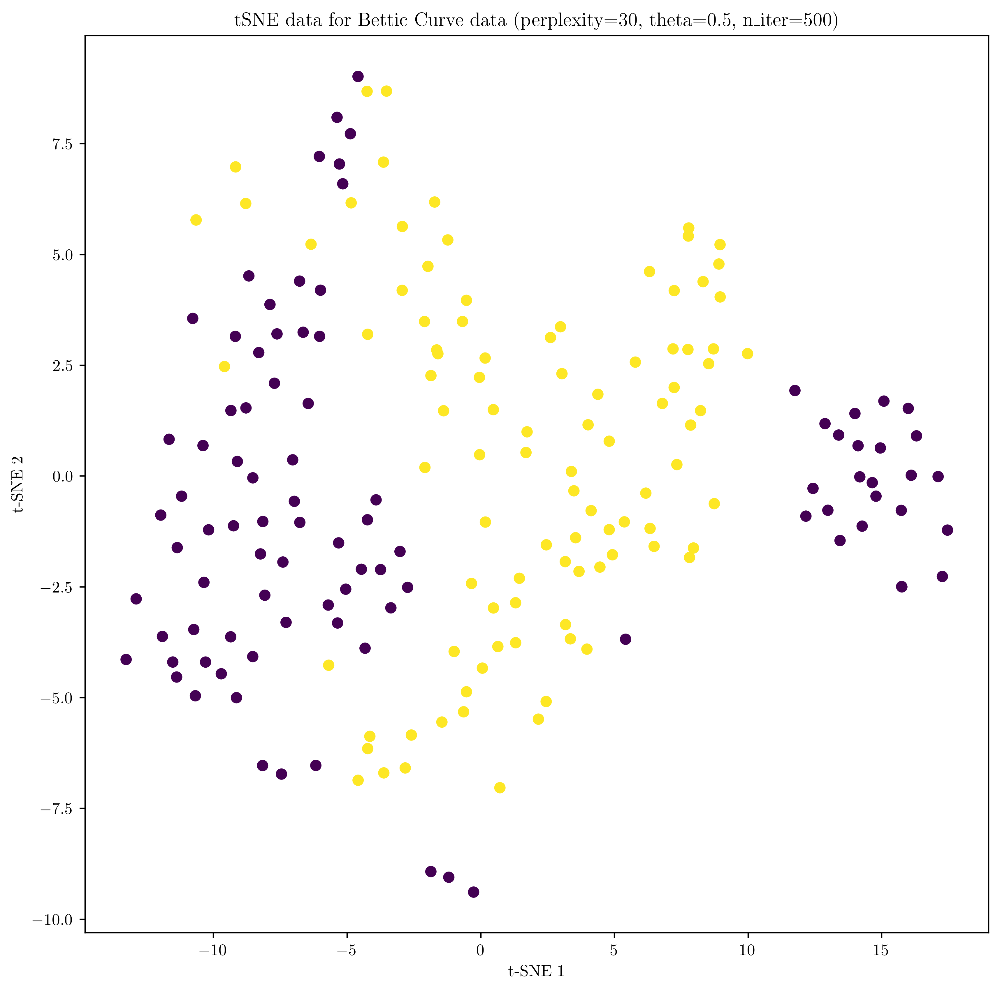

In [451]:
from openTSNE import TSNE
cluster_invs = ['stat', 'bc', 'pi', 'ent', ['stat', 'ent'], '']

fig, ax = plt.subplots(1, 1, figsize=(10, 10), dpi=400)
selection = [x for x in df_data.columns if 'labels' not in x and 'bc' in x]

Xt = df_data[selection]
y = df_data['labels']
tsne = TSNE()
embedding = tsne.fit(Xt)
params = [tsne.get_params()[x] for x in ['perplexity', 'theta', 'n_iter']]

ax.scatter(embedding[:, 0], embedding[:, 1], c=labels, cmap='viridis')
ax.set_title(f'tSNE data for Bettic Curve data (perplexity={params[0]}, theta={params[1]}, n_iter={params[2]})')
ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')
fig.savefig('newdata_figures/tsne_bc.png', dpi=400)

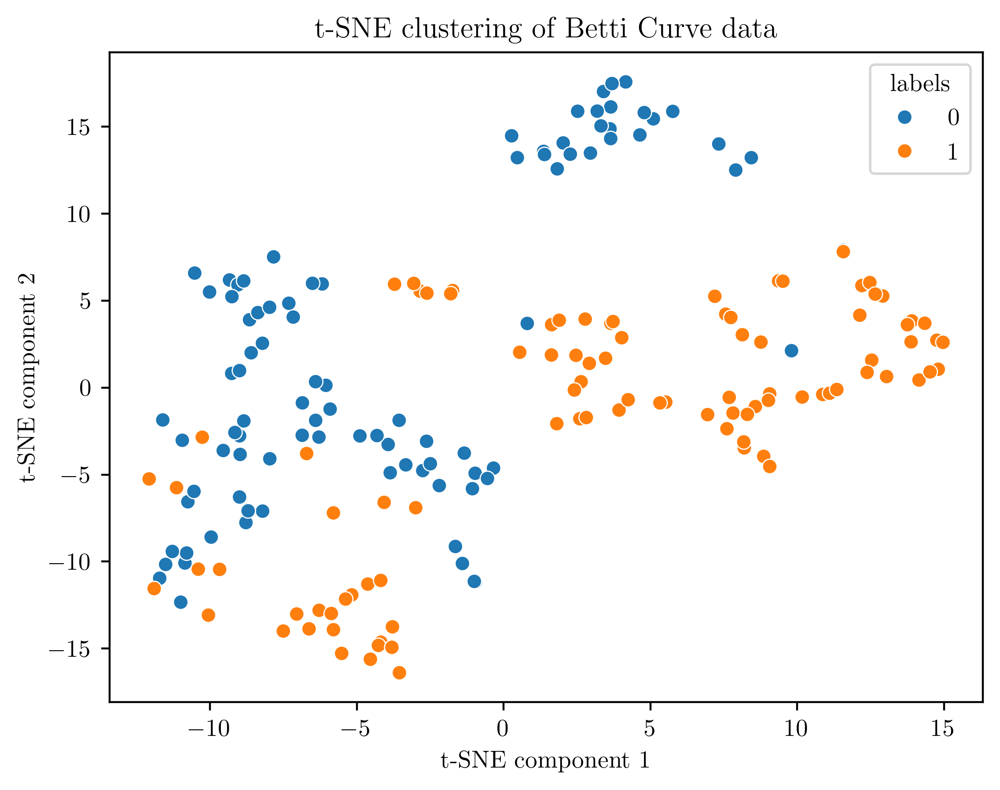

In [421]:
selection = [x for x in df_data.columns if 'labels' not in x]
Xt = df_data[selection]
y = df_data['labels']

from sklearn.manifold import TSNE

# Perform t-SNE
tsne = TSNE(n_components=2, random_state=42, max_iter=300, perplexity=11)
Xi = PCA(n_components=50).fit_transform(Xt)
Xt_tsne = tsne.fit_transform(Xi)

# Plot the t-SNE results
fig, ax = plt.subplots(1, 1, dpi=400)
sns.scatterplot(x=Xt_tsne[:, 0], y=Xt_tsne[:, 1], hue=y, ax=ax)
ax.set_title('t-SNE clustering of Betti Curve data')
ax.set_xlabel('t-SNE component 1')
ax.set_ylabel('t-SNE component 2')
plt.show()

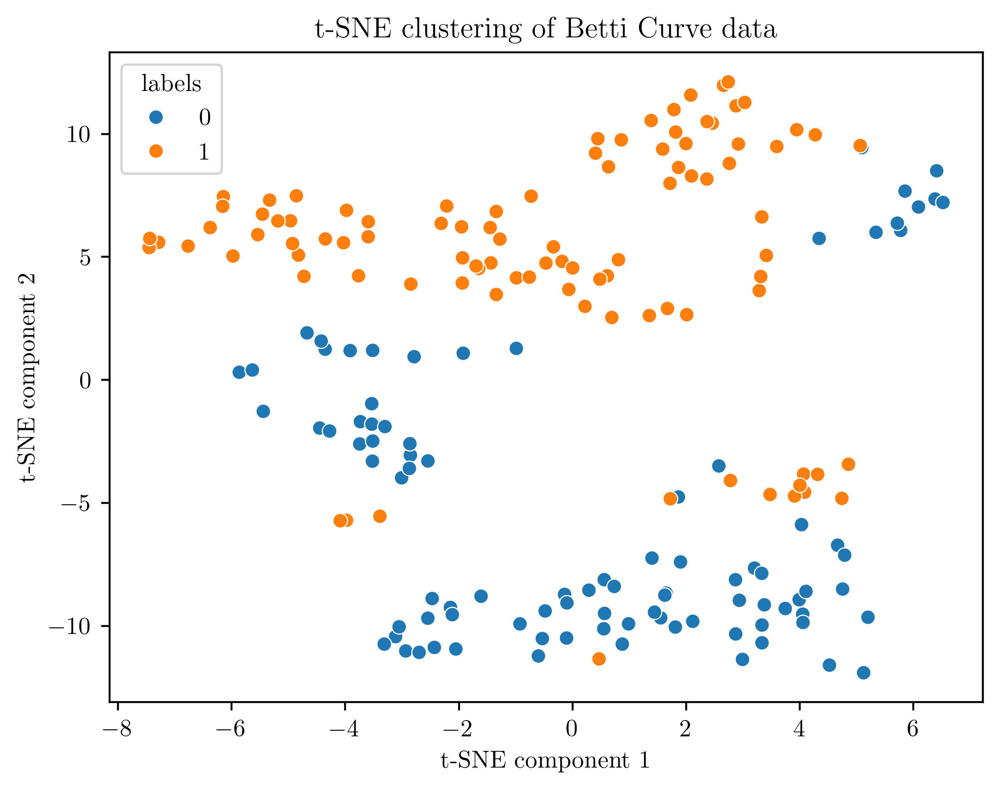

In [401]:
selection = [x for x in df_data.columns if 'stat' in x and 'ls' not in x]
Xt = df_data[selection]
y = df_data['labels']

from sklearn.manifold import TSNE

# Perform t-SNE
tsne = TSNE(n_components=2, random_state=42, max_iter=300)
Xt_tsne = tsne.fit_transform(Xt)

# Plot the t-SNE results
fig, ax = plt.subplots(1, 1, dpi=400)
sns.scatterplot(x=Xt_tsne[:, 0], y=Xt_tsne[:, 1], hue=y, ax=ax)
ax.set_title('t-SNE clustering of Betti Curve data')
ax.set_xlabel('t-SNE component 1')
ax.set_ylabel('t-SNE component 2')
plt.show()

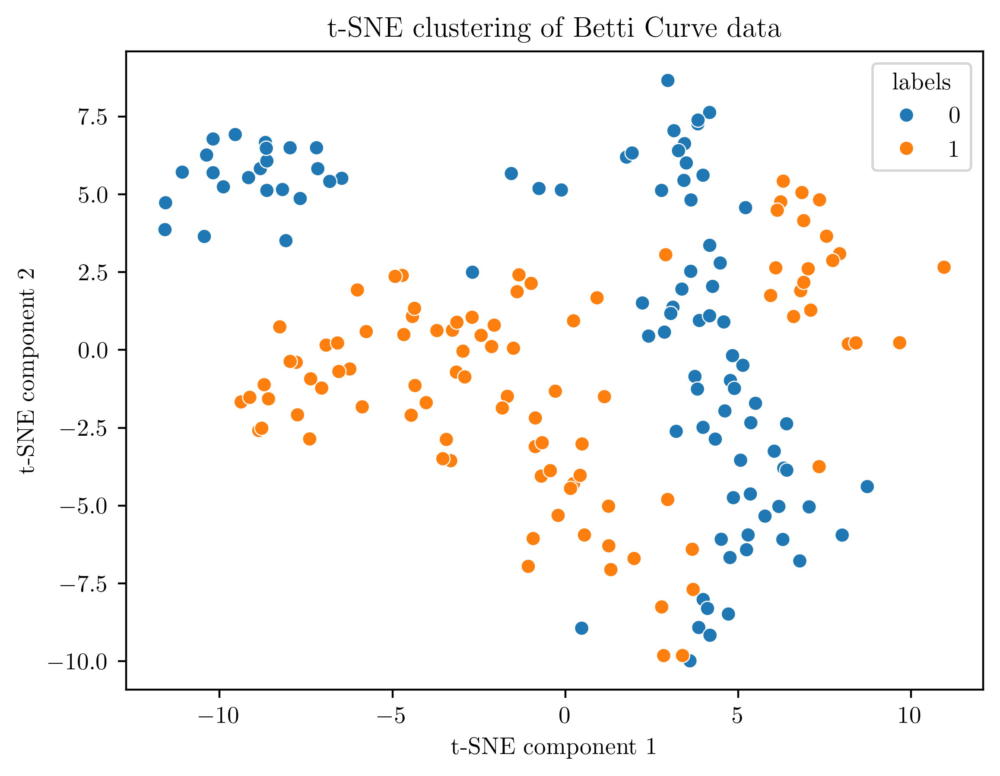

In [400]:
selection = [x for x in df_data.columns if 'bc' in x and 'ls' not in x]
Xt = df_data[selection]
y = df_data['labels']

from sklearn.manifold import TSNE

# Perform t-SNE
tsne = TSNE(n_components=2, random_state=42, max_iter=300)
Xt_tsne = tsne.fit_transform(Xt)

# Plot the t-SNE results
fig, ax = plt.subplots(1, 1, dpi=400)
sns.scatterplot(x=Xt_tsne[:, 0], y=Xt_tsne[:, 1], hue=y, ax=ax)
ax.set_title('t-SNE clustering of Betti Curve data')
ax.set_xlabel('t-SNE component 1')
ax.set_ylabel('t-SNE component 2')
plt.show()

# statistical tet on ecc

In [173]:
inv_bc = BettiCurve(resolution=250)
ecc = inv_bc.fit_transform(diag0_seg_scaled + diag1_seg_scaled)
ecc = ecc[:len(diag0_seg_scaled)] - ecc[len(diag0_seg_scaled):]
ecc_grid = inv_bc.grid_

inv_bc = BettiCurve(resolution=250)
ecc_org = inv_bc.fit_transform(diag0_seg + diag1_seg)
ecc_org = ecc_org[:len(diag0_seg)] - ecc_org[len(diag0_seg):]
ecc_org_grid = inv_bc.grid_

In [321]:
inv_bc = BettiCurve(resolution=250)
bc_org = inv_bc.fit_transform(diag0_seg + diag1_seg)
bc_0 = bc_org[:len(diag0_seg)]
bc_1 = bc_org[len(diag0_seg):]
bc_grid = inv_bc.grid_

<Axes: xlabel='x', ylabel='y'>

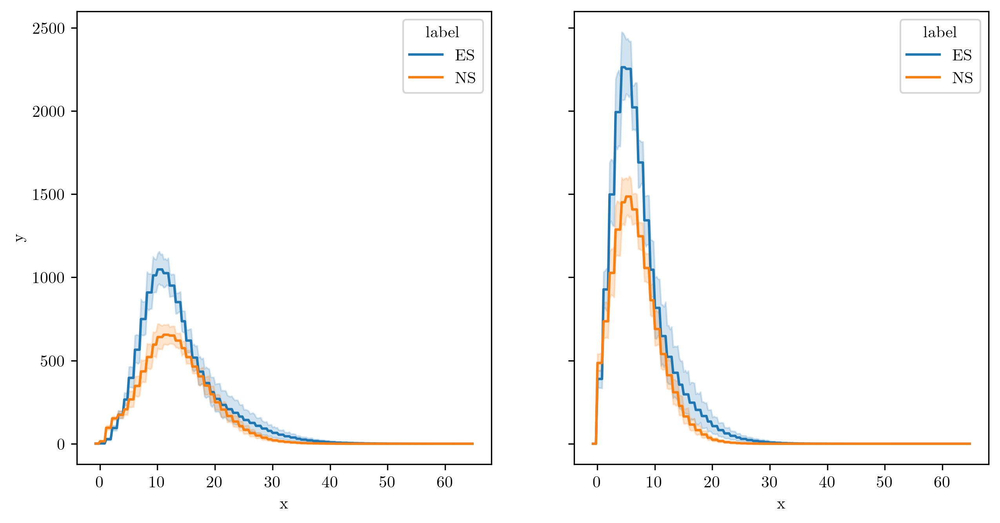

In [ ]:
fig, ax = plt.subplots(1,2, dpi=300, figsize=(10,5), sharey=True)

df_plot = pd.DataFrame(bc_0)
df_plot.columns = -bc_grid
df_plot.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
# df_plot.loc[:, 'label'] = le
df_plot.loc[:, 'sample'] = np.arange(len(df_plot))

df_plot = df_plot.melt(id_vars=['sample', 'label'], var_name='x', value_name='y')
df_plot['x'] = pd.to_numeric(df_plot['x'], errors='coerce')
df_plot['y'] = pd.to_numeric(df_plot['y'], errors='coerce')
# df_plot['label'] = df_plot['label'].astype('category')


sns.lineplot(data=df_plot, x='x', y='y', hue='label', errorbar=('ci', 99), ax=ax[0])
# ax.set_title('Euler Characteristic Curves')
# ax.set_xlabel('Threshold values')
# ax.set_ylabel('Count')

df_plot = pd.DataFrame(bc_1)
df_plot.columns = -bc_grid
df_plot.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
# df_plot.loc[:, 'label'] = le
df_plot.loc[:, 'sample'] = np.arange(len(df_plot))
df_plot = df_plot.melt(id_vars=['sample', 'label'], var_name='x', value_name='y')
df_plot['x'] = pd.to_numeric(df_plot['x'], errors='coerce')
df_plot['y'] = pd.to_numeric(df_plot['y'], errors='coerce')

sns.lineplot(data=df_plot, x='x', y='y', hue='label', errorbar=('ci', 99), ax=ax[1])

# fig.savefig('newdata_figures/euler_characteristic_curves_maskedimage.png', dpi=400, bbox_inches='tight')

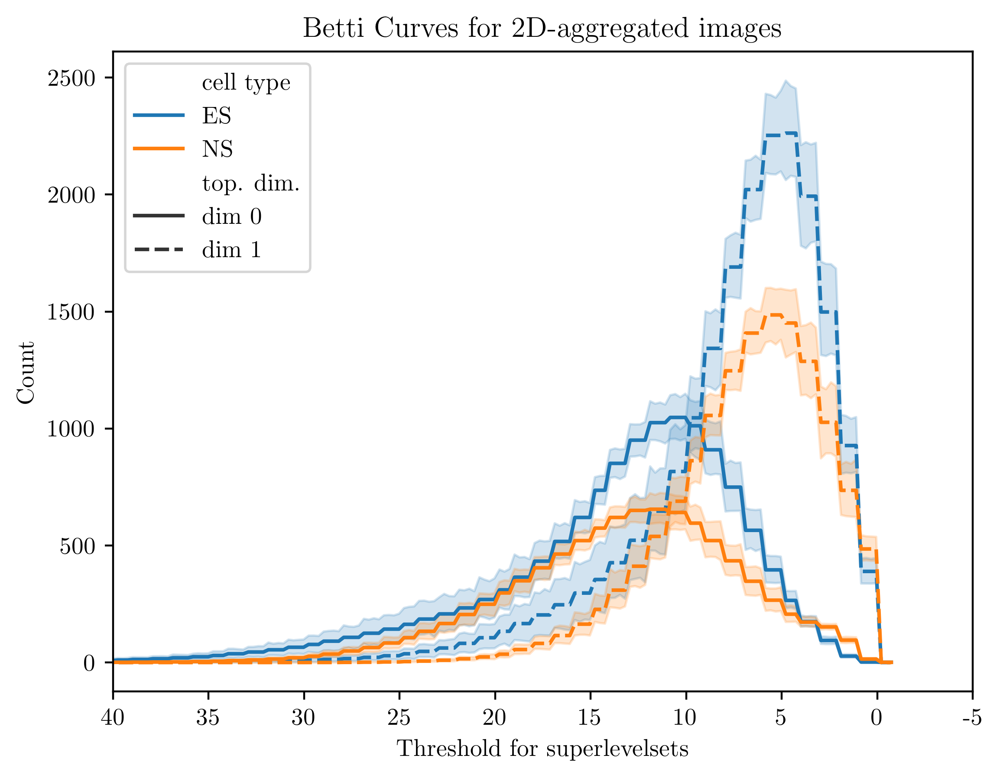

In [370]:

fig, ax = plt.subplots(1,1,dpi=400)

df_plot = pd.DataFrame(bc_0)
df_plot.columns = bc_grid
df_plot.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
df_plot.loc[:, 'sample'] = np.arange(len(df_plot))
df_plot.loc[:, 'style'] = 'dim 0'
df_plot = df_plot.melt(id_vars=['sample', 'label', 'style'], var_name='x', value_name='y')
df_plot['x'] = pd.to_numeric(df_plot['x'], errors='coerce')
df_plot['y'] = pd.to_numeric(df_plot['y'], errors='coerce')

df_plot2 = pd.DataFrame(bc_1)
df_plot2.columns = bc_grid
df_plot2.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
df_plot2.loc[:, 'style'] = 'dim 1'
df_plot2.loc[:, 'sample'] = np.arange(len(df_plot2))
df_plot2 = df_plot2.melt(id_vars=['sample', 'label', 'style'], var_name='x', value_name='y')
df_plot2['x'] = pd.to_numeric(df_plot2['x'], errors='coerce')
df_plot2['y'] = pd.to_numeric(df_plot2['y'], errors='coerce')

df_plot.dropna(axis=0, inplace=True)
df_plot2.dropna(axis=0, inplace=True)

df_plot = pd.concat([df_plot, df_plot2], ignore_index=True)
df_plot.rename(columns={'label': 'cell type', 'style': 'top. dim.'}, inplace=True)

sns.lineplot(data=df_plot, x='x', y='y', hue='cell type', style='top. dim.', errorbar=('ci', 99), ax=ax)
ax.set_xlabel('Threshold for superlevelsets')
ax.set_ylabel('Count')
ax.set_title('Betti Curves for 2D-aggregated images')

ax.set_xlim([-40, 3])

# Get current xticks
xticks = ax.get_xticks()

# Set new xticks with negative values
ax.set_xticks(xticks)
ax.set_xticklabels([-int(xtick) for xtick in xticks])

fig.savefig('newdata_figures/betti_curves_maskedimage.png', dpi=400, bbox_inches='tight')

In [174]:
ecc_normalize = np.copy(ecc).astype(np.float64)
assert len(images) == np.shape(ecc)[0]
for i in range(len(images)):
    ecc_normalize[i, :] = ecc[i, :] / np.nansum(images[i] != -1)

ecc_org_normalize = np.copy(ecc_org).astype(np.float64)
assert len(images) == np.shape(ecc_org)[0]
for i in range(len(images)):
    ecc_org_normalize[i, :] = ecc_org[i, :] / np.nansum(images[i] != -1)

In [ ]:
# idx_es = np.where(le == 0)[0]

# import itertools
# products = list(itertools.product(idx_es, idx_es))

# pvalues = []
# for product in tqdm(products):
#     if product[0] == product[1]:
#         continue
#     _, pvalue = TopoTestTwosample(X1=ecc[product[0]], X2=ecc[product[1]], loops=1)
#     pvalues.append(pvalue)

# alpha = 0.01
# power_tt = np.mean([pvalue < alpha for pvalue in pvalues])
# print(f"Power of the TopoTest (internal es): {power_tt}")

In [218]:
def dist_ecc(ecc1, ecc2, x, norm='sup'):
    """
    Compute the distance between two ECCs assuming the jumping points are in the same locations

    :param ecc1: first ecc
    :param ecc2: second ecc
    :return: distance, controlled by norm parameter of the TopoTestTwosample function
    """
    # ecc1 and ecc2 are of equal length and have jumps in the same location
    if norm == "sup":
        return np.max(np.abs(ecc1 - ecc2))
    if norm == "l1":
        return np.trapz(np.abs(ecc1 - ecc2), x=x)
    if norm == "l2":
        return np.trapz((ecc1 - ecc2) ** 2, x=x)


def permutation_test(curves, labels, x=None, metric='sup', n_permutations=1000, random_state=None):
    """
    Perform a permutation test to compare two sets of curves.

    Parameters:
    - curves: 2D numpy array of shape (n_samples, n_features), each row is a curve.
    - labels: 1D numpy array of shape (n_samples,), class labels (0 or 1).
    - metric: Metric to use for comparison, options are 'mse' (mean squared error) or 'l2' (L2 norm).
    - n_permutations: Number of permutations to perform.
    - random_state: Random seed for reproducibility.

    Returns:
    - p_value: The p-value of the test.
    - observed_stat: The observed statistic between the two groups.
    - permuted_stats: List of permuted statistics.
    """
    if random_state:
        np.random.seed(random_state)
    
    # Split the curves by class
    group_0 = curves[labels == 0]
    group_1 = curves[labels == 1]

    # Compute the observed statistic
    observed_stat = dist_ecc(group_0.mean(axis=0), group_1.mean(axis=0), x=x, norm=metric)

    # Combine all data
    combined_curves = np.vstack([group_0, group_1])
    combined_labels = np.concatenate([np.zeros(len(group_0)), np.ones(len(group_1))])

    # Perform permutations
    permuted_stats = []
    for _ in range(n_permutations):
        # Shuffle labels
        permuted_labels = np.random.permutation(combined_labels)
        
        # Split groups based on permuted labels
        perm_group_0 = combined_curves[permuted_labels == 0]
        perm_group_1 = combined_curves[permuted_labels == 1]
        
        # Compute the statistic for permuted groups
        stat = dist_ecc(perm_group_0.mean(axis=0), perm_group_1.mean(axis=0), x=x, norm=metric)
        permuted_stats.append(stat)

    # Compute the p-value
    permuted_stats = np.array(permuted_stats)
    p_value = np.mean(permuted_stats >= observed_stat)

    return p_value, observed_stat, permuted_stats

In [219]:
distance_eccs = np.zeros([3, len(ecc), len(ecc)])
for k, disttype in tqdm(enumerate(['sup', 'l1', 'l2'])):
    for i in range(len(ecc)):
        for j in range(i+1, len(ecc)):
            distance_eccs[k, i,j] = dist_ecc(ecc_normalize[i], ecc_normalize[j], ecc_grid, norm=disttype)
            distance_eccs[k, j,i] = distance_eccs[k, i,j]

0it [00:00, ?it/s]

3it [00:00,  8.26it/s]


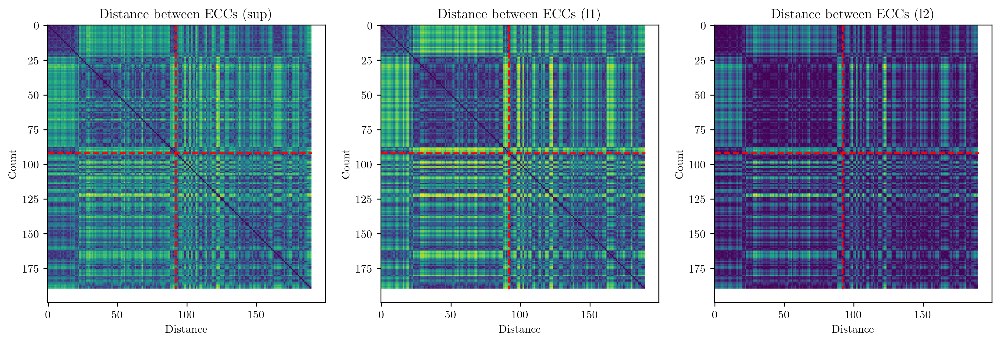

In [222]:
fig, ax = plt.subplots(1,3, dpi=300, figsize=(15,5))
for k, disttype in enumerate(['sup', 'l1', 'l2']):
    ax[k].imshow(distance_eccs[k], cmap='viridis')
    ax[k].set_title(f'Distance between ECCs ({disttype})')
    ax[k].hlines(np.where(le == 0)[0][-1], 0, len(ecc), colors='red', linestyles='dashed')
    ax[k].vlines(np.where(le == 0)[0][-1], 0, len(ecc), colors='red', linestyles='dashed')
    ax[k].set_xlabel('Distance')
    ax[k].set_ylabel('Count')

In [239]:
sorted_indices = np.hstack([np.where(le == 0)[0][np.argsort(intradistances[le == 0])], np.where(le == 1)[0][np.argsort(intradistances[le == 1])]])
sorted_indices

array([ 79,  77,  80,  69,  60,  21,  39,  24,  62,  75,  27,  43,  37,
        56,  65,  45,  64,  38,  36,  33,  85,  59,  49,  71,  20,  35,
        76,  31,  46,  25,  26,  78,  51,  70,  87,  54,  73,  50,  47,
        72,  86,  41,  81,  23,  66,  40,  48,  34,  44,  61,  42,  84,
         9,  83,  82,  74,  14,  57,  53,  32,  17,  15,  63,  52,   3,
        13,  67,   7,  28,  22,  30,   8,   2,   4,  29,   0,  58,   1,
        92,  10,  55,  12,   6,  18,   5,  88,  91,  11,  19,  68,  16,
        90,  89, 150, 158, 112, 183, 136, 116, 140, 178, 171, 162, 153,
       142, 157, 181, 135, 154, 111, 152, 147, 169, 176, 184, 139, 145,
        93, 127, 143, 108, 155, 179, 149, 172, 141, 146, 115, 168, 130,
       177, 133, 117, 104, 144,  94, 128, 159, 105, 109, 182, 129, 100,
       156, 151, 173, 164, 120, 160, 106, 188, 131, 185, 170, 175, 186,
        97, 124, 132, 167, 125, 134,  95, 148, 161, 174, 137, 121, 138,
       113, 126, 187, 101, 103, 165, 189,  98, 166, 163, 118, 11

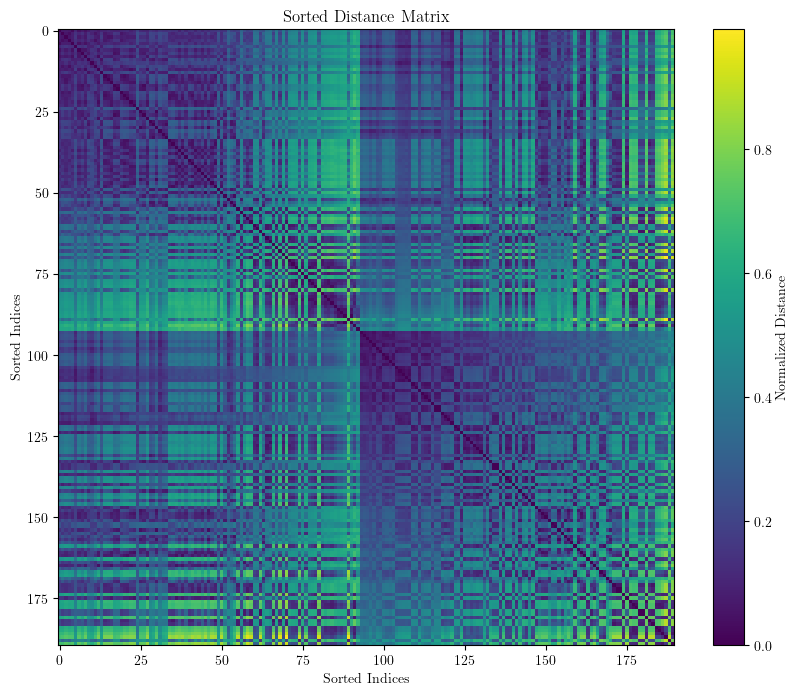

In [240]:
meandist = np.mean(distance_eccs / np.max(distance_eccs, axis=(1,2)).reshape(3,1,1), axis=0)

# Calculate the intradistance for each element in the clusters
intradistances = np.zeros(len(labels))
for i in range(len(labels)):
    cluster_indices = np.where(labels == labels[i])[0]
    intradistances[i] = np.mean(meandist[i, cluster_indices])

# Sort the columns by intradistance
sorted_indices = np.hstack([np.where(le == 0)[0][np.argsort(intradistances[le == 0])], np.where(le == 1)[0][np.argsort(intradistances[le == 1])]])
sorted_meandist = meandist[:, sorted_indices][sorted_indices, :]

# Plot the sorted distance matrix
plt.figure(figsize=(10, 8))
plt.imshow(sorted_meandist, cmap='viridis')
plt.colorbar(label='Normalized Distance')
plt.title('Sorted Distance Matrix')
plt.xlabel('Sorted Indices')
plt.ylabel('Sorted Indices')
plt.show()

In [395]:
from scipy.cluster.hierarchy import linkage, leaves_list

idx_0 = np.where(le==0)[0]
idx_1 = np.where(le==1)[0]

# Assuming distance_eccs[1] is your distance matrix
distance_matrix = np.array(distance_eccs[1][np.ix_(idx_0, idx_0)])  # Convert to NumPy array if not already
# Perform hierarchical clustering
linkage_matrix = linkage(squareform(distance_matrix), method='ward')
# Get order of rows/columns based on clustering
sorted_indices0 = idx_0[leaves_list(linkage_matrix)]

# Assuming distance_eccs[1] is your distance matrix
distance_matrix = np.array(distance_eccs[1][np.ix_(idx_1, idx_1)])  # Convert to NumPy array if not already
# Perform hierarchical clustering
linkage_matrix = linkage(squareform(distance_matrix), method='ward')
# Get order of rows/columns based on clustering
sorted_indices1 = idx_1[leaves_list(linkage_matrix)]

sorted_indices = np.hstack([sorted_indices0, sorted_indices1])

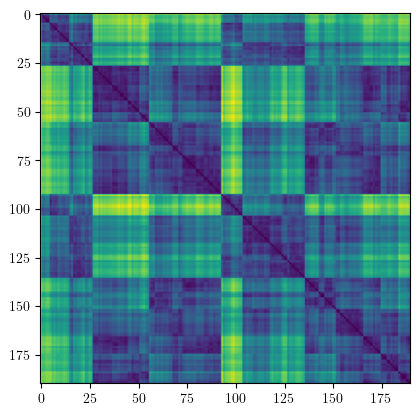

In [396]:
plt.imshow(distance_eccs[1][sorted_indices, :][:, sorted_indices])

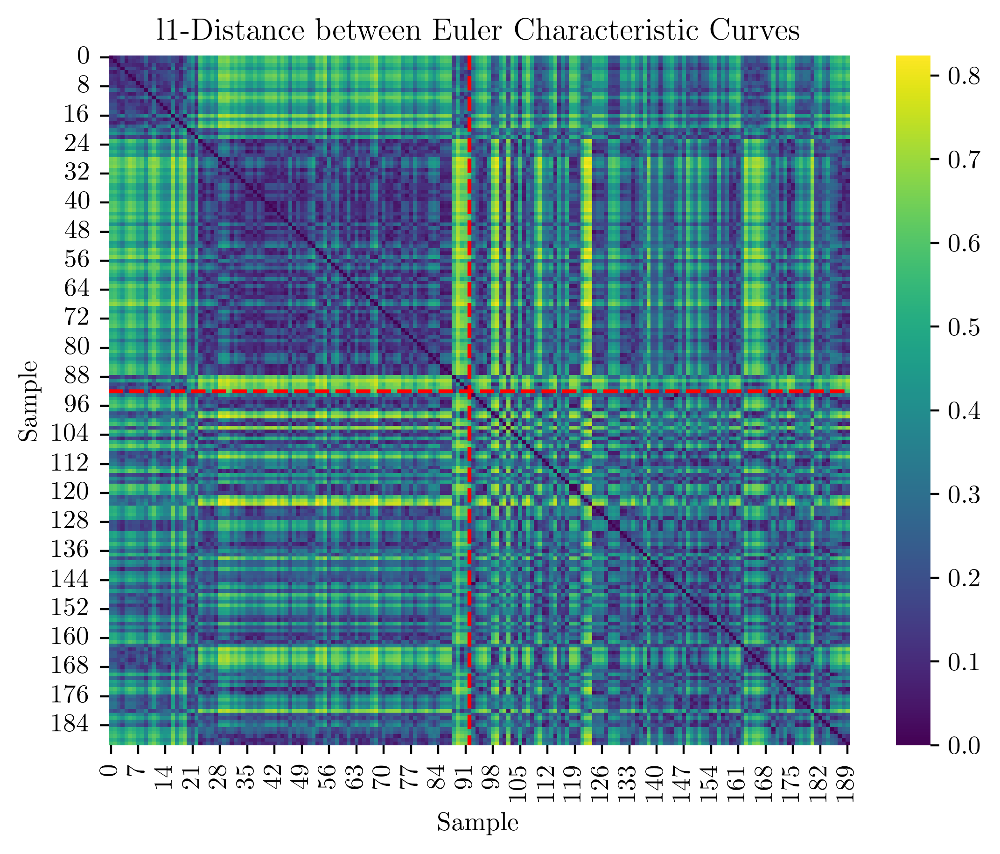

In [ ]:
fig, ax = plt.subplots(1,1, dpi=400)
sns.heatmap(distance_eccs[1], ax=ax, cmap='viridis')
ax.hlines(np.where(le == 0)[0][-1]+0.5, 0, len(ecc), colors='red', linestyles='dashed')
ax.vlines(np.where(le == 0)[0][-1]+0.5, 0, len(ecc), colors='red', linestyles='dashed')
ax.set_title('l1-Distance between Euler Characteristic Curves')
ax.set_xlabel('Sample')
ax.set_ylabel('Sample')
fig.savefig('newdata_figures/ecc_distance_heatmap.png', dpi=400, bbox_inches='tight')

In [ ]:
np.mean(distance_eccs / np.max(distance_eccs, axis=0)[:, np.newaxis], axis=1)

In [43]:
statistics = []
# Combine data
labels = le.copy()
for i, (curves, grid) in enumerate(zip(
    [ecc, ecc_normalize, ecc_org, ecc_org_normalize],
    [ecc_grid, ecc_grid, ecc_org_grid, ecc_org_grid])):

    for metric in ['sup', 'l1', 'l2']:
        # Run permutation test
        # if i==1 or i==3:
        #     curves2 = curves[:, grid < -1]
        #     grid2 = grid[grid < -1]
        # else:
        #     curves2 = curves[:, :-1]
        #     grid2 = grid[:-1]
        curves2 = curves[:, :-10]
        grid2 = grid[:-10]
        p_value, observed_stat, permuted_stats = \
            permutation_test(curves2, labels, 
                x=grid2, metric=metric, 
                n_permutations=2000, 
                random_state=42)
        if i==0 or i==2:
            normalized = 1
        else:
            normalized = 0
        if i==0 or i==1:
            scaled = 1
        else:
            scaled = 0
        
        statistics.append({'number': i,
                           'normalized': normalized,
                           'scaled': scaled, 
                           'norm': metric,
                           'p_value': p_value,
                           'observed_stat': observed_stat,
                           'permuted_stats': permuted_stats}.copy())
df_stats = pd.DataFrame(statistics)
print(np.count_nonzero(df_stats['p_value'] != 0))

1


In [58]:
pd.pivot(df_stats, index=['normalized', 'scaled'], columns='norm', values='p_value').to_csv('newdata_figures/pvalues_ecc.csv')

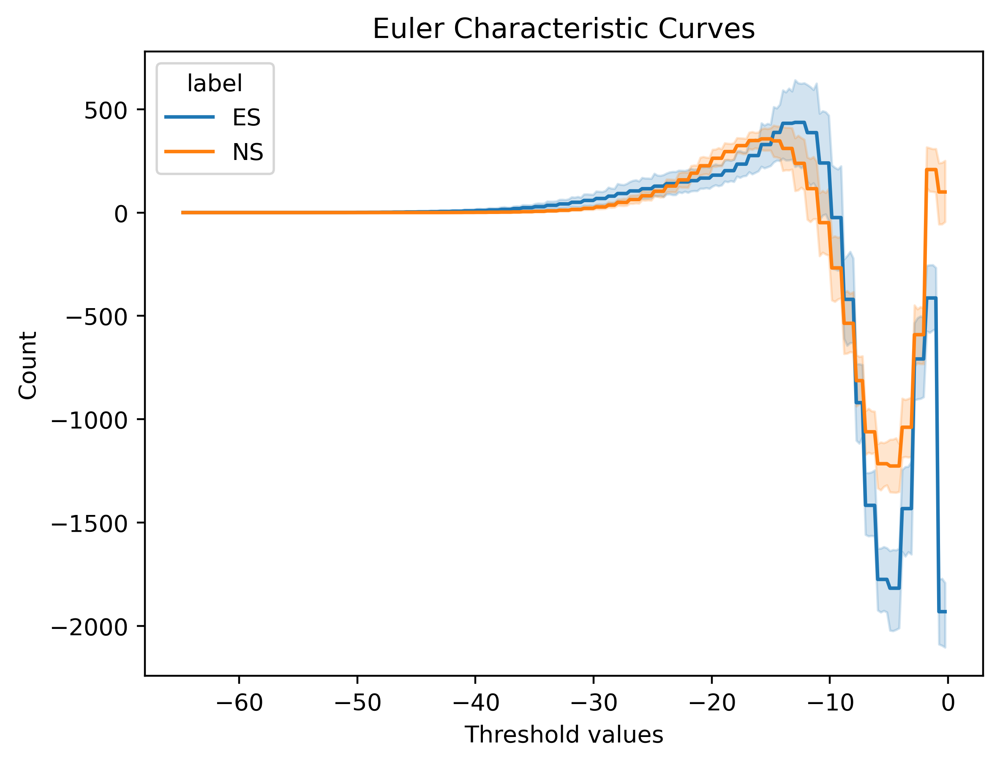

In [46]:
df_plot = pd.DataFrame(ecc_org)
df_plot.columns = ecc_org_grid
df_plot.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
# df_plot.loc[:, 'label'] = le
df_plot.loc[:, 'sample'] = np.arange(len(df_plot))

df_plot = df_plot.melt(id_vars=['sample', 'label'], var_name='x', value_name='y')
df_plot['x'] = pd.to_numeric(df_plot['x'], errors='coerce')
df_plot['y'] = pd.to_numeric(df_plot['y'], errors='coerce')
# df_plot['label'] = df_plot['label'].astype('category')

fig, ax = plt.subplots(1,1,dpi=400)
sns.lineplot(data=df_plot, x='x', y='y', hue='label', errorbar=('ci', 99), ax=ax)
ax.set_title('Euler Characteristic Curves')
ax.set_xlabel('Threshold values')
ax.set_ylabel('Count')

fig.savefig('newdata_figures/euler_characteristic_curves_maskedimage.png', dpi=400, bbox_inches='tight')

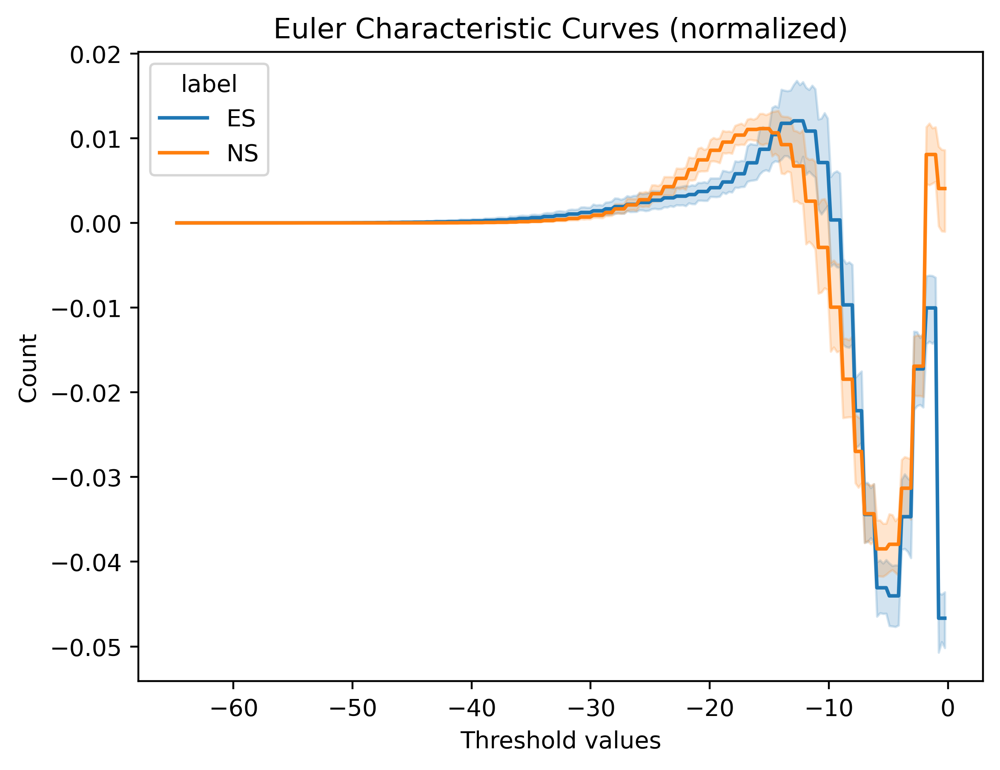

In [47]:
df_plot = pd.DataFrame(ecc_org_normalize)
df_plot.columns = ecc_org_grid
df_plot.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
# df_plot.loc[:, 'label'] = le
df_plot.loc[:, 'sample'] = np.arange(len(df_plot))

df_plot = df_plot.melt(id_vars=['sample', 'label'], var_name='x', value_name='y')
df_plot['x'] = pd.to_numeric(df_plot['x'], errors='coerce')
df_plot['y'] = pd.to_numeric(df_plot['y'], errors='coerce')
# df_plot['label'] = df_plot['label'].astype('category')

fig, ax = plt.subplots(1,1,dpi=400)
sns.lineplot(data=df_plot, x='x', y='y', hue='label', errorbar=('ci', 99), ax=ax)
ax.set_title('Euler Characteristic Curves (normalized)')
ax.set_xlabel('Threshold values')
ax.set_ylabel('Count')

fig.savefig('newdata_figures/euler_characteristic_curves_normalized_maskedimage.png', dpi=400, bbox_inches='tight')

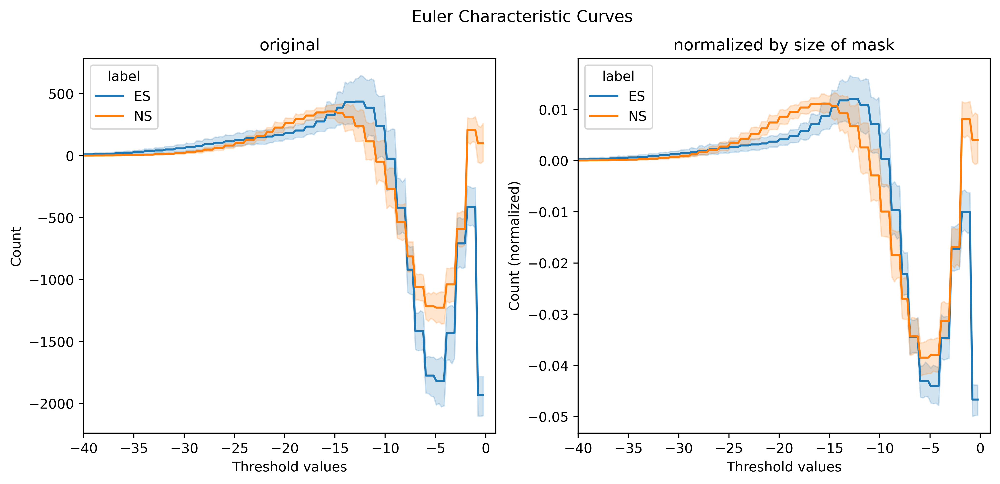

In [54]:
fig, ax = plt.subplots(1,2, figsize=(12,5), dpi=400)

df_plot = pd.DataFrame(ecc_org)
df_plot.columns = ecc_org_grid
df_plot.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
# df_plot.loc[:, 'label'] = le
df_plot.loc[:, 'sample'] = np.arange(len(df_plot))

df_plot = df_plot.melt(id_vars=['sample', 'label'], var_name='x', value_name='y')
df_plot['x'] = pd.to_numeric(df_plot['x'], errors='coerce')
df_plot['y'] = pd.to_numeric(df_plot['y'], errors='coerce')
# df_plot['label'] = df_plot['label'].astype('category')

sns.lineplot(data=df_plot, x='x', y='y', hue='label', errorbar=('ci', 99), ax=ax[0])
ax[0].set_xlim([-40, 1])
ax[0].set_title('original')
ax[0].set_xlabel('Threshold values')
ax[0].set_ylabel('Count')

df_plot = pd.DataFrame(ecc_org_normalize)
df_plot.columns = ecc_org_grid
df_plot.loc[:, 'label'] = ['ES' if x==0 else 'NS' for x in le]
# df_plot.loc[:, 'label'] = le
df_plot.loc[:, 'sample'] = np.arange(len(df_plot))

df_plot = df_plot.melt(id_vars=['sample', 'label'], var_name='x', value_name='y')
df_plot['x'] = pd.to_numeric(df_plot['x'], errors='coerce')
df_plot['y'] = pd.to_numeric(df_plot['y'], errors='coerce')
# df_plot['label'] = df_plot['label'].astype('category')

sns.lineplot(data=df_plot, x='x', y='y', hue='label', errorbar=('ci', 99), ax=ax[1])
ax[1].set_xlim([-40, 1])
ax[1].set_title('normalized by size of mask')
ax[1].set_xlabel('Threshold values')
ax[1].set_ylabel('Count (normalized)')

fig.suptitle('Euler Characteristic Curves')
fig.savefig('newdata_figures/euler_characteristic_curves_both_maskedimage.png', dpi=400, bbox_inches='tight')

# save the segmented images, and do the modified K ripley on them

In [61]:
import skimage.io as skio
imgtif = skio.imread('./Image 1002.tif')

In [60]:
import numpy as np
from scipy.stats import norm
from scipy.ndimage import binary_dilation
from skimage.morphology import disk

def RipleysK1(M, radius):
    """
    Calculate Ripley's K-function for a rectangular grayscale field of view.
    
    Parameters:
        M (numpy.ndarray): Grayscale image.
        radius (int): Radius at which K-NC is calculated.
        
    Returns:
        tuple: (K, K_NC, Q01, Q99) where:
               K - Raw K-function.
               K_NC - Normalized and centered K-function.
               Q01 - 1st quantile.
               Q99 - 99th quantile.
    """
    if radius < 1:
        raise ValueError("radius must be >= 1")

    # Constructing the circular structuring element
    dia = int(np.ceil(2 * radius))
    if dia % 2 == 0:
        dia += 1

    r = dia // 2
    y, x = np.meshgrid(np.arange(-r, r + 1), np.arange(-r, r + 1))
    rad = np.sqrt(x**2 + y**2)
    strel = rad <= radius
    strel = strel.astype(bool)
    # strel = strel.astype(float)
    # strel[strel == 0] = np.nan

    # Add margin around the image for edge correction
    m, n = M.shape
    N = np.full((m + 2 * radius, n + 2 * radius), np.nan)
    N[radius:m + radius, radius:n + radius] = M.astype(np.float64)

    # # Aggregation map
    AggMap = np.zeros_like(N)

    for i in range(radius, m + radius):
        for j in range(radius, n + radius):
            Window = N[i - radius:i + radius + 1, j - radius:j + radius + 1].copy()
            Window[~strel] = 0  # Ignore elements outside the circular SE

            # Center and Surround
            Center = Window[r, r]
            Surround = Window.copy()
            Surround[r, r] = 0
            Surround[np.isnan(Surround)] = 0

            # Edge correction
            # Window_Binary = (~np.isnan(Window)).astype(float)
            # b = (Window_Binary + strel)
            # b[b < 2] = 0
            # b[b >= 2] = 1
            # EdgeCorrection = np.sum(b) / (np.pi * (radius**2))
            Window_Binary = Window + 1
            Window_Binary[np.isnan(Window_Binary)] = 0
            Window_Binary[Window_Binary > 0] = 1

            strel1 = strel.copy().astype(np.float64)
            strel1[strel == 0] = np.nan

            b = Window_Binary + strel1
            b[b<2] = 0
            b[b>1] = 1
            b[np.isnan(b)] = 0
            EdgeCorrection = np.sum(b) / (np.pi * (radius**2))

            # Build aggregation map
            if Center > 0:
                AggMap[i, j] = (Center * (Center - 1) + Center * np.sum(Surround)) / EdgeCorrection
                print(i+1, j+1, AggMap[i, j], EdgeCorrection, Center, np.sum(Surround))
                # print(b)
    AggMap = AggMap[radius:m + radius, radius:n + radius]

    # Calculate K statistics
    M_Sum = np.sum(M)
    M_Area = M.size
    K = np.sum(AggMap) * (M_Area / (M_Sum * (M_Sum - 1)))

    # Perimeter and Variance
    M_Perimeter = 2 * (m + n)
    BetaR = (np.pi * (radius**2)) / M_Area
    GammaR = (M_Perimeter * radius) / M_Area

    Var_K = (2 * (M_Area**2) * BetaR / M_Sum**2) * (
        1 + 0.305 * GammaR + BetaR * (-1 + 0.0132 * M_Sum * GammaR)
    )

    # Normalized and Centered K
    K_NC = (K - (np.pi * (radius**2))) / (np.sqrt(Var_K))

    # Skewness and Kurtosis
    Skew_K = ((4 * (M_Area**3) * BetaR) / ((M_Sum**4) * (Var_K**1.5))) * (
        1 + 0.76 * GammaR + M_Sum * BetaR * (1.173 + 0.414 * GammaR)
        + M_Sum * (BetaR**2) * (-2 + 0.012 * M_Sum * GammaR)
    )

    Kurt_K = ((M_Area**4) * BetaR) / ((M_Sum**6) * (Var_K**2)) * (
        8 + 11.52 * GammaR + M_Sum * BetaR * (104.3 + 12 * M_Sum +
        (78.7 + 7.32 * M_Sum) * GammaR + 1.116 * M_Sum * GammaR**2) +
        M_Sum * (BetaR**2) * ((-304.3 - 1.92 * M_Sum) + 
        (-97.9 + 2.69 * M_Sum + 0.317 * M_Sum**2) * GammaR +
        0.0966 * M_Sum**2 * GammaR**2) +
        (M_Sum**2) * (BetaR**3) * (-36 + 0.0021 * M_Sum**2 * GammaR**2)
    )

    # Quantiles
    Z01 = norm.ppf(0.01)
    Z99 = norm.ppf(0.99)

    Q01 = Z01 + (1/6) * (Z01**2 - 1) * Skew_K + \
            (1/24) * ((Z01**3) - 3 * Z01) * (Kurt_K - 3) - \
            (1/36) * (2 * (Z01**3) - 5 * Z01) * (Skew_K**2)

    Q99 = Z99 + (1/6) * (Z99**2 - 1) * Skew_K + \
            (1/24) * ((Z99**3) - 3 * Z99) * (Kurt_K - 3) - \
            (1/36) * (2 * (Z99**3) - 5 * Z99) * (Skew_K**2)

    return K, K_NC, Q01, Q99

def RipleysK2(M, radius, ignore_value=0):
    """
    Calculate Ripley's K-function for a rectangular grayscale field of view,
    ignoring regions with a specific value.
    
    Parameters:
        M (numpy.ndarray): Grayscale image.
        radius (int): Radius at which K-NC is calculated.
        ignore_value (float): Value of pixels to be ignored (e.g., 0, -1).
        
    Returns:
        tuple: (K, K_NC, Q01, Q99) where:
               K - Raw K-function.
               K_NC - Normalized and centered K-function.
               Q01 - 1st quantile.
               Q99 - 99th quantile.
    """
    if radius < 1:
        raise ValueError("radius must be >= 1")

    # Replace ignore_value with NaN to exclude these regions
    M = np.where(M == ignore_value, np.nan, M)

    # Constructing the circular structuring element
    dia = int(np.ceil(2 * radius))
    if dia % 2 == 0:
        dia += 1

    r = dia // 2
    y, x = np.meshgrid(np.arange(-r, r + 1), np.arange(-r, r + 1))
    rad = np.sqrt(x**2 + y**2)
    strel = rad <= radius
    strel = strel.astype(bool)
    # strel = strel.astype(float)
    # strel[strel == 0] = np.nan

    # Add margin around the image for edge correction
    m, n = M.shape
    N = np.full((m + 2 * radius, n + 2 * radius), np.nan)
    N[radius:m + radius, radius:n + radius] = M.astype(np.float64)

    # # Aggregation map
    AggMap = np.zeros_like(N)

    for i in range(radius, m + radius):
        for j in range(radius, n + radius):
            Window = N[i - radius:i + radius + 1, j - radius:j + radius + 1].copy()
            Window[~strel] = 0  # Ignore elements outside the circular SE

            # Center and Surround
            Center = Window[r, r]
            Surround = Window.copy()
            Surround[r, r] = 0
            Surround[np.isnan(Surround)] = 0

            # Edge correction
            # Window_Binary = (~np.isnan(Window)).astype(float)
            # b = (Window_Binary + strel)
            # b[b < 2] = 0
            # b[b >= 2] = 1
            # EdgeCorrection = np.sum(b) / (np.pi * (radius**2))
            Window_Binary = Window + 1
            Window_Binary[np.isnan(Window_Binary)] = 0
            Window_Binary[Window_Binary > 0] = 1

            strel1 = strel.copy().astype(np.float64)
            strel1[strel == 0] = np.nan

            b = Window_Binary + strel1
            b[b<2] = 0
            b[b>1] = 1
            b[np.isnan(b)] = 0

            # IGNORING ZERO PIXELS FROM THE ORIGINAL IMAGE FROM EDGE CORRECTION
            b[Window == ignore_value] = 0
            EdgeCorrection = np.sum(b) / (np.pi * (radius**2))

            # Build aggregation map
            if Center > 0:
                AggMap[i, j] = (Center * (Center - 1) + Center * np.sum(Surround)) / EdgeCorrection
                # print(i+1, j+1, AggMap[i, j], EdgeCorrection, Center, np.sum(Surround))
                # print(b)
    AggMap = AggMap[radius:m + radius, radius:n + radius]

    # Calculate K statistics
    M_Sum = np.nansum(M)
    M_Area = np.sum(~np.isnan(M))
    K = np.sum(AggMap) * (M_Area / (M_Sum * (M_Sum - 1)))

    # Perimeter calculation
    N_Binary = (~np.isnan(N)).astype(float)
    N_Binary[N_Binary > 0] = 1

    N_Border = np.zeros_like(N_Binary)
    for i in range(1, m + 2 * radius - 1):
        for j in range(1, n + 2 * radius - 1):
            if N_Binary[i, j] == 1:
                N_Border[i, j] = N_Binary[i - 1, j - 1] + N_Binary[i - 1, j] + N_Binary[i - 1, j + 1] + \
                                 N_Binary[i, j - 1] + N_Binary[i, j + 1] + \
                                 N_Binary[i + 1, j - 1] + N_Binary[i + 1, j] + N_Binary[i + 1, j + 1]

    N_Border[N_Border == 8] = 0
    N_Border[N_Border != 0] = 1

    M_Perimeter = np.sum(N_Border)

    # Variance of K
    BetaR = (np.pi * (radius**2)) / M_Area
    GammaR = (M_Perimeter * radius) / M_Area

    Var_K = (2 * (M_Area**2) * BetaR / M_Sum**2) * (
        1 + 0.305 * GammaR + BetaR * (-1 + 0.0132 * M_Sum * GammaR)
    )

    # Normalized and Centered K
    K_NC = (K - (np.pi * (radius**2))) / (np.sqrt(Var_K))

    # Skewness and Kurtosis
    Skew_K = ((4 * (M_Area**3) * BetaR) / ((M_Sum**4) * (Var_K**1.5))) * (
        1 + 0.76 * GammaR + M_Sum * BetaR * (1.173 + 0.414 * GammaR)
        + M_Sum * (BetaR**2) * (-2 + 0.012 * M_Sum * GammaR)
    )

    Kurt_K = ((M_Area**4) * BetaR) / ((M_Sum**6) * (Var_K**2)) * (
        8 + 11.52 * GammaR + M_Sum * BetaR * (104.3 + 12 * M_Sum +
        (78.7 + 7.32 * M_Sum) * GammaR + 1.116 * M_Sum * GammaR**2) +
        M_Sum * (BetaR**2) * ((-304.3 - 1.92 * M_Sum) + 
        (-97.9 + 2.69 * M_Sum + 0.317 * M_Sum**2) * GammaR +
        0.0966 * M_Sum**2 * GammaR**2) +
        (M_Sum**2) * (BetaR**3) * (-36 + 0.0021 * M_Sum**2 * GammaR**2)
    )

    # Quantiles
    Z01 = norm.ppf(0.01)
    Z99 = norm.ppf(0.99)

    Q01 = Z01 + (1/6) * (Z01**2 - 1) * Skew_K + \
          (1/24) * ((Z01**3) - 3 * Z01) * (Kurt_K - 3) - \
          (1/36) * (2 * (Z01**3) - 5 * Z01) * (Skew_K**2)

    Q99 = Z99 + (1/6) * (Z99**2 - 1) * Skew_K + \
          (1/24) * ((Z99**3) - 3 * Z99) * (Kurt_K - 3) - \
          (1/36) * (2 * (Z99**3) - 5 * Z99) * (Skew_K**2)

    return K, K_NC, Q01, Q99

def RipleysK(M, radius, ignore_value=None):
    """
    Calculate Ripley's K-function for a rectangular grayscale field of view.
    
    Parameters:
        M (numpy.ndarray): Grayscale image.
        radius (int): Radius at which K-NC is calculated.
        ignore_value (float): Value of pixels to be ignored (e.g., 0, -1).
            if None, then do not ignore any pixels.
        
    Returns:
        tuple: (K, K_NC, Q01, Q99) where:
               K - Raw K-function.
               K_NC - Normalized and centered K-function.
               Q01 - 1st quantile.
               Q99 - 99th quantile.
    """
    if radius < 1:
        raise ValueError("radius must be >= 1")

    # Constructing the circular structuring element
    dia = int(np.ceil(2 * radius))
    if dia % 2 == 0:
        dia += 1

    r = dia // 2
    y, x = np.meshgrid(np.arange(-r, r + 1), np.arange(-r, r + 1))
    rad = np.sqrt(x**2 + y**2)
    strel = rad <= radius
    strel = strel.astype(bool)
    # strel = strel.astype(float)
    # strel[strel == 0] = np.nan

    # Add margin around the image for edge correction
    m, n = M.shape
    N = np.full((m + 2 * radius, n + 2 * radius), np.nan)
    N[radius:m + radius, radius:n + radius] = M.astype(np.float64)

    # # Aggregation map
    AggMap = np.zeros_like(N)

    for i in range(radius, m + radius):
        for j in range(radius, n + radius):
            Window = N[i - radius:i + radius + 1, j - radius:j + radius + 1].copy()
            Window[~strel] = 0  # Ignore elements outside the circular SE

            # Center and Surround
            Center = Window[r, r]
            if Center is np.nan or Center == 0:
                continue
            Surround = Window.copy()
            Surround[r, r] = 0
            Surround[np.isnan(Surround)] = 0

            # Edge correction
            # Window_Binary = (~np.isnan(Window)).astype(float)
            # b = (Window_Binary + strel)
            # b[b < 2] = 0
            # b[b >= 2] = 1
            # EdgeCorrection = np.sum(b) / (np.pi * (radius**2))
            Window_Binary = Window + 1
            Window_Binary[np.isnan(Window_Binary)] = 0
            Window_Binary[Window_Binary > 0] = 1

            strel1 = strel.copy().astype(np.float64)
            strel1[strel == 0] = np.nan

            b = Window_Binary + strel1
            b[b<2] = 0
            b[b>1] = 1
            b[np.isnan(b)] = 0

            if ignore_value is not None:
                # IGNORING ZERO PIXELS FROM THE ORIGINAL IMAGE FROM EDGE CORRECTION
                b[Window == ignore_value] = 0

            EdgeCorrection = np.sum(b) / (np.pi * (radius**2))

            # Build aggregation map
            if np.isnan(Center) == False and Center > 0:
                AggMap[i, j] = (Center * (Center - 1) + Center * np.sum(Surround)) / EdgeCorrection
                # print(i+1, j+1, AggMap[i, j], EdgeCorrection, Center, np.sum(Surround))

    AggMap = AggMap[radius:m + radius, radius:n + radius]

    # Calculate K statistics
    if ignore_value is None:
        M_Sum = np.nansum(M)
        M_Area = M.size
        M_Perimeter = 2 * (m + n)
        
    else:
        # Calculate K statistics
        M_Sum = np.nansum(M)
        M_Area = np.nansum(M[~np.isnan(M)] > 0)

        # Perimeter calculation
        # N_Binary = (~np.isnan(N)).astype(float)
        N_Binary = N.copy()
        # N_Binary[(N_Binary != ignore_value) & (~np.isnan(N_))] = 1
        N_Binary[N_Binary > 0] = 1

        N_Border = np.zeros_like(N_Binary)
        for i in range(1, m + 2 * radius - 1):
            for j in range(1, n + 2 * radius - 1):
                if N_Binary[i, j] == 1:
                    N_Border[i, j] = N_Binary[i - 1, j - 1] + N_Binary[i - 1, j] + N_Binary[i - 1, j + 1] + \
                                    N_Binary[i, j - 1] + N_Binary[i, j + 1] + \
                                    N_Binary[i + 1, j - 1] + N_Binary[i + 1, j] + N_Binary[i + 1, j + 1]

        N_Border[N_Border == 8] = 0
        N_Border[N_Border != 0] = 1

        M_Perimeter = np.sum(N_Border)

    K = np.sum(AggMap) * (M_Area / (M_Sum * (M_Sum - 1)))
    print(M_Sum, M_Area, K, M_Perimeter)

    # Variance
    BetaR = (np.pi * (radius**2)) / M_Area
    GammaR = (M_Perimeter * radius) / M_Area

    Var_K = (2 * (M_Area**2) * BetaR / M_Sum**2) * (
        1 + 0.305 * GammaR + BetaR * (-1 + 0.0132 * M_Sum * GammaR)
    )

    # Normalized and Centered K
    K_NC = (K - (np.pi * (radius**2))) / (np.sqrt(Var_K))

    # Skewness and Kurtosis
    Skew_K = ((4 * (M_Area**3) * BetaR) / ((M_Sum**4) * (Var_K**1.5))) * (
        1 + 0.76 * GammaR + M_Sum * BetaR * (1.173 + 0.414 * GammaR)
        + M_Sum * (BetaR**2) * (-2 + 0.012 * M_Sum * GammaR)
    )

    Kurt_K = ((M_Area**4) * BetaR) / ((M_Sum**6) * (Var_K**2)) * (
        8 + 11.52 * GammaR + M_Sum * BetaR * (104.3 + 12 * M_Sum +
        (78.7 + 7.32 * M_Sum) * GammaR + 1.116 * M_Sum * GammaR**2) +
        M_Sum * (BetaR**2) * ((-304.3 - 1.92 * M_Sum) + 
        (-97.9 + 2.69 * M_Sum + 0.317 * M_Sum**2) * GammaR +
        0.0966 * M_Sum**2 * GammaR**2) +
        (M_Sum**2) * (BetaR**3) * (-36 + 0.0021 * M_Sum**2 * GammaR**2)
    )

    # Quantiles
    Z01 = norm.ppf(0.01)
    Z99 = norm.ppf(0.99)

    Q01 = Z01 + (1/6) * (Z01**2 - 1) * Skew_K + \
            (1/24) * ((Z01**3) - 3 * Z01) * (Kurt_K - 3) - \
            (1/36) * (2 * (Z01**3) - 5 * Z01) * (Skew_K**2)

    Q99 = Z99 + (1/6) * (Z99**2 - 1) * Skew_K + \
            (1/24) * ((Z99**3) - 3 * Z99) * (Kurt_K - 3) - \
            (1/36) * (2 * (Z99**3) - 5 * Z99) * (Skew_K**2)

    return K, K_NC, Q01, Q99

In [62]:
M = imgtif
radius = 3

In [63]:
RipleysK(M, radius)

34387 8188 73.93973288779144 362


(73.93973288779144, 2068.3110896698586, -2.26519750524327, 2.3900775631995526)

In [64]:
RipleysK(M, radius, ignore_value=0)

34387 5239 47.606578502413015 562.0


(47.606578502413015,
 890.4999748036524,
 -2.2687898075580266,
 2.3883451209052513)

(array([1., 2., 3., 4., 5., 6., 7., 8., 9.], dtype=float32), array([1109, 1084, 1091, 1104, 1163, 1056, 1147, 1184, 1062]))
50176.0 10000 113.18530304319471 400
(113.18530304319471, 1.7354820324229117, -2.2641503678229373, 2.3961564874934114)
50176.0 10000 113.18530304319471 396.0
(113.18530304319471, 1.7411873498853008, -2.2639012900815945, 2.3964126408195034)

(array([-1.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9.], dtype=float32), array([1002, 1013,  964,  970, 1013, 1050,  956, 1021, 1069,  942]))
44064.0 10000 230.29602775441455 400
(230.29602775441455, 292.6037071685543, -2.266103854183353, 2.3962235995152477)
44064.0 8998 207.22036577342223 782.0
(207.22036577342223, 44.61156964397444, -2.284618194967888, 2.3761960515330145)


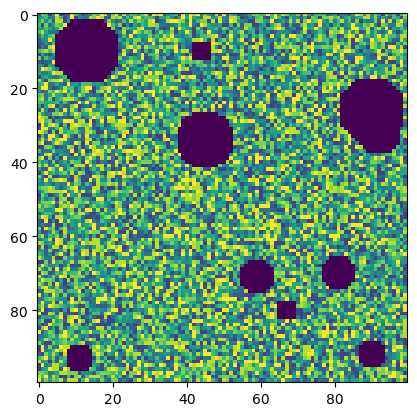

In [66]:
import random
from skimage.draw import disk

img = np.random.randint(1, 10, (100,100)).astype(np.float32)

# Parameters for random disks
num_disks = 10
min_radius = 3
max_radius = 10

print(np.unique(img, return_counts=True))
print(RipleysK(img.astype(np.float32), radius, ignore_value=None))
print(RipleysK(img.astype(np.float32), radius, ignore_value=-1))

# Add random disks to the image
for _ in range(num_disks):
    radius = random.randint(min_radius, max_radius)
    center_x = random.randint(radius, img.shape[0] - radius)
    center_y = random.randint(radius, img.shape[1] - radius)
    rr, cc = disk((center_x, center_y), radius)
    img[rr, cc] = -1  # Assign a value to the disk, e.g., 3

plt.imshow(img, cmap='viridis')

print()
print(np.unique(img, return_counts=True))
print(RipleysK(img.astype(np.float32), radius, ignore_value=None))
print(RipleysK(img.astype(np.float32), radius, ignore_value=-1))

(array([1., 2.], dtype=float32), array([5044, 4956]))
14956.0 10000 200.40564790451657 400
(200.40564790451657, -3.1945231148769846, -2.232969851917766, 2.4317066632567568)
14956.0 10000 200.40564790451657 396.0
(200.40564790451657, -3.2038698264182184, -2.2326387237362098, 2.4320598252779466)

(array([-1.,  1.,  2.], dtype=float32), array([1346, 4368, 4286]))
11594.0 10000 206.88713869106246 400
(206.88713869106246, 266.0262234560051, -2.225665377073146, 2.437180118481663)
11594.0 8654 179.04012982324545 865.0
(179.04012982324545, 101.26091065384605, -2.2507986843014818, 2.411674924897273)

(array([-1.,  1.,  2.], dtype=float32), array([1346, 4368, 4286]))
21594.0 10000 166.32322553661726 400
(166.32322553661726, 100.53452223111722, -2.2431522982395715, 2.419282017392462)
21594.0 8654 153.48541803334018 881.0
(153.48541803334018, -2.729447669723614, -2.2686869090270316, 2.3927215093476266)


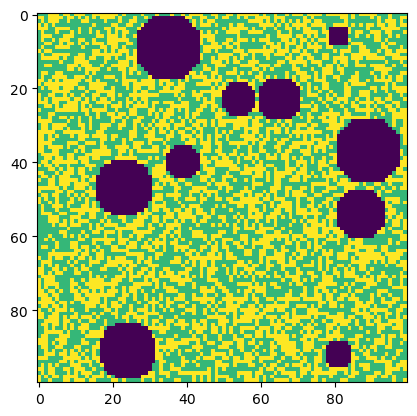

In [67]:
import random
from skimage.draw import disk

img = np.random.randint(1, 3, (100,100)).astype(np.float32)

# Parameters for random disks
num_disks = 10
min_radius = 3
max_radius = 10

print(np.unique(img, return_counts=True))
print(RipleysK(img.astype(np.float32), radius, ignore_value=None))
print(RipleysK(img.astype(np.float32), radius, ignore_value=0))

# Add random disks to the image
for _ in range(num_disks):
    radius = random.randint(min_radius, max_radius)
    center_x = random.randint(radius, img.shape[0] - radius)
    center_y = random.randint(radius, img.shape[1] - radius)
    rr, cc = disk((center_x, center_y), radius)
    img[rr, cc] =  -1  # Assign a value to the disk, e.g., 3

plt.imshow(img, cmap='viridis')

print()
print(np.unique(img, return_counts=True))
print(RipleysK(img.astype(np.float32), radius, ignore_value=None))
print(RipleysK(img.astype(np.float32), radius, ignore_value=-1))

imgchanged = img.copy().astype(np.float32)
imgchanged += 1
print()
print(np.unique(img, return_counts=True))
print(RipleysK(imgchanged, radius, ignore_value=None))
print(RipleysK(imgchanged, radius, ignore_value=0))

In [68]:
# radii = np.arange(3, 23, 4)
radii = [3, 9, 15, 21, 200]
kn = np.zeros((len(images), len(radii)))
for i, img in tqdm(enumerate(images), total=len(images)):
    for ri, radius in enumerate(radii):
        imgchanged = img.copy().astype(np.float32)
        imgchanged[imgchanged == -1] = 0
        kn[i, ri] = RipleysK(imgchanged, radius, ignore_value=0)[1]

  0%|          | 0/190 [00:00<?, ?it/s]

650527.0 50312 34.4880605183065 1649.0
650527.0 50312 300.40725335623387 1649.0


  0%|          | 0/190 [00:02<?, ?it/s]


KeyboardInterrupt: 

In [384]:
# radii = np.arange(3, 23, 4)
radii = [3, 9, 15, 21, 200]
kn = np.zeros((len(images), len(radii)))
for i, img in tqdm(enumerate(images), total=len(images)):
    for ri, radius in enumerate(radii):
        imgchanged = img.copy().astype(np.float32)
        imgchanged[imgchanged == -1] = 0
        kn[i, ri] = RipleysK(imgchanged, radius, ignore_value=0)[1]

  0%|          | 0/190 [00:00<?, ?it/s]

650527.0 50312 34.4880605183065 1649.0
650527.0 50312 300.40725335623387 1649.0
650527.0 50312 810.0746382381491 1649.0
650527.0 50312 1555.0071791992618 1649.0


  1%|          | 1/190 [01:35<5:02:00, 95.88s/it]

650527.0 50312 126626.75416059313 1649.0
597808.0 48421 34.20581946260638 1944.0
597808.0 48421 299.31677894081776 1944.0
597808.0 48421 813.3120063436721 1944.0
597808.0 48421 1570.421812433257 1944.0


  1%|          | 1/190 [01:45<5:30:53, 105.04s/it]


KeyboardInterrupt: 

In [388]:
"""
Let's try to do simulate ripley's K usingh a monte carlo approach

"""

import numpy as np
from scipy.spatial import KDTree, ConvexHull
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt

def compute_ripley_k(image, mask, radii, pixel_size, n_simulations=100):
    """
    Compute Ripley's K-function for a grayscale image and mask (convex hull).
    
    Parameters:
        image (numpy.ndarray): 2D grayscale image where pixel values are point counts.
        mask (numpy.ndarray): Binary mask for the convex hull (1=inside, 0=outside).
        radii (numpy.ndarray): Radii for which to compute K(r).
        pixel_size (tuple): (width, height) of a pixel in real-world units.
        n_simulations (int): Number of Monte Carlo simulations.
    
    Returns:
        observed_k (numpy.ndarray): Observed K(r) values.
        simulations_k (numpy.ndarray): K(r) values from simulations.
    """
    # Step 1: Prepare the convex hull and observed points
    y_indices, x_indices = np.where(mask)
    observed_points = []
    for y, x in zip(y_indices, x_indices):
        num_points = int(image[y, x])  # Number of points in this pixel
        if num_points > 0:
            x_center = x + 0.5
            y_center = y + 0.5
            for _ in range(num_points):
                # Add points uniformly distributed in the pixel
                observed_points.append([
                    x_center + np.random.uniform(-0.5, 0.5) * pixel_size[0],
                    y_center + np.random.uniform(-0.5, 0.5) * pixel_size[1]
                ])
    observed_points = np.array(observed_points)
    
    # Compute the convex hull polygon for mask
    hull = ConvexHull(np.column_stack((x_indices, y_indices)))
    hull_polygon = Polygon(hull.points[hull.vertices])
    domain_area = hull_polygon.area * (pixel_size[0] * pixel_size[1])

    # Step 2: Compute observed Ripley's K
    tree = KDTree(observed_points)
    n_points = len(observed_points)
    observed_k = []
    for r in radii:
        count = np.sum([
            len(tree.query_ball_point(point, r)) - 1  # Exclude self-count
            for point in observed_points
            if Point(point).within(hull_polygon)
        ])
        k_value = domain_area * count / (n_points * (n_points - 1))
        observed_k.append(k_value)
    observed_k = np.array(observed_k)

    # Step 3: Monte Carlo Simulations
    simulations_k = []
    for _ in tqdm(range(n_simulations), total=n_simulations, desc="Simulations"):
        simulated_points = []
        while len(simulated_points) < n_points:
            x_rand = np.random.uniform(mask.shape[1])
            y_rand = np.random.uniform(mask.shape[0])
            if mask[int(y_rand), int(x_rand)] == 1:  # Inside mask
                simulated_points.append([
                    x_rand + np.random.uniform(-0.5, 0.5) * pixel_size[0],
                    y_rand + np.random.uniform(-0.5, 0.5) * pixel_size[1]
                ])
        simulated_points = np.array(simulated_points)
        sim_tree = KDTree(simulated_points)
        
        sim_k = []
        for r in radii:
            count = np.sum([
                len(sim_tree.query_ball_point(point, r)) - 1
                for point in simulated_points
                if Point(point).within(hull_polygon)
            ])
            k_value = domain_area * count / (n_points * (n_points - 1))
            sim_k.append(k_value)
        simulations_k.append(sim_k)
    simulations_k = np.array(simulations_k)

    return observed_k, simulations_k

# # Example usage
# import random
# from skimage.draw import disk

# img = np.random.randint(0, 10, (100,100)).astype(np.float32)

# # Parameters for random disks
# num_disks = 10
# min_radius = 3
# max_radius = 10

# print(np.unique(img, return_counts=True))
# print(RipleysK(img.astype(np.float32), radius, ignore_value=None))
# print(RipleysK(img.astype(np.float32), radius, ignore_value=0))

# # Add random disks to the image
# for _ in range(num_disks):
#     radius = random.randint(min_radius, max_radius)
#     center_x = random.randint(radius, img.shape[0] - radius)
#     center_y = random.randint(radius, img.shape[1] - radius)
#     rr, cc = disk((center_x, center_y), radius)
#     img[rr, cc] =  -1  # Assign a value to the disk, e.g., 3

# mask = (img != -1).astype(bool)
# pixel_size = (1, 1)  # Each pixel is 1x1 in size
# radii = np.arange(1, 21, 1)

# observed_k, simulations_k = compute_ripley_k(img, mask, radii, pixel_size)

# # Compute confidence intervals
# lower_ci = np.percentile(simulations_k, 2.5, axis=0)
# upper_ci = np.percentile(simulations_k, 97.5, axis=0)

# # Plot results
# plt.figure(figsize=(8, 6))
# plt.plot(radii, observed_k, label="Observed K(r)", color="blue")
# plt.fill_between(radii, lower_ci, upper_ci, color="gray", alpha=0.5, label="95% CI (CSR)")
# plt.xlabel("Radius (r)")
# plt.ylabel("K(r)")
# plt.legend()
# plt.title("Ripley's K-function with Monte Carlo Simulations")
# plt.show()

In [390]:
import numpy as np
from scipy.spatial import ConvexHull
from scipy.ndimage import distance_transform_edt
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt

def optimized_ripley_k(image, mask, radii, pixel_size, n_simulations=100):
    """
    Optimized computation of Ripley's K-function for a grayscale image.
    
    Parameters:
        image (numpy.ndarray): 2D grayscale image where pixel values are point counts.
        mask (numpy.ndarray): Binary mask for the convex hull (1=inside, 0=outside).
        radii (numpy.ndarray): Radii for which to compute K(r).
        pixel_size (tuple): (width, height) of a pixel in real-world units.
        n_simulations (int): Number of Monte Carlo simulations.
    
    Returns:
        observed_k (numpy.ndarray): Observed K(r) values.
        simulations_k (numpy.ndarray): K(r) values from simulations.
    """
    # Step 1: Compute convex hull and domain properties
    y_indices, x_indices = np.where(mask)
    hull = ConvexHull(np.column_stack((x_indices, y_indices)))
    hull_polygon = Polygon(hull.points[hull.vertices])
    domain_area = np.sum(mask) * (pixel_size[0] * pixel_size[1])

    # Step 2: Compute observed Ripley's K
    observed_k = []
    for r in radii:
        # Create a distance map for the disk of radius r
        distance_map = distance_transform_edt(mask) * pixel_size[0]
        disk_mask = distance_map <= r

        # Sum contributions from all pixels within the disk
        k_value = domain_area * np.sum(image[mask] * disk_mask[mask]) / (np.sum(image[mask])**2)
        observed_k.append(k_value)
    observed_k = np.array(observed_k)

    # Step 3: Monte Carlo Simulations
    n_points = int(np.sum(image[mask]))  # Total points based on pixel intensities
    simulations_k = []
    for _ in range(n_simulations):
        # Simulate random points inside the convex hull
        simulated_image = np.zeros_like(image, dtype=float)
        while np.sum(simulated_image[mask]) < n_points:
            x_rand = np.random.uniform(0, mask.shape[1])
            y_rand = np.random.uniform(0, mask.shape[0])
            if mask[int(y_rand), int(x_rand)] == 1:  # Inside the mask
                simulated_image[int(y_rand), int(x_rand)] += 1

        # Compute K(r) for the simulated distribution
        sim_k = []
        for r in radii:
            distance_map = distance_transform_edt(mask) * pixel_size[0]
            disk_mask = distance_map <= r
            k_value = domain_area * np.sum(simulated_image[mask] * disk_mask[mask]) / (n_points**2)
            sim_k.append(k_value)
        simulations_k.append(sim_k)
    simulations_k = np.array(simulations_k)

    return observed_k, simulations_k

In [391]:
mask = (img != -1).astype(bool)
pixel_size = (1, 1)  # Each pixel is 1x1 in size
radii = np.arange(1, 21, 1)

observed_k, simulations_k = compute_ripley_k(img, mask, radii, pixel_size)

# Compute confidence intervals
lower_ci = np.percentile(simulations_k, 2.5, axis=0)
upper_ci = np.percentile(simulations_k, 97.5, axis=0)

# Plot results
plt.figure(figsize=(8, 6))
plt.plot(radii, observed_k, label="Observed K(r)", color="blue")
plt.fill_between(radii, lower_ci, upper_ci, color="gray", alpha=0.5, label="95% CI (CSR)")
plt.xlabel("Radius (r)")
plt.ylabel("K(r)")
plt.legend()
plt.title("Ripley's K-function with Monte Carlo Simulations")
plt.show()

Simulations:   7%|▋         | 7/100 [03:37<48:09, 31.07s/it]


KeyboardInterrupt: 

# Other ways

<>:53: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:53: SyntaxWarning: "is" with a literal. Did you mean "=="?
/var/folders/1x/3dp0sbq930scn9c7wmp218800000gn/T/ipykernel_15422/3649936.py:53: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if adjust_filter is 'nan':


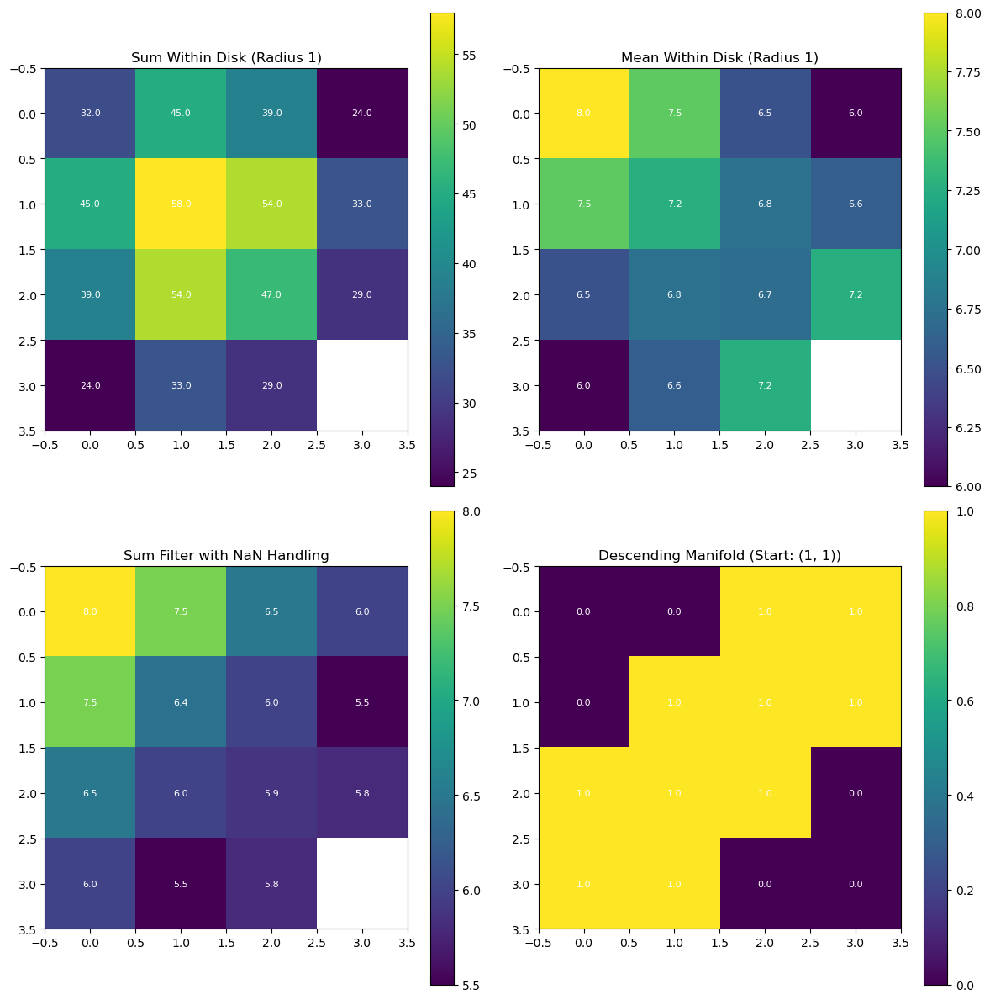

In [34]:
import numpy as np
from collections import deque

import numpy as np
from scipy.ndimage import generic_filter

def mydisk(radius):
    """
    Create a disk-shaped structuring element.
    """
    radiusmask = int(np.floor(radius))
    y, x = np.ogrid[-radiusmask:radiusmask+1, -radiusmask:radiusmask+1]
    mask = x**2 + y**2 <= radius**2
    return mask.astype(int)

def sum_within_disk(image, radius, adjust_filter=None, normalization=False):
    """
    Apply a filter to sum up all the values of the surrounding pixels within a disk of radius R.
    
    Parameters:
        image (numpy.ndarray): Input image.
        radius (int): Radius of the disk.
        
    Returns:
        numpy.ndarray: Filtered image with summed values.
    """
    # Create a disk-shaped footprint
    footprint = mydisk(radius)
    
    # Define a function to sum up the values within the footprint
    def sum_filter(values):
        center_value = values[len(values) // 2]  # Get the center value
        if np.isnan(center_value):  # Check if the center value is NaN
            return np.nan
        return np.nansum(values)
    def sum_filter_without_nan(values):
        center_value = values[len(values) // 2]  # Get the center value
        if np.isnan(center_value):  # Check if the center value is NaN
            return np.nan
        if np.nansum(values > 0) == 0:
            return 0
        return np.nansum(values)/(np.sum(~np.isnan(values)))
    def sum_filter_mean(values):
        center_value = values[len(values) // 2]  # Get the center value
        if np.isnan(center_value):  # Check if the center value is NaN
            return np.nan
        if np.nansum(values > 0) == 0:
            return 0
        return np.nansum(values)/np.nansum(values > 0)

    
    # Apply the generic filter with the sum function and the disk footprint
    if adjust_filter is 'nan':
        filtered_image = generic_filter(image, sum_filter_without_nan, footprint=footprint, mode='constant', cval=np.nan)
    elif adjust_filter == 'mean':
        filtered_image = generic_filter(image, sum_filter_mean, footprint=footprint, mode='constant', cval=np.nan)
    else:
        filtered_image = generic_filter(image, sum_filter, footprint=footprint, mode='constant', cval=np.nan)

    if normalization:
        filtered_image = filtered_image / np.nansum(image)
    return filtered_image

def compute_descending_manifold(image, start_pixel, maxdist=None):
    """
    Compute the descending manifold mask for a given pixel in an image.
    
    Parameters:
        image (np.ndarray): 2D array representing the image.
        start_pixel (tuple): Coordinates (row, col) of the starting pixel.
        
    Returns:
        np.ndarray: Binary mask representing the descending manifold.
    """
    # Initialize the mask with zeros
    descending_mask = np.zeros_like(image, dtype=bool)
    
    # Get image dimensions
    rows, cols = image.shape
    
    #Directions for 8-connectivity
    directions = [
        (-1, -1), (-1, 0), (-1, 1),  # Top row
        (0, -1),          (0, 1),    # Middle row
        (1, -1), (1, 0), (1, 1)     # Bottom row
    ]
    # # Directions for 4-connectivity
    # directions = [
    #      (-1, 0), # Top row
    #     (0, -1), (0, 1),    # Middle row
    #      (1, 0), # Bottom row
    # ]
    
    # Starting pixel value
    start_value = image[start_pixel]
    
    # BFS or DFS using a stack or queue
    stack = deque([start_pixel])
    while stack:
        x, y = stack.pop()
        if maxdist is not None and np.linalg.norm(np.array(start_pixel) - np.array((x, y))) > maxdist:
            continue
        if descending_mask[x, y]:
            continue
        descending_mask[x, y] = True

        # Explore 8-connected neighbors
        for dx, dy in directions:
            nx, ny = x + dx, y + dy
            if 0 <= nx < rows and 0 <= ny < cols:  # Ensure within bounds
                if not descending_mask[nx, ny] and image[nx, ny] <= image[x, y]:
                    stack.append((nx, ny))
    
    return descending_mask

# Example image
test = np.array([
    [9, 8, 7, 6],
    [8, 7, 6, 5],
    [7, 6, 0, 9],
    [6, 5, 9, np.nan]
])

# Create subplots
fig, ax = plt.subplots(2, 2, figsize=(12, 12))

# Function to annotate values on the plots
def annotate_with_values(ax, data):
    rows, cols = data.shape
    for i in range(rows):
        for j in range(cols):
            value = data[i, j]
            text = "NaN" if np.isnan(value) else f"{value:.1f}"
            ax.text(j, i, text, ha="center", va="center", color="white", fontsize=8)

# First subplot: Sum within disk
result1 = sum_within_disk(test, 1.5)
im1 = ax[0, 0].imshow(result1, cmap='viridis')
annotate_with_values(ax[0, 0], result1)
fig.colorbar(im1, ax=ax[0, 0])
ax[0, 0].set_title("Sum Within Disk (Radius 1)")

# Second subplot: Mean filter
result2 = sum_within_disk(test, 1.5, adjust_filter='mean')
im2 = ax[0, 1].imshow(result2, cmap='viridis')
annotate_with_values(ax[0, 1], result2)
fig.colorbar(im2, ax=ax[0, 1])
ax[0, 1].set_title("Mean Within Disk (Radius 1)")

# Third subplot: Filter handling NaNs
result3 = sum_within_disk(test, 1.5, adjust_filter='nan')
im3 = ax[1, 0].imshow(result3, cmap='viridis')
annotate_with_values(ax[1, 0], result3)
fig.colorbar(im3, ax=ax[1, 0])
ax[1, 0].set_title("Sum Filter with NaN Handling")

# Fourth subplot: Descending manifold
result4 = compute_descending_manifold(test, (1, 1))
im4 = ax[1, 1].imshow(result4, cmap='viridis')
annotate_with_values(ax[1, 1], result4.astype(float))
fig.colorbar(im4, ax=ax[1, 1])
ax[1, 1].set_title("Descending Manifold (Start: (1, 1))")

# Adjust layout
plt.tight_layout()
plt.show()

100%|██████████| 25/25 [00:14<00:00,  1.69it/s]


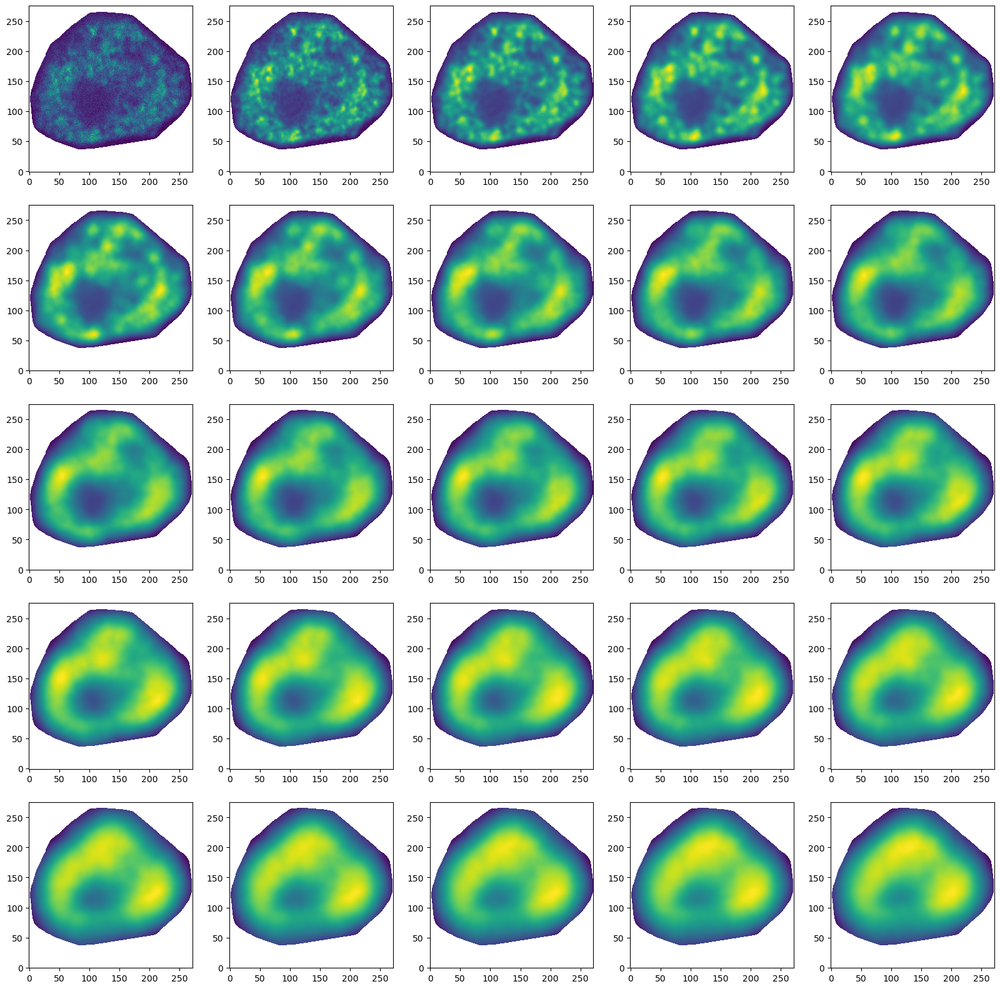

In [36]:
fig, ax = plt.subplots(5,5, figsize=(20,20))

image = images[10].copy()
image[image == -1] = np.nan
for i in tqdm(range(5**2)):
    axi = np.unravel_index(i, (5,5))
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter=None, normalization=True)
    ax[axi].imshow(filtered_image, cmap='viridis', origin='lower')

100%|██████████| 25/25 [00:12<00:00,  1.98it/s]


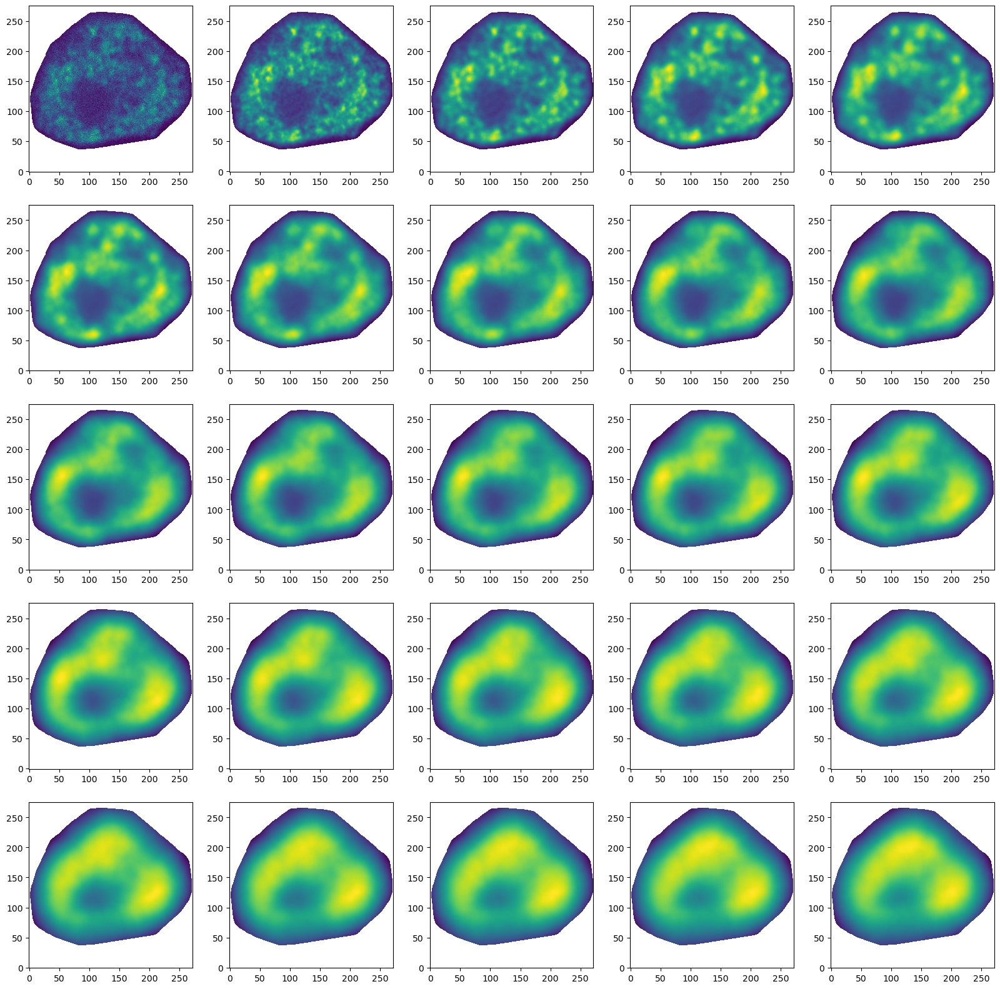

In [ ]:
fig, ax = plt.subplots(5,5, figsize=(20,20))

for i in tqdm(range(5**2)):
    axi = np.unravel_index(i, (5,5))
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter=None, normalization=True)
    ax[axi].imshow(filtered_image, cmap='viridis', origin='lower')

In [6]:
img = images[100].copy()
img[img == -1] = np.nan
print(np.nansum(img), np.shape(img))

180243.0 (196, 224)


In [76]:
from gudhi import CubicalComplex
from skimage.measure import regionprops

results = []

for img in tqdm(images):
    for region in regionprops(label(img >= 0)):
        radius_img = region.feret_diameter_max
        break

    results_tmp = []
    radius_img = np.ceil(region.feret_diameter_max/2)
    for radii in tqdm(np.linspace(0.1, 1, 9, endpoint=False)):
        radius = radius_img * radii

        tmp = sum_within_disk(img, radius, adjust_filter=None).astype(np.float64)
        tmp0 = tmp.copy()
        tmp0[np.isnan(tmp0)] = 0
        tmp0 = MinMaxScaler(feature_range=(0, np.nansum(img))).fit_transform(tmp0.reshape(-1, 1)).reshape(tmp0.shape)
        tmp0[np.isnan(tmp)] = -1
        
        cc = CubicalComplex(top_dimensional_cells=-tmp0)
        cc.compute_persistence()
        tmparr = []
        for dimi in range(2):
            tmpres = cc.persistence_intervals_in_dimension(dimi)
            if tmpres.size != 0:
                tmpres = np.hstack([radii * np.ones((tmpres.shape[0], 1)), dimi * np.ones((tmpres.shape[0], 1)), tmpres])
                tmparr.append(tmpres)
        if len(tmparr) != 0:
            results_tmp.append(np.vstack(tmparr))
    results.append(np.vstack(results_tmp))

100%|██████████| 190/190 [2:17:55<00:00, 43.55s/it]


In [78]:
results2 = results.copy()

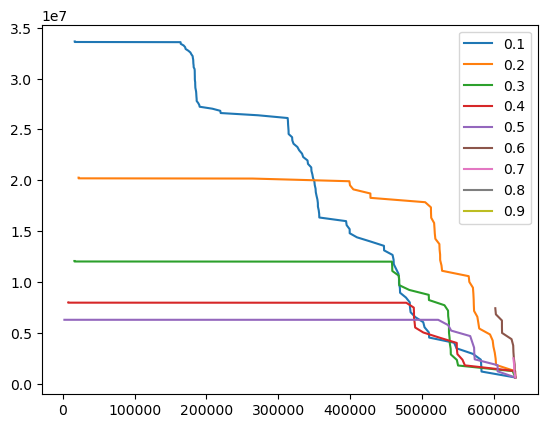

In [ ]:
fig, ax = plt.subplots(1,1)
for radius in np.unique(tmpplot[:,0]):
    xy = tmpplot[tmpplot[:,0] == radius]
    pers = np.sort(np.abs(xy[:,1] - xy[:,2]))[::-1]
    cumsum = np.cumsum(pers)
    ax.plot(pers, cumsum, label=f"{radius:0.1f}")
ax.legend()

In [137]:
for region in regionprops(label(img >= 0)):
    radius_img = region.feret_diameter_max
    break

In [141]:
region.centroid

(139.8931111986468, 141.58122668396783)

### radial representation

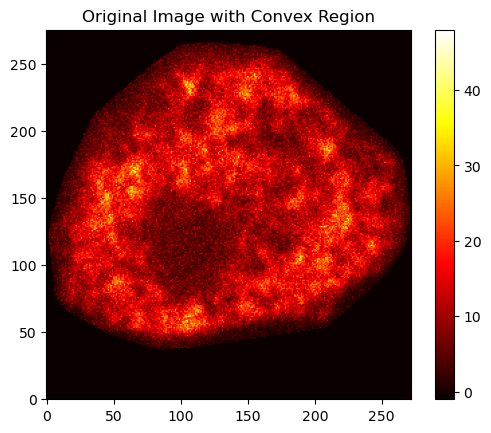

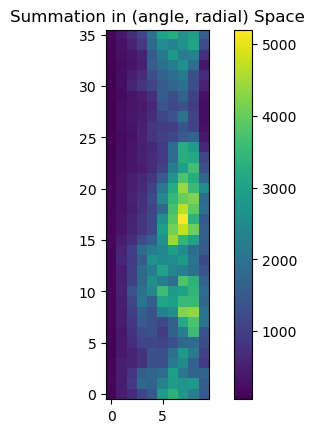

In [145]:
import numpy as np
import shapely.geometry as geom
import shapely.ops as ops

def radial_boundary_distances(mask, center):
    """
    For a convex region specified by 'mask' (True inside, False outside)
    and a center (cx, cy), compute R(theta) for angles from 0 to 2pi.
    """
    # We'll sample angles at high resolution or find the boundary directly.
    # For a quick approach, sample angles in small steps:
    cx, cy = center
    n_angles = 360  # or more for better precision
    Rvals = []
    for i in range(n_angles):
        theta = 2*np.pi * i / n_angles
        # Ray-cast outward from center until exiting mask
        r = 0.0
        while True:
            x = int(np.round(cx + r*np.cos(theta)))
            y = int(np.round(cy + r*np.sin(theta)))
            # break if we leave the mask or the image boundary
            if (x<0 or x>=mask.shape[1] or y<0 or y>=mask.shape[0] or not mask[y, x]):
                # r-1 step is last valid
                break
            r += 1
        Rvals.append(r-1)  # store the largest valid radius
    return np.array(Rvals)

def map_to_original_space(rho, theta, Rvals, center):
    """
    Given a fraction rho in [0,1], angle index (theta_index),
    radial boundary distances Rvals, and center=(cx,cy),
    returns the (x,y) in the original image coordinates.
    """
    cx, cy = center
    # Round the angle index (assuming Rvals has length n_angles)
    n_angles = len(Rvals)
    theta_index = int(theta*(n_angles/(2*np.pi)))
    # clamp for safety
    theta_index = max(0, min(n_angles-1, theta_index))
    R = Rvals[theta_index]
    r = rho * R
    x = cx + r*np.cos(theta)
    y = cy + r*np.sin(theta)
    return (x, y)

def polygon_in_original_space(alpha1, alpha2, rho1, rho2, Rvals, center):
    """
    Return shapely Polygon of the patch in the original coordinates 
    defined by angles alpha1->alpha2 and radii rho1->rho2.
    alpha1,alpha2 in radians, 0 <= alpha1<alpha2<2*pi
    rho1,rho2 in [0,1], rho1<rho2
    """
    # corners in polar
    # (rho1, alpha1), (rho2, alpha1), (rho2, alpha2), (rho1, alpha2)
    # could break them into more segments if you want a curved boundary
    pts = []
    for (rho, alpha) in [(rho1, alpha1), (rho2, alpha1), (rho2, alpha2), (rho1, alpha2)]:
        x, y = map_to_original_space(rho, alpha, Rvals, center)
        pts.append((x,y))
    return geom.Polygon(pts)

def sum_over_polygon(poly, image):
    """
    Sum the values of 'image' overlapped by shapely Polygon 'poly', 
    weighting by intersection area. 
    Assume image pixels are from (x, x+1) horizontally, (y, y+1) vertically.
    """
    x_min, y_min, x_max, y_max = poly.bounds
    # We'll only iterate over integer pixel coordinates that fall within the bounding box
    sum_val = 0.0
    for px in range(int(np.floor(x_min)), int(np.ceil(x_max))):
        for py in range(int(np.floor(y_min)), int(np.ceil(y_max))):
            if (0 <= px < image.shape[1]) and (0 <= py < image.shape[0]):
                pixel_val = image[py, px]
                # Create polygon for pixel
                pixel_poly = geom.Polygon([
                    (px, py),
                    (px+1, py),
                    (px+1, py+1),
                    (px, py+1)
                ])
                intersect_area = poly.intersection(pixel_poly).area
                if intersect_area > 0:
                    sum_val += pixel_val * intersect_area
    return sum_val

def subdivide_and_sum(image, mask, center, n_lines=36, n_radial=10):
    """
    - image, mask: 2D arrays
    - center: (cx, cy)
    - n_lines: number of radial lines => dividing 2*pi into n_lines segments
    - n_radial: number of radial subdivisions from 0->1
    Returns a 2D array sums[i, j] = sum in patch with angle i, radial j
    """
    # 1) Precompute boundary distances
    Rvals = radial_boundary_distances(mask, center)  # shape ~ (360,)

    # 2) For each patch, sum up the intensities
    sums = np.zeros((n_lines, n_radial))
    dtheta = 2*np.pi / n_lines
    drho = 1.0 / n_radial

    for i in range(n_lines):
        alpha1 = i * dtheta
        alpha2 = (i+1) * dtheta
        for j in range(n_radial):
            rho1 = j * drho
            rho2 = (j+1) * drho
            patch_poly = polygon_in_original_space(alpha1, alpha2, rho1, rho2, Rvals, center)
            patch_sum = sum_over_polygon(patch_poly, image)
            sums[i, j] = patch_sum
    return sums

# ---------------------------------------------------------
# Example usage
import matplotlib.pyplot as plt

# 1) Create synthetic image + mask
image = images[10]
mask = image > -1

for region in regionprops(label(mask)):
    radius_img = region.feret_diameter_max
    center = (np.array(region.centroid)+0.5).astype(np.int32)
    break

# 2) Subdivide & sum
sums = subdivide_and_sum(image, mask, center, n_lines=36, n_radial=10)

# sums is now a 36x10 array, where sums[i,j] is the total image intensity 
# mapped to that patch in the unit circle.

plt.imshow(image, cmap='hot', origin='lower')
plt.title("Original Image with Convex Region")
plt.colorbar()
plt.show()

plt.imshow(sums, cmap='viridis', origin='lower')
plt.title("Summation in (angle, radial) Space")
plt.colorbar()
plt.show()

In [162]:
def sort_sums(sums):
    rowmax = np.argmax(np.sum(sums, axis=1))
    newsums = np.roll(sums, -rowmax, axis=0)
    if np.sum(newsums[:10]) < np.sum(newsums[-10:]):
        newsums = np.roll(newsums, -1, axis=0)[::-1]
    return(newsums)

In [148]:
radial_sums = []
for image in tqdm(images):
    mask = image > -1

    for region in regionprops(label(mask)):
        radius_img = region.feret_diameter_max
        center = (np.array(region.centroid)+0.5).astype(np.int32)
        break

    # 2) Subdivide & sum
    radial_sums.append(subdivide_and_sum(image, mask, center, n_lines=36, n_radial=10))
# radial_sums = np.array(radial_sums)

  2%|▏         | 4/190 [00:13<10:17,  3.32s/it]/opt/anaconda3/envs/conda_nuclei_311/lib/python3.11/site-packages/shapely/set_operations.py:131: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
100%|██████████| 190/190 [07:33<00:00,  2.39s/it]


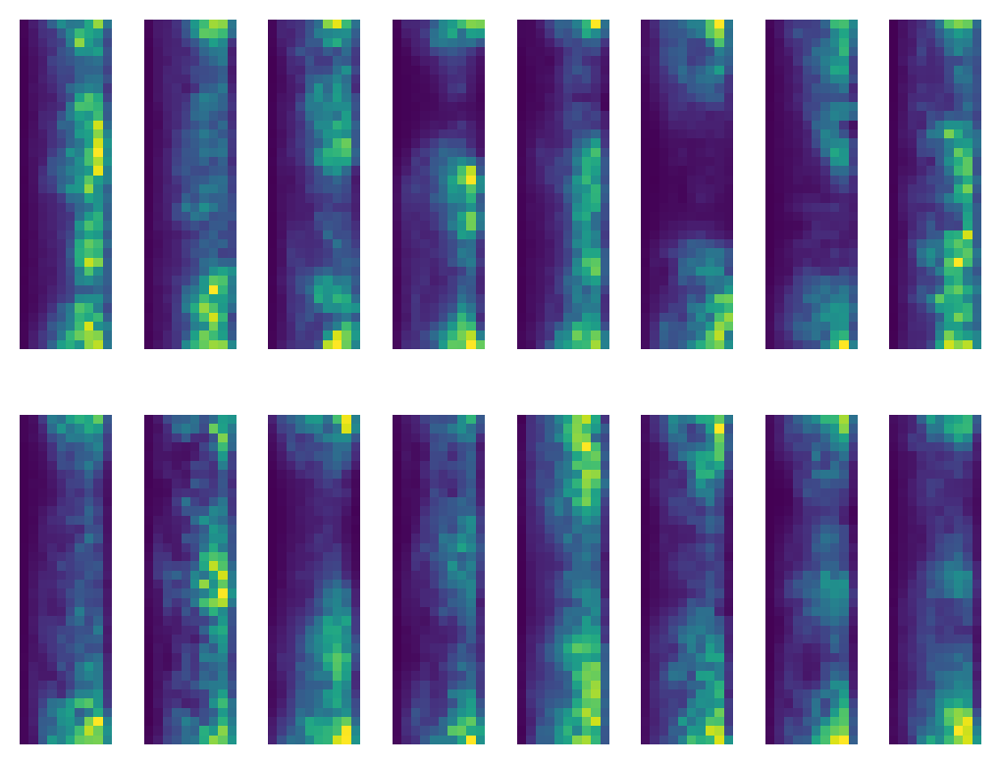

In [182]:
fig, ax = plt.subplots(2,8, dpi=200)
es = np.where(le==0)[0]
ns = np.where(le==1)[0]

newsums = [sort_sums(sums)/np.sum(sums) for sums in radial_sums]

for i in range(8):
    ax[0,i].imshow(newsums[es[i]]/np.sum(newsums[es[i]]), cmap='viridis', origin='lower')
    ax[0,i].axis('off')
    ax[1,i].imshow(newsums[ns[i]]/np.sum(newsums[ns[i]]), cmap='viridis', origin='lower')
    ax[1,i].axis('off')

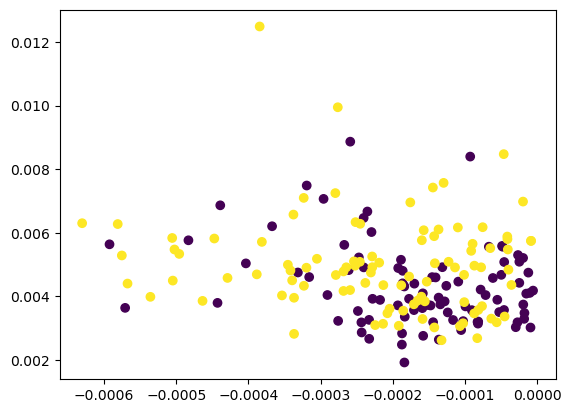

In [191]:
newsums = [sort_sums(sums)/np.sum(sums) for sums in radial_sums]
# X = np.array([x.ravel() for x in newsums])
X = np.array([np.sum(x, axis=1) for x in newsums])

# fig, ax = plt.subplots(2,2)
# fig, ax = plt.subplots(1,2, sharey=True)

# for i, x in enumerate(X):
    # ax[0, le[i]].plot(x)
    # ax[1, le[i]].scatter(np.quantile(x, 0.5), np.std(x))
    # ax[0, le[i]].plot(np.diff(x))
    

fig, ax = plt.subplots(1,1)
xvals = np.array([np.mean(np.diff(x)) for x in X])
yvals = np.array([np.std(np.diff(x)) for x in X])
ax.scatter(xvals, yvals, c=le)

In [190]:
np.shape(X)

(190, 36)

In [170]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

newsums = [sort_sums(sums)/np.sum(sums) for sums in radial_sums]
# X = np.array([x.ravel() for x in newsums])
X = np.array([np.sum(x, axis=0) for x in newsums])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, le, test_size=0.2, random_state=42)

# Create a random forest classifier
clf = RandomForestClassifier()

# Train the classifier
clf.fit(X_train, y_train)

# Make predictions
y_pred = clf.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:")
print(report)
RandomForestClassifier().fit(X, le)

Accuracy: 0.7894736842105263
Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.78      0.78        18
           1       0.80      0.80      0.80        20

    accuracy                           0.79        38
   macro avg       0.79      0.79      0.79        38
weighted avg       0.79      0.79      0.79        38



RandomForestClassifier()

### further


In [117]:
threshold_persistence = 1000
radii = np.linspace(0.1, 1, 9, endpoint=False)
size_radii = 9

evaluation = np.zeros([len(results2), 2*size_radii])
for i, res in enumerate(results2):
    tmpres = res[res[:, 1] == 0]
    for j, radius in enumerate(radii):
        tmpresrad = tmpres[tmpres[:, 0] == radius]
        evaluation[i, j] = np.count_nonzero(np.abs(tmpresrad[:, 2] - tmpresrad[:, 3]) > threshold_persistence)
    
    tmpres = res[res[:, 1] == 1]
    for j, radius in enumerate(radii):
        tmpresrad = tmpres[tmpres[:, 0] == radius]
        evaluation[i, j+size_radii] = np.count_nonzero(np.abs(tmpresrad[:, 2] - tmpresrad[:, 3]) > threshold_persistence)

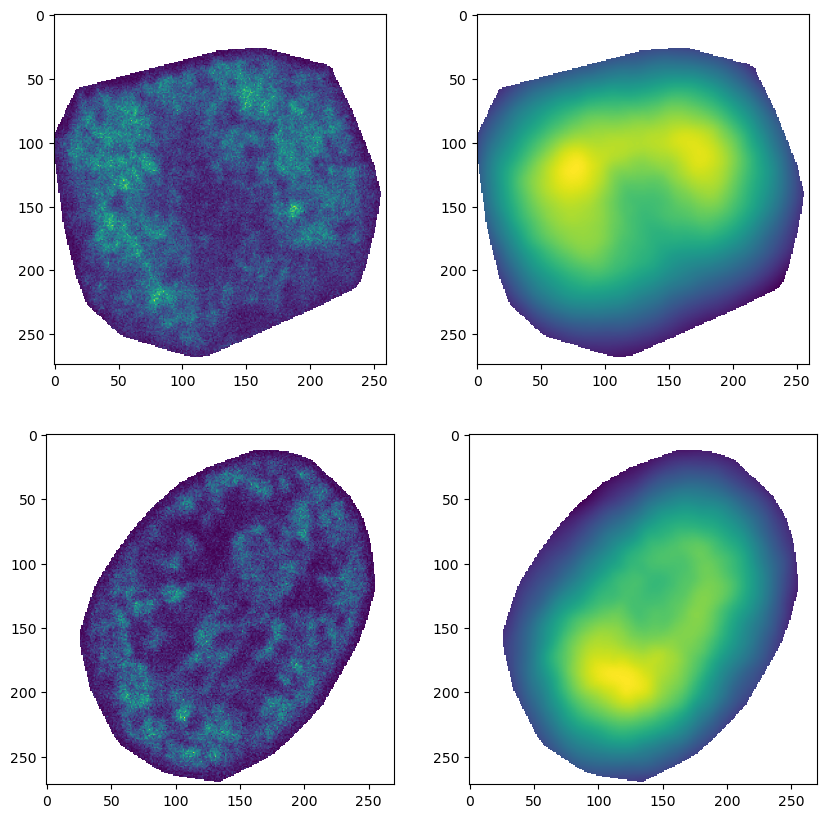

In [135]:
fig, ax = plt.subplots(2, 2, figsize=(10,10))

es = np.where(le==0)[0]
ns = np.where(le==1)[0]

for i, imgorg in enumerate([images[es[1]], images[ns[1]]]):
    img = imgorg.copy()
    img[img == -1] = np.nan

    for region in regionprops(label(img >= 0)):
        radius_img = region.feret_diameter_max / 2
        break

    filtered_img = sum_within_disk(img, 0.5*radius_img, adjust_filter=None)
    ax[i,0].imshow(img)
    ax[i,1].imshow(filtered_img)

(0.0, 20.0)

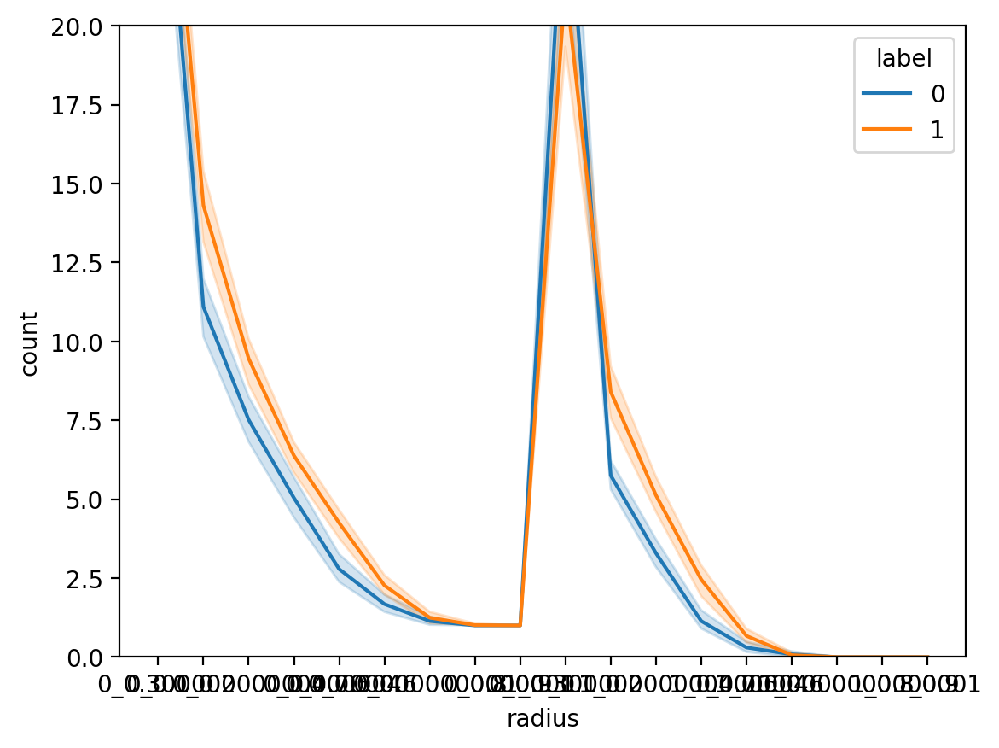

In [118]:
df = pd.DataFrame(evaluation, columns=[f"0_{i}" for i in radii] + [f"1_{i}" for i in radii])
df.loc[:, 'label'] = le

df_plot = df.melt(id_vars='label', var_name='radius', value_name='count')

fig, ax = plt.subplots(1,1,dpi=200)
sns.lineplot(data=df_plot, x='radius', y='count', hue='label', errorbar=('ci', 100), ax=ax)
ax.set_ylim([0,20])

100%|██████████| 25/25 [00:22<00:00,  1.11it/s]


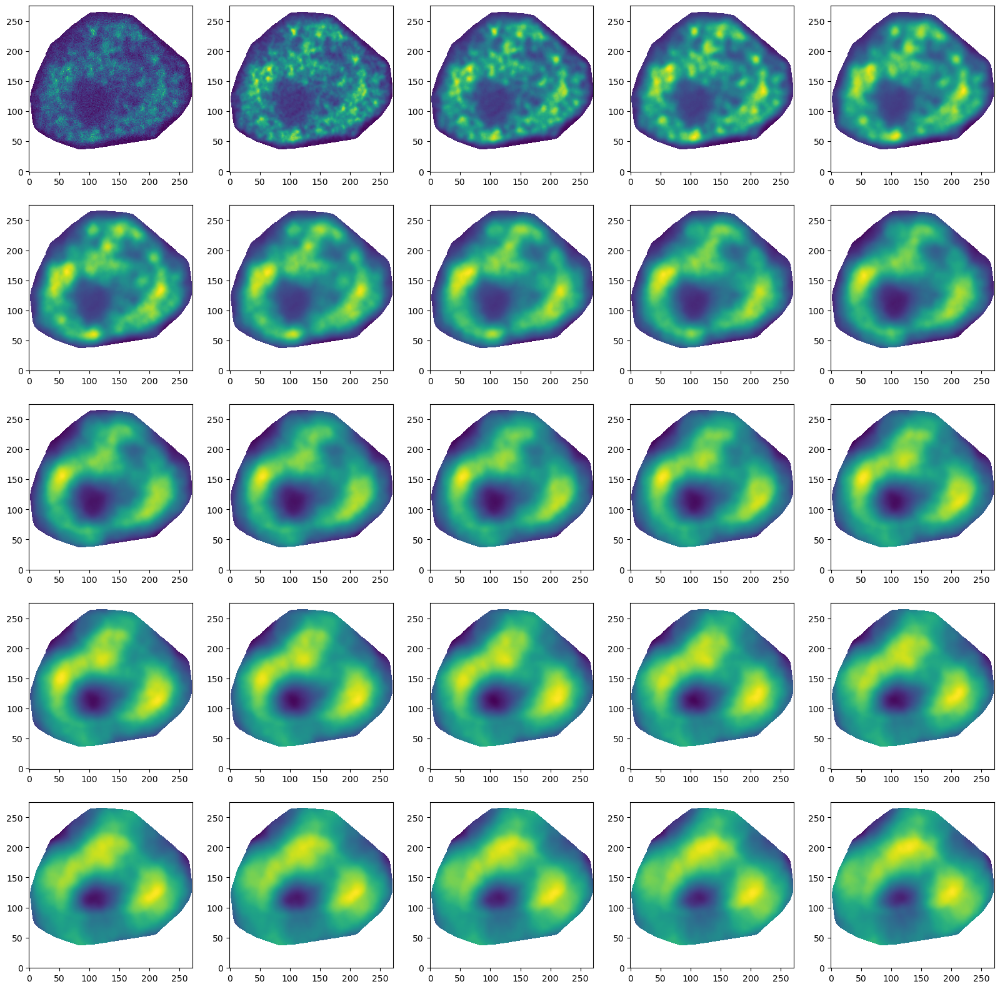

In [42]:
fig, ax = plt.subplots(5,5, figsize=(20,20))
for i in tqdm(range(5**2)):
    axi = np.unravel_index(i, (5,5))
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter='nan')
    ax[axi].imshow(filtered_image, cmap='viridis', origin='lower')

In [52]:
# Ripley's K-function
def ripley_k(points, mask, max_radius, num_radii):
    radii = np.linspace(1, max_radius, num_radii)
    k_values = np.zeros_like(radii)
    area = np.sum(mask)
    density = len(points) / area
    
    for i, radius in tqdm(enumerate(radii)):
        count = 0
        for point in points:
            distances = np.sqrt(np.sum((points - point)**2, axis=1))
            within_radius = (distances <= radius)
            for neighbor, within in zip(points[within_radius], within_radius):
                if within:
                    x, y = neighbor
                    if mask[int(x), int(y)]:
                        count += 1
        k_values[i] = count / (len(points) * density)
    
    return radii, k_values

# Convert image to points
def image_to_points(image):
    points = np.argwhere(image > 0)
    weights = image[image > 0].astype(np.int32)
    repeated_points = np.repeat(points, weights, axis=0)
    return repeated_points

100%|██████████| 25/25 [00:13<00:00,  1.79it/s]


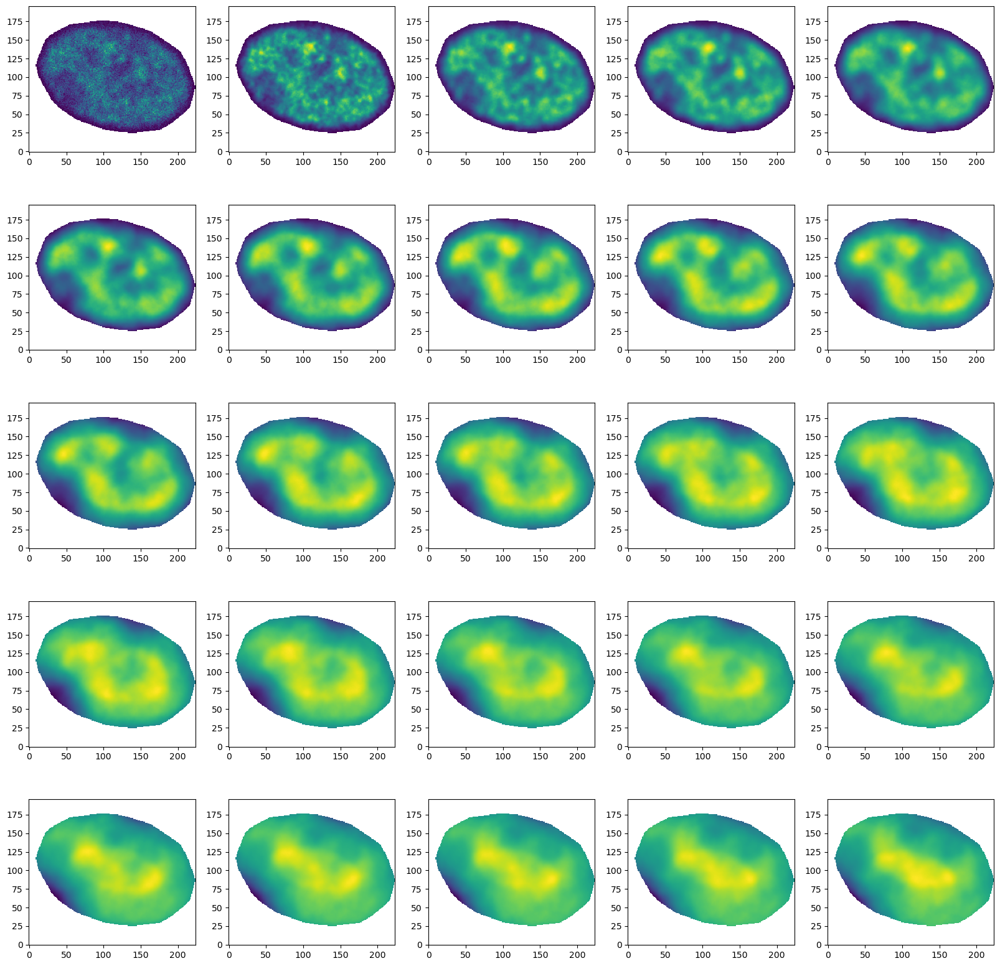

In [99]:
filtered_images = []

fig, ax = plt.subplots(5,5, figsize=(20,20))
for i in tqdm(range(5**2)):
    axi = np.unravel_index(i, (5,5))
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter='mean')
    filtered_images.append(filtered_image.copy())
    ax[axi].imshow(filtered_image, cmap='viridis', origin='lower')

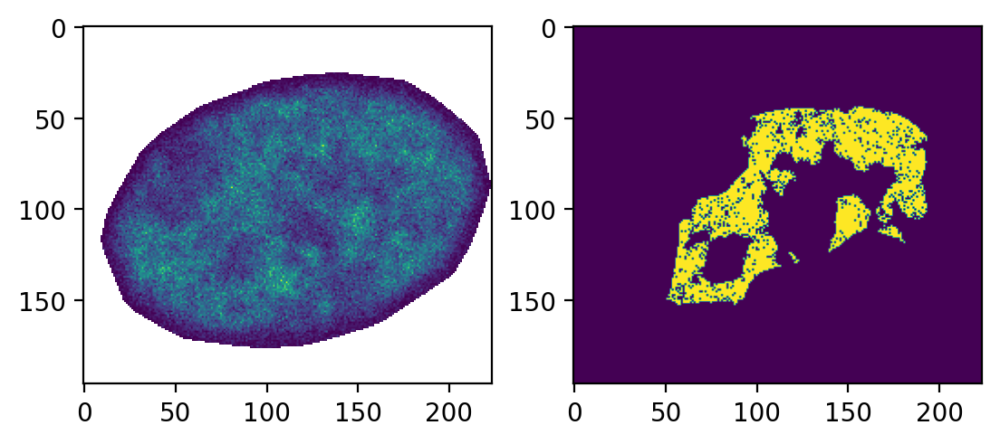

In [ ]:
for image in images:
    img = image.copy()
    img[img == -1] = np.nan

    for radii in range(50):
        radius = radii + 0.5
        filtimg = sum_within_disk(img, radius, adjust_filter='mean')
        filtimg = MinMaxScaler(feature_range=(0, np.nansum(img))).fit_transform(filtimg)

In [52]:
radius_max = []
for i in tqdm(range(50)):
    radius = i+0.5
    tmp = sum_within_disk(image, radius, adjust_filter=None)
    radius_max.append([radius, np.nanmax(tmp), np.nanmedian(tmp), np.nanmean(tmp), np.nanmin(tmp)])
radius_max = np.array(radius_max)

100%|██████████| 50/50 [00:17<00:00,  2.88it/s]


In [ ]:
radius = 2.5
radius_quantiles = []
for image in tqdm(images):
    img = image.copy()
    img[img == -1] = np.nan
    tmp = sum_within_disk(img, radius, adjust_filter=None)
    radius_quantiles.append([np.nanquantile(tmp, t) for t in np.linspace(0, 1, 11)])
radius_quantiles = np.array(radius_quantiles)
mean_radius_quantiles = np.mean(radius_quantiles, axis=0)

100%|██████████| 190/190 [00:31<00:00,  5.94it/s]


array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26])

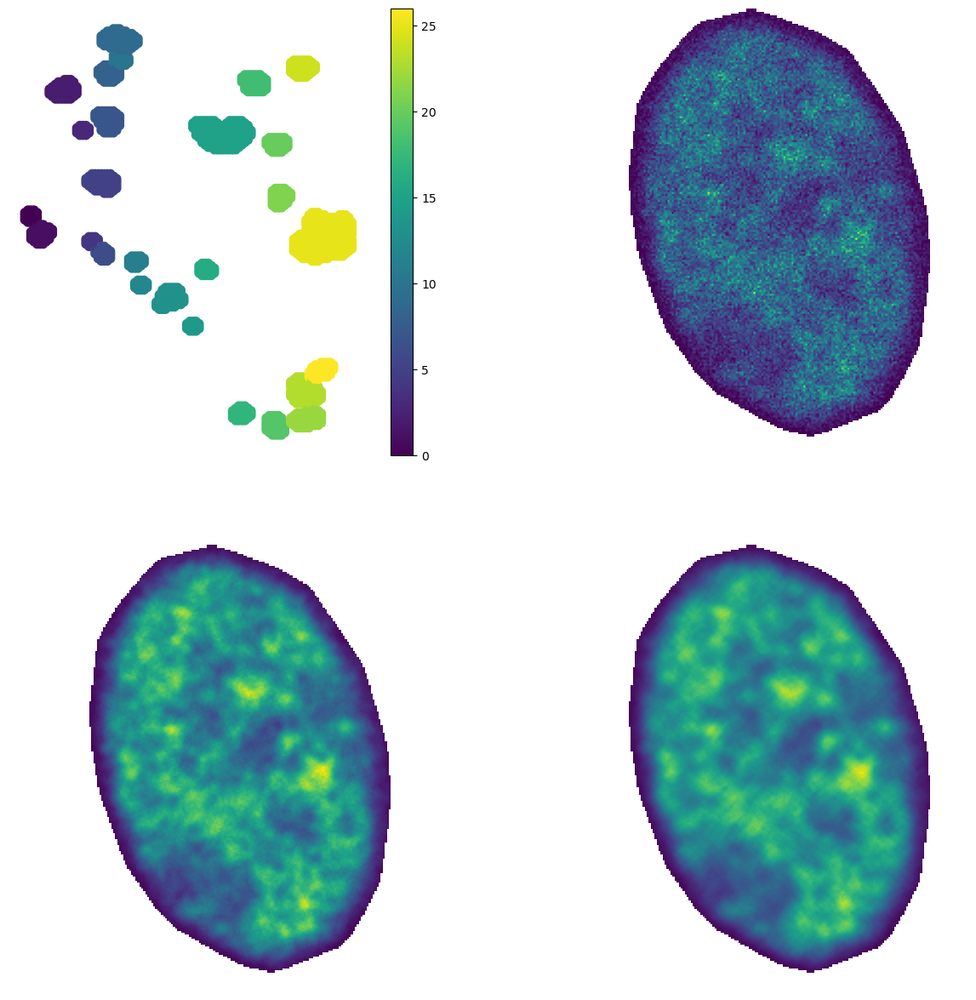

In [98]:
from sklearn.cluster import DBSCAN

image = images[100].copy()
image[image == -1] = np.nan

radius = 2.5
tmp = sum_within_disk(image, radius, adjust_filter=None)

# Apply DBSCAN clustering
data = np.argwhere(image > 0)
# data = np.repeat(data, image[image > 0].astype(np.int32), axis=0)
# data = data.astype(np.float64) + 0.5*(np.random.random(data.shape)-0.5)

dbscan = DBSCAN(eps=radius+0.2,
                min_samples=int(mean_radius_quantiles[-2]))
dbscan_clusters = dbscan.fit_predict(data, sample_weight=image[image > 0].astype(np.int32))

# Plot the clustered data
fig, ax = plt.subplots(2, 2, figsize=(15,15))
scatter = ax[0, 0].scatter(data[dbscan_clusters>-1, 0], data[dbscan_clusters>-1, 1], c=dbscan_clusters[dbscan_clusters>-1], cmap='viridis', s=50)
plt.colorbar(scatter)
ax[0, 1].imshow(image.T, cmap='viridis', origin='lower')
ax[1, 0].imshow(tmp.T, cmap='viridis', origin='lower')

ax[1, 1].imshow(sum_within_disk(image, radius+1, adjust_filter=None).T, cmap='viridis', origin='lower')
for i in range(4):
    ax[np.unravel_index(i, (2,2))].set_axis_off()

# Return the unique cluster labels
unique_labels = np.unique(dbscan_clusters)
unique_labels


100%|██████████| 25/25 [00:32<00:00,  1.28s/it]


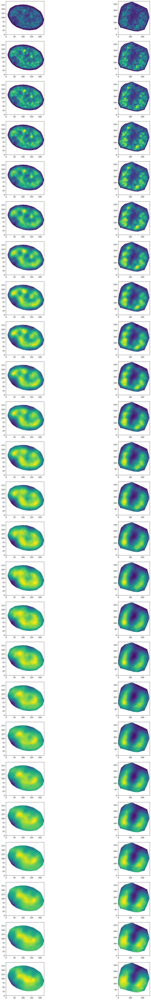

In [ ]:
image = images[100].copy()
image[image == -1] = np.nan

fig, ax = plt.subplots(25,2, figsize=(20,100))
for i in tqdm(range(5**2)):
    # axi = np.unravel_index(i, (5,5))
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter='mean')
    ax[i, 0].imshow(filtered_image, cmap='viridis', origin='lower')
image = images[1].copy()
image[image == -1] = np.nan

for i in tqdm(range(5**2)):
    # axi = np.unravel_index(i, (5,5))
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter='mean')
    ax[i, 1].imshow(filtered_image, cmap='viridis', origin='lower')

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, morphology, measure, feature
from scipy.ndimage import gaussian_filter, binary_dilation, label
from skimage.segmentation import watershed
import pywt
from scipy.ndimage import zoom
from scipy.ndimage import distance_transform_edt

def process_image(image, rolling_ball_radius=50, sigma=1.3, wavelet_levels=(2, 3), dilation_radius=2, area_range=(10, 500)):
    """
    Process a single 2D image to identify and segment protein clusters.
    
    Parameters:
        image (ndarray): 2D input image.
        rolling_ball_radius (int): Radius for rolling ball background subtraction.
        sigma (float): Sigma for Gaussian filtering.
        wavelet_levels (tuple): Levels for wavelet product computation.
        dilation_radius (int): Radius for binary map dilation.
        area_range (tuple): Min and max area for filtering clusters.
        
    Returns:
        dict: Results including binary map, labeled clusters, and cluster features.
    """
    # Step 1: Gaussian filtering
    filtered_image = gaussian_filter(image, sigma=sigma)

    # Step 2: Rolling ball background subtraction
    background = morphology.white_tophat(filtered_image, footprint=mydisk(rolling_ball_radius))
    background_removed = filtered_image - background

    # Step 3: Wavelet decomposition
    coeffs = pywt.wavedec2(background_removed, 'bior3.3', mode='symmetric', level=max(wavelet_levels))
    wavelet_planes = coeffs[1:]  # Exclude approximation coefficients

    # Compute wavelet product
    wavelet_product = None
    for k in range(wavelet_levels[0], wavelet_levels[1] + 1):
        horiz, vert, diag = wavelet_planes[k - 1]  # Decompose into sub-bands
        plane_product = np.abs(horiz) * np.abs(vert) * np.abs(diag)

        # Resize wavelet product to match original image size using interpolation
        zoom_factors = (
            background_removed.shape[0] / plane_product.shape[0],
            background_removed.shape[1] / plane_product.shape[1],
        )
        plane_product_resized = zoom(plane_product, zoom_factors, order=1)  # Bilinear interpolation

        # Initialize or combine into wavelet product
        if wavelet_product is None:
            wavelet_product = plane_product_resized
        else:
            wavelet_product *= plane_product_resized

    # Step 4: Thresholding
    threshold = filters.threshold_otsu(wavelet_product)
    binary_map = wavelet_product > threshold

    # Step 5: Binary map dilation
    dilated_map = binary_dilation(binary_map, structure=mydisk(dilation_radius))

    # Step 6: Segment clusters
    distance = distance_transform_edt(dilated_map)
    local_maxi = feature.peak_local_max(
        distance, labels=dilated_map, footprint=np.ones((3, 3)), indices=False
    )
    markers = label(local_maxi)[0]
    print(np.shape(distance), np.shape(markers), np.shape(dilated_map))
    labeled_clusters = watershed(-distance, markers, mask=dilated_map)

    # Step 7: Filter clusters by area
    properties = measure.regionprops_table(
        labeled_clusters, intensity_image=background_removed,
        properties=['label', 'area', 'mean_intensity', 'centroid']
    )
    filtered_clusters = [
        prop for prop in properties if area_range[0] <= prop['area'] <= area_range[1]
    ]

    return {
        'filtered_image': filtered_image,
        'background_removed': background_removed,
        'wavelet_product': wavelet_product,
        'binary_map': binary_map,
        'dilated_map': dilated_map,
        'labeled_clusters': labeled_clusters,
        'filtered_clusters': filtered_clusters
    }

def analyze_images(image_list, rolling_ball_radius=50, sigma=1.3, wavelet_levels=(2, 3), dilation_radius=2, area_range=(10, 500)):
    """
    Analyze a list of 2D images to identify and segment protein clusters.
    
    Parameters:
        image_list (list of ndarray): List of 2D images.
        
    Returns:
        list: List of results for each image.
    """
    results = []
    for idx, image in enumerate(image_list):
        print(f"Processing image {idx + 1}/{len(image_list)}...")
        result = process_image(
            image, rolling_ball_radius, sigma, wavelet_levels, dilation_radius, area_range
        )
        results.append(result)
    return results

# Example usage
if __name__ == "__main__":
    # Example images (replace with actual data)
    bimages = [images[10] for _ in range(3)]
    
    results = analyze_images(bimages)

    # Visualize the result for the first image
    result = results[0]
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 3, 1)
    plt.title("Original Image")
    plt.imshow(bimages[0], cmap='gray')
    plt.subplot(2, 3, 2)
    plt.title("Filtered Image")
    plt.imshow(result['filtered_image'], cmap='gray')
    plt.subplot(2, 3, 3)
    plt.title("Background Removed")
    plt.imshow(result['background_removed'], cmap='gray')
    plt.subplot(2, 3, 4)
    plt.title("Wavelet Product")
    plt.imshow(result['wavelet_product'], cmap='hot')
    plt.subplot(2, 3, 5)
    plt.title("Binary Map")
    plt.imshow(result['binary_map'], cmap='gray')
    plt.subplot(2, 3, 6)
    plt.title("Labeled Clusters")
    plt.imshow(result['labeled_clusters'], cmap='nipy_spectral')
    plt.show()

Processing image 1/3...


TypeError: peak_local_max() got an unexpected keyword argument 'indices'

 20%|██        | 5/25 [00:02<00:08,  2.35it/s]


KeyboardInterrupt: 

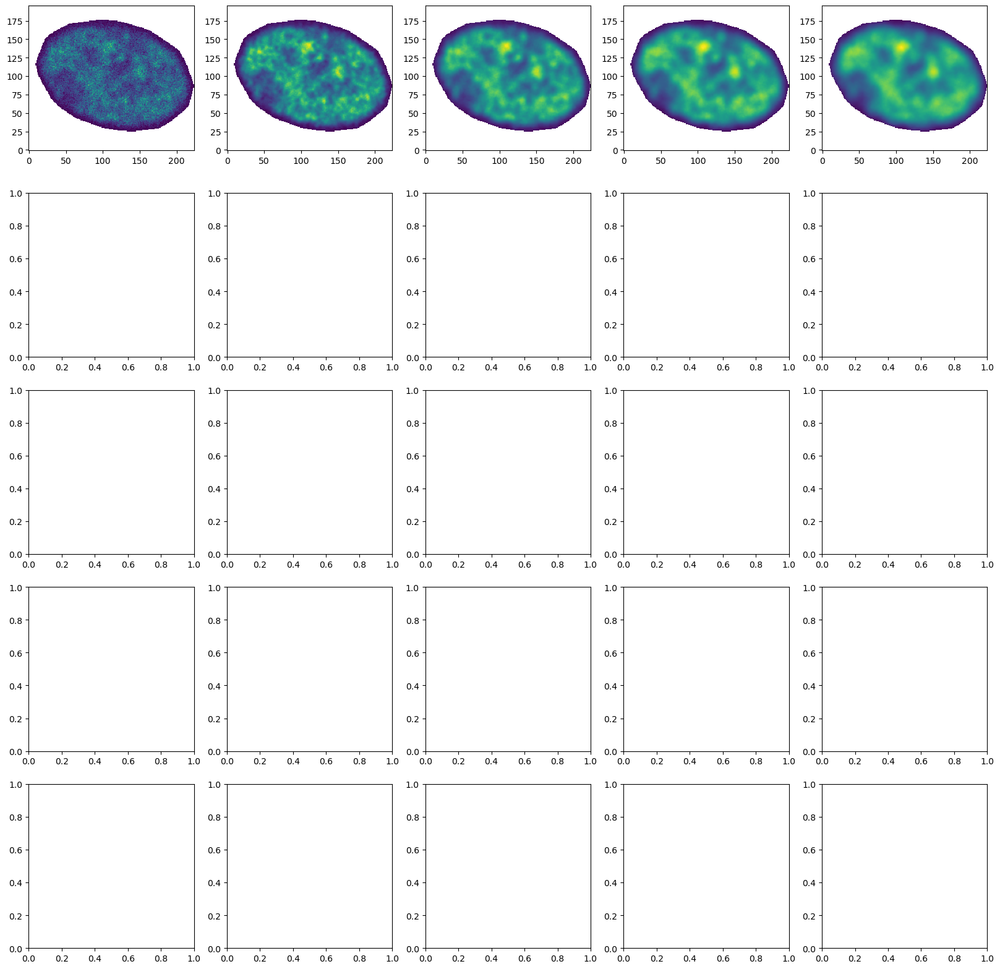

In [35]:
image = images[100].copy()
image[image == -1] = np.nan
filtered_images = []

fig, ax = plt.subplots(5,5, figsize=(20,20))
for i in tqdm(range(5**2)):
    axi = np.unravel_index(i, (5,5))
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter='mean')
    filtered_images.append(filtered_image)
    ax[axi].imshow(filtered_image, cmap='viridis', origin='lower')

In [57]:
filtered_images = []
for i in tqdm(range(5**2)):
    radius = 2*i+0.5
    filtered_image = sum_within_disk(image, radius, adjust_filter='mean')
    filtered_images.append(filtered_image)

100%|██████████| 25/25 [00:23<00:00,  1.08it/s]


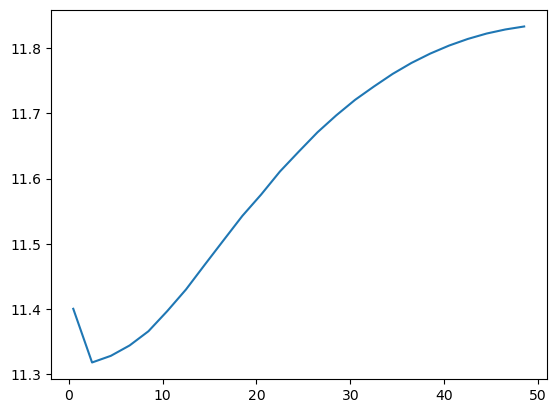

In [68]:
radii = [2*i+0.5 for i in range(5**2)]
ripley = [np.mean([x for x in fimg.ravel() if x>0]) for fimg in filtered_images]

plt.plot(radii, ripley)

In [7]:
radii = np.array([0, 2, 4, 10, 20, 40]).astype(np.float32)
radii += 0.5

ripley = []
for image in tqdm(images):
    ripley_tmp = []
    for radius in radii:
        filtered_image = sum_within_disk(image, radius, adjust_filter='mean')
        ripley_tmp.append(np.mean([x for x in filtered_image.ravel() if x>0]))
    ripley.append(ripley_tmp.copy())

100%|██████████| 190/190 [14:22<00:00,  4.54s/it]


In [11]:
df_plot

,label,radius,ripley
0,0,0.5,12.929857
1,0,0.5,12.346048
2,0,0.5,11.783730
3,0,0.5,10.323210
4,0,0.5,11.896836
...,...,...,...
1135,1,40.5,5.131969
1136,1,40.5,5.298584
1137,1,40.5,5.139595
1138,1,40.5,5.692151


<Axes: xlabel='radius', ylabel='ripley'>

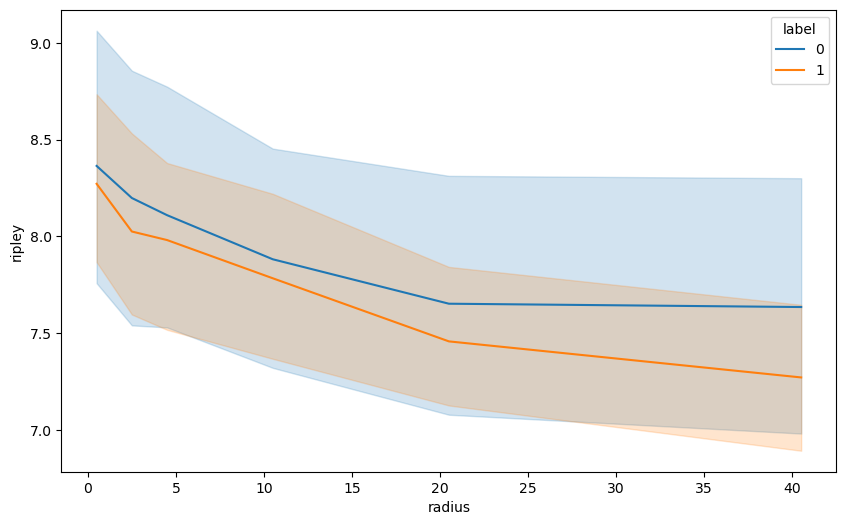

In [15]:
df_plot = pd.DataFrame(ripley, columns=radii)
df_plot['label'] = le

fig, ax = plt.subplots(figsize=(10, 6))
df_plot = df_plot.melt(id_vars='label', var_name='radius', value_name='ripley')

sns.lineplot(data=df_plot, x='radius', y='ripley', hue='label', errorbar=('ci', 99))

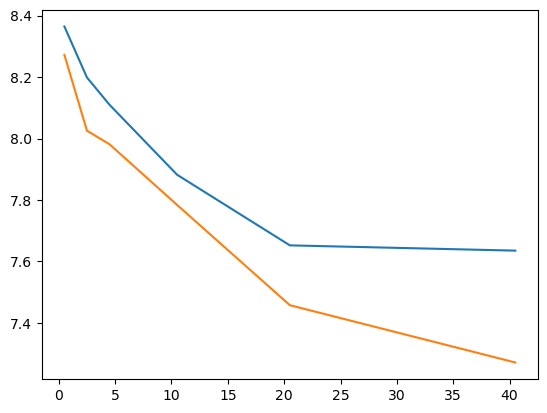

In [8]:
ripley = np.array(ripley)
plt.plot(radii, np.mean(ripley[le==0, :], axis=0))
plt.plot(radii, np.mean(ripley[le==1, :], axis=0))

### before

In [6]:
img = images[0]

points = []
for i, j in zip(*np.where(img > 0)):
    intensity = int(np.ceil(int(img[i, j])))
    if intensity <= 0:
        continue
    randomlocations = np.random.random(size=[intensity, 2])-0.5
    points.append(np.array([j, i])+randomlocations)
points = np.vstack(points)

In [89]:
clustering = DBSCAN(eps=4, min_samples=10).fit(points)
labels = clustering.labels_

In [ ]:
pointclouds = np.vstack(np.where(img > 0)).T
sampleweight = np.array([int(np.ceil(img[i, j])) for i, j in pointclouds])

# for k in tqdm(range(1, 100)):
#     for mink in tqdm(range(1, 100)):
#         clustering = DBSCAN(eps=k, min_samples=mink).fit(pointclouds, sample_weight=sampleweight)
#         labels = clustering.labels_
#         if len(np.unique(labels)) > 2:
#             print(k, mink, np.unique(labels))

In [ ]:
print(1)

[[   0    1    2    3    4    5    6    7    8    9   10   11   12   13
    14   15   16   17   18   19   20   21   22   23   24   25   26   27
    28   29   30   31   32   33   34   35   36   37   38   39   40   41
    42   43   44   45   46   47   48   49   50   51   52   53   54   55
    56   57   58   59   60   61   62   63   64   65   66   67   68   69
    70   71   72]
 [  15  296    9   21   75    9   21   15    9    9  558   54    6  526
    19  537    6    9    5    8    3    7  531  782   38   37   41   15
     9   19  410   38   21    9   14   32 1420   72    9   18   11  153
    66   17   21   21    9   77    4    8    9  227   20   22  217    9
    80   18   45    9    9  155  259   12   21  181    9   69   12   25
    37   26    8]]


(6.899999999999999, 251.1, 7.199999999999999, 244.8)

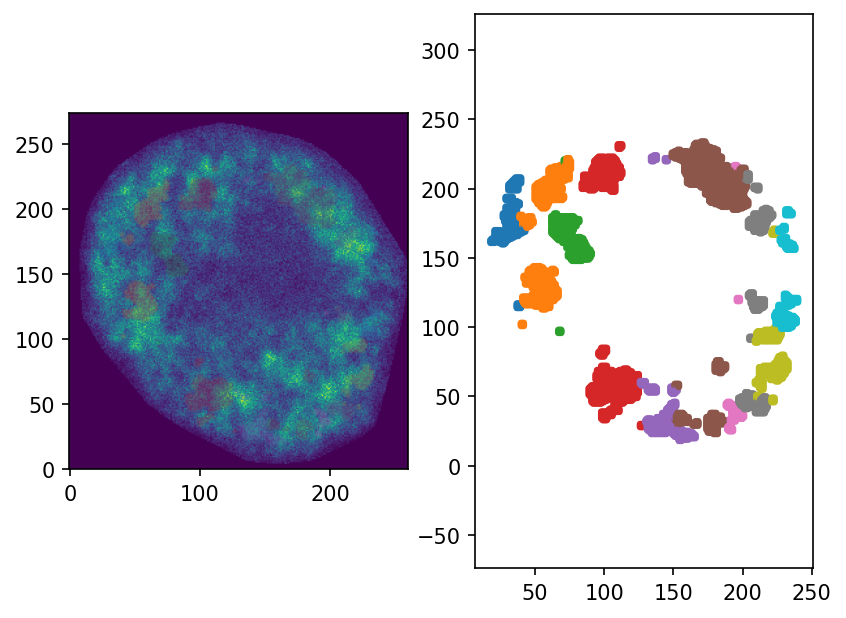

In [ ]:
clustering = DBSCAN(eps=np.sqrt(2)+0.01, min_samples=200).fit(pointclouds, sample_weight=sampleweight)
labels = clustering.labels_
print(np.vstack(np.unique(labels[labels>-1], return_counts=True)))

fig, ax = plt.subplots(1,2,dpi=150)
ax[0].imshow(img, cmap='viridis', origin='lower')
ax[0].scatter(pointclouds[labels>-1, 0], pointclouds[labels>-1, 1], c=labels[labels>-1], cmap='tab10', s=0.001, alpha=0.5)
ax[1].scatter(pointclouds[labels>-1, 0], pointclouds[labels>-1, 1], c=labels[labels>-1], cmap='tab10', s=5)
ax[1].axis('equal')

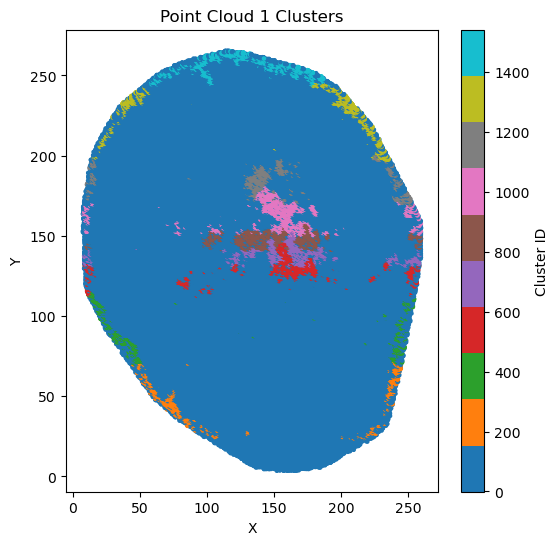

In [ ]:
from sklearn.cluster import DBSCAN, KMeans

def visualize_clusters(point_cloud, eps, min_samples, title):
    """
    Visualize clusters using DBSCAN.
    """
    clustering = DBSCAN(eps=eps, min_samples=min_samples).fit(point_cloud)
    labels = clustering.labels_
    
    plt.figure(figsize=(6, 6))
    plt.scatter(point_cloud[:, 0], point_cloud[:, 1], c=labels, cmap='tab10', s=5)
    plt.title(title)
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.colorbar(label="Cluster ID")
    plt.show()

# Example point clouds
visualize_clusters(points, eps=0.5, min_samples=5, title="Point Cloud 1 Clusters")

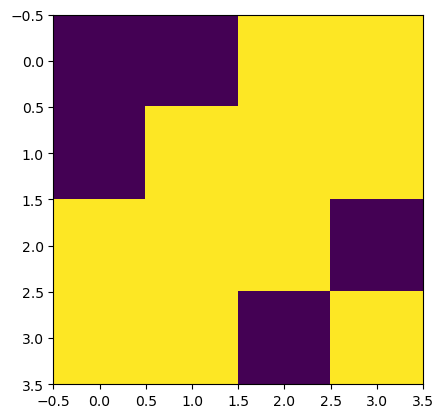

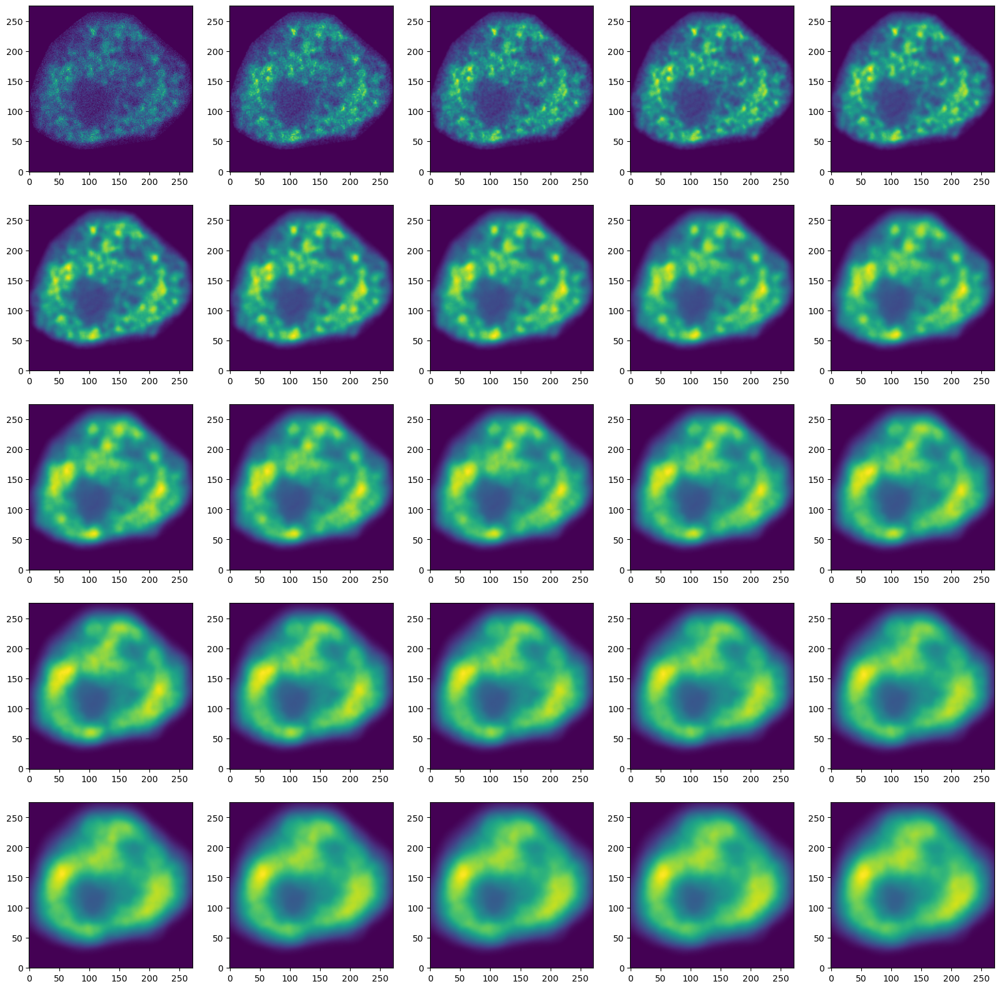

In [ ]:
fig, ax = plt.subplots(5,5, figsize=(20,20))
for i in tqdm(range(5**2)):
    axi = np.unravel_index(i, (5,5))
    radius = i
    filtered_image = sum_within_disk(image, radius)
    ax[axi].imshow(filtered_image, cmap='viridis', origin='lower')

In [7]:
from gudhi.clustering.tomato import Tomato

In [9]:
image = images[0]
indices = np.argwhere(image > 0)
values = [image[tuple(idx)] for idx in indices]

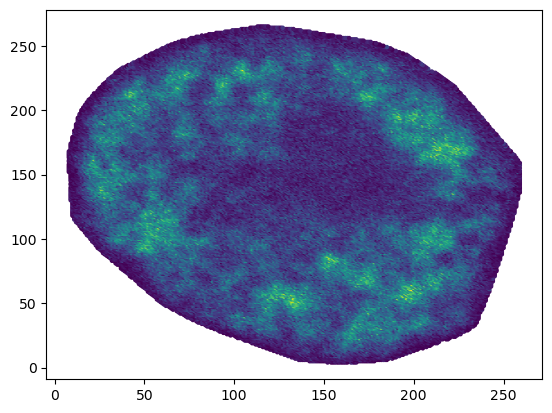

In [20]:
plt.scatter(indices[:, 1], indices[:, 0], c=values, cmap='viridis', s=5)

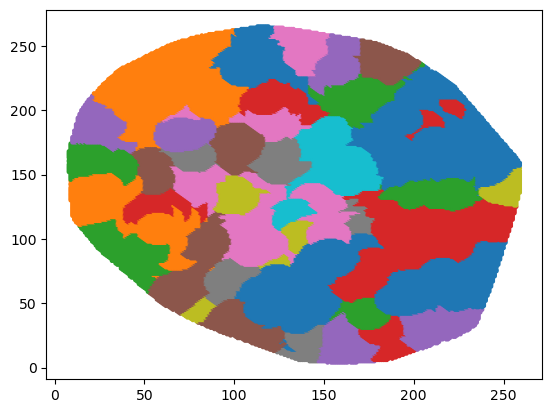

In [25]:
# tom = Tomato(density_type='manual', k=100)
# clustering = tom.fit_predict(indices, weights=values)

tom = Tomato(density_type='manual', k=500)
clustering = tom.fit_predict(indices, weights=values)
plt.scatter(indices[:, 1], indices[:, 0], c=clustering, cmap='tab10', s=5)

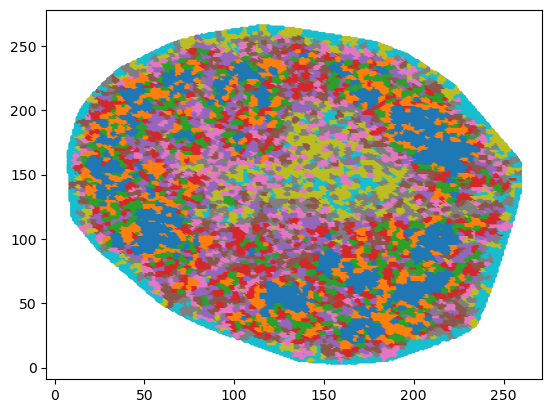

In [16]:
plt.scatter(indices[:, 1], indices[:, 0], c=clustering, cmap='tab10', s=5)

In [ ]:
from gudhi import CubicalComplex

In [184]:
pd0s = []
pd1s = []
for i in range(5**2):
    filtimg = MinMaxScaler().fit_transform(filtered_images[i].reshape(-1, 1)).reshape(filtered_images[i].shape)
    cc = CubicalComplex(top_dimensional_cells=-filtimg)
    cc.compute_persistence()
    cc.persistence_intervals_in_dimension(0)
    # persistence
    cc.compute_persistence()
    pd0 = cc.persistence_intervals_in_dimension(0)
    pd0[pd0 == np.inf] = 0
    pd1 = cc.persistence_intervals_in_dimension(1)
    pd1[pd1 == np.inf] = 0
    pd0s.append(pd0)
    pd1s.append(pd1)

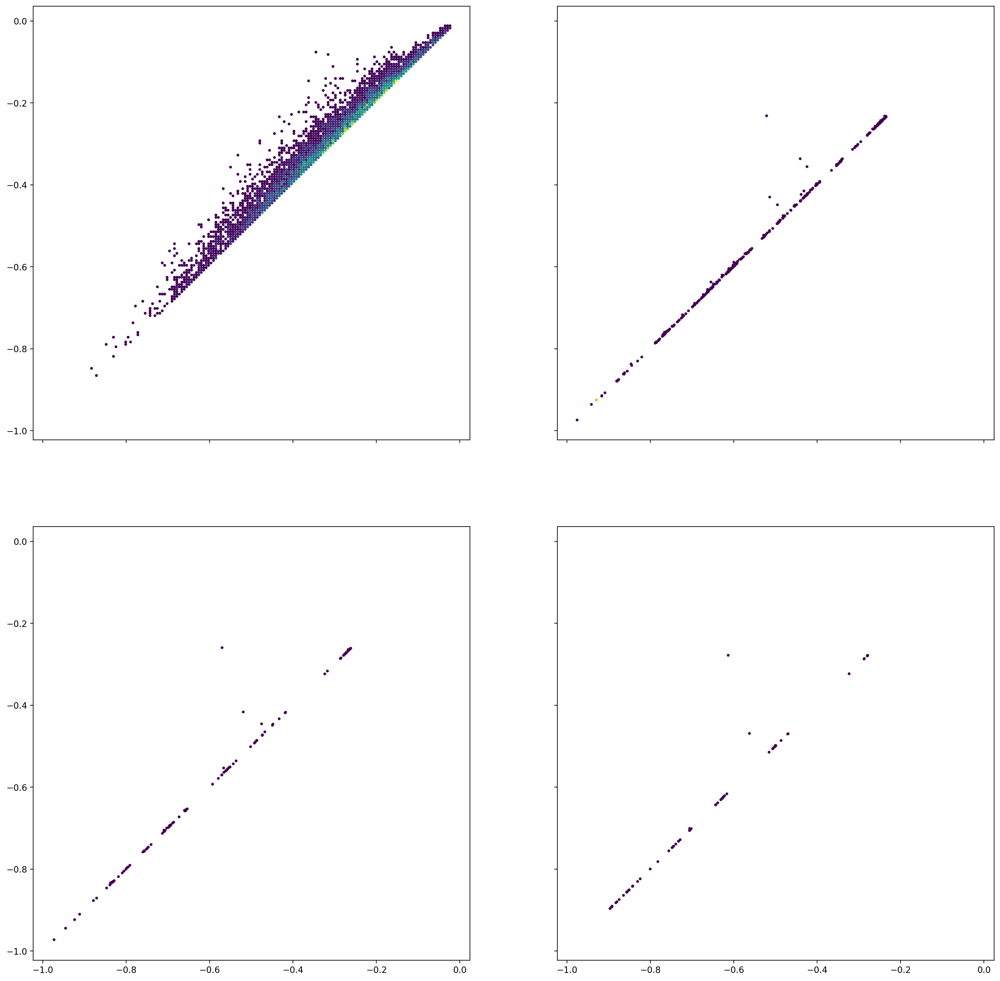

In [185]:
# fig, ax = plt.subplots(2,2, figsize=(20,20), dpi=200, sharex=True, sharey=True)
# for i in range(5**2):
    #  axi = np.unravel_index(i, (5,5))
fig, ax = plt.subplots(2, 2, figsize=(20,20), dpi=200, sharex=True, sharey=True)
for ni, i in enumerate([1, 10, 15, 20]):
    axi = np.unravel_index(ni, (2,2))
    pts, counts = np.unique(pd1s[i], return_counts=True, axis=0)
    ax[axi].scatter(pts[:,0], pts[:, 1], s=5, c=counts)

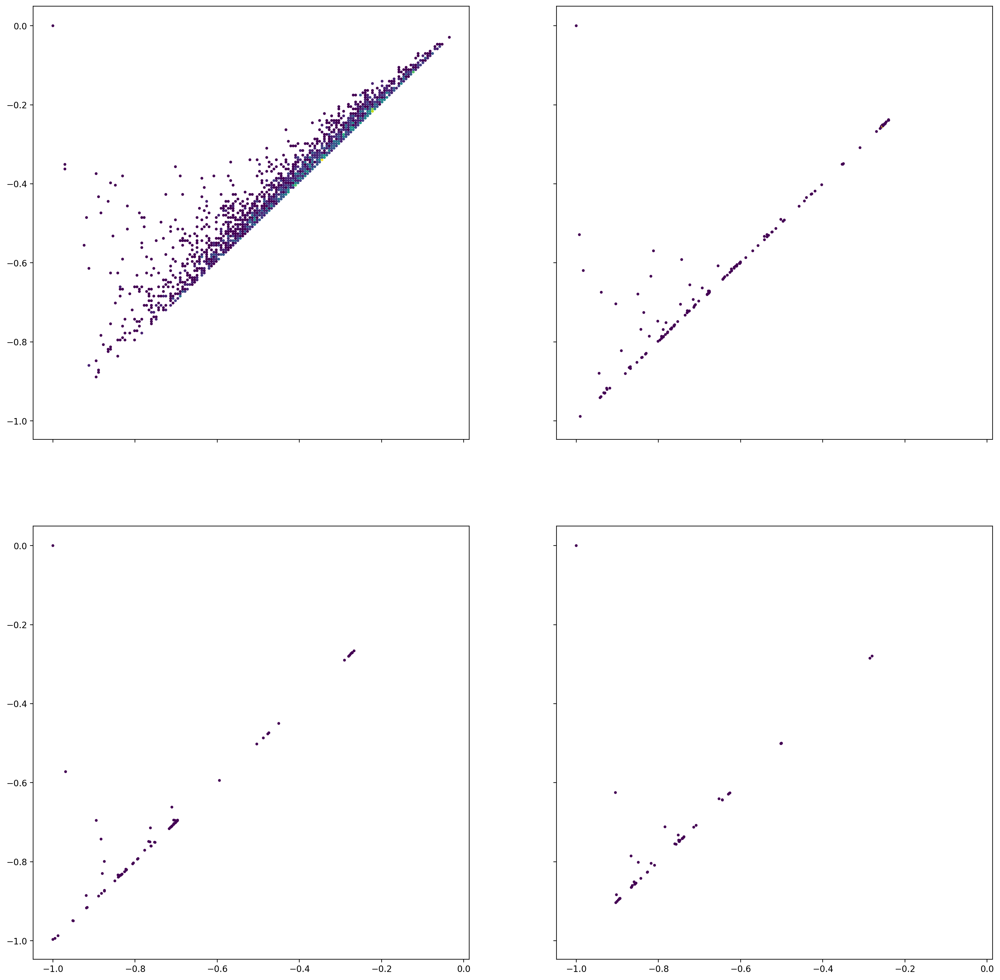

In [186]:
# fig, ax = plt.subplots(2,2, figsize=(20,20), dpi=200, sharex=True, sharey=True)
# for i in range(5**2):
    #  axi = np.unravel_index(i, (5,5))
fig, ax = plt.subplots(2, 2, figsize=(20,20), dpi=200, sharex=True, sharey=True)
for ni, i in enumerate([1, 10, 15, 20]):
    axi = np.unravel_index(ni, (2,2))
    pts, counts = np.unique(pd0s[i], return_counts=True, axis=0)
    ax[axi].scatter(pts[:,0], pts[:, 1], s=5, c=counts)

42


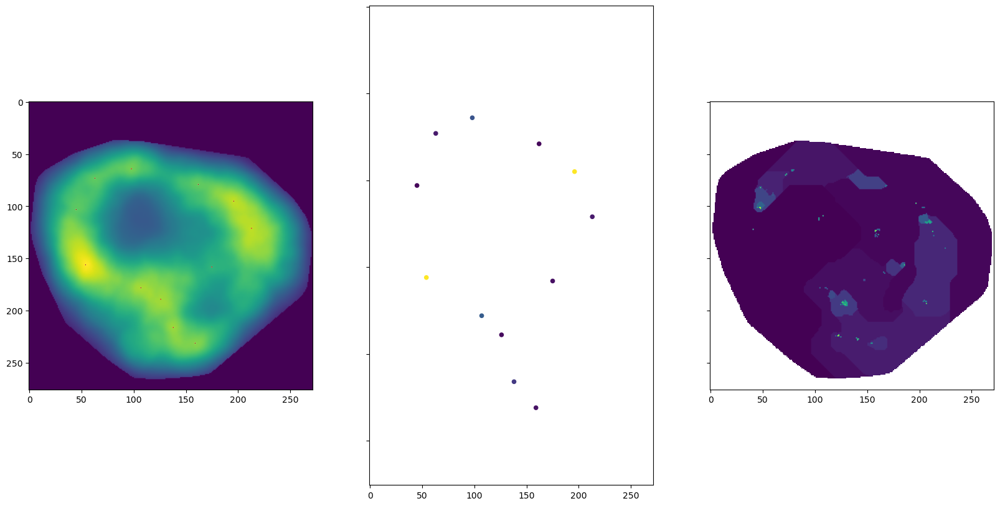

In [55]:
from gudhi import CubicalComplex

plotimg = filtered_images[20]

cc = CubicalComplex(top_dimensional_cells=-plotimg)
cc.compute_persistence()
cofaces = cc.cofaces_of_persistence_pairs()
indices_birth = \
    [np.unravel_index(x[0], np.shape(plotimg),  order='F') for x in cofaces[0][0]] \
    + [np.unravel_index(cofaces[1][0][0], np.shape(plotimg),  order='F')]

mask = np.zeros_like(plotimg)
for coord in indices_birth:
    mask[coord] = 1

pers0 = cc.persistence_intervals_in_dimension(0)
pers0[pers0 == np.inf] = -np.min(plotimg[image >= 0])
persistencemask = np.full(np.shape(plotimg), np.nan)
for coordi, coord in enumerate(indices_birth):
    persistencemask[coord] = np.abs(pers0[coordi][1] - pers0[coordi][0])

npindices_birth = np.array(indices_birth)
pers_values = np.abs(pers0[:, 1] - pers0[:,0])

print(np.sum(pers_values < 100))

# now make the descending manifold segmentation
descending_manifolds = [compute_descending_manifold(plotimg, xy)
                        for xyi, xy in enumerate(npindices_birth[np.argsort(pers_values)[::-1], :])]
# now add the newer manifolds from first to last with no overwrite
dscman_mask = np.zeros_like(plotimg)
for dsci, dscman in enumerate(descending_manifolds):
    dscman_mask[(dscman != 0) & (dscman_mask == 0) & (image >= 0)] = 1 + dsci

npindices_birth = npindices_birth[pers_values > 100]
mask[persistencemask <= 100] = 0
pers0 = pers0[pers_values > 100]
pers_values = pers_values[pers_values > 100]

# plot
fig, ax = plt.subplots(1,3, figsize=(20,10), sharex=True, sharey=True)

# ax[0].imshow(np.ma.masked_array(plotimg, plotimg <= np.percentile(plotimg, 90)), origin='lower')
ax[0].imshow(np.ma.masked_array(plotimg, image < 0), origin='lower')
ax[0].imshow(mask, vmin=0, vmax=1, cmap='Reds', alpha=(mask>0).astype(np.float32), origin='lower')

ax[1].scatter(npindices_birth[:,1], npindices_birth[:,0], s=20, c=pers_values,
              cmap='viridis', vmin=0, vmax=np.max(pers_values[:-1]))

ax[2].imshow(np.ma.masked_array(dscman_mask, dscman_mask <= 0))

PICK UP FROM HERE:

do a ballmapper, where we can either color by persistence, by their value at that point, or by their sum

In [ ]:
from python_ball_mapper.pyBallMapper import BallMapper
from matplotlib.colors import ListedColormap
from matplotlib import cm
import networkx as nx

In [ ]:
persistences0 = []
for plotimg in filtered_images:
    # plotimg = filtered_images[radius]
    cc = CubicalComplex(top_dimensional_cells=-MinMaxScaler().fit_transform(plotimg.reshape(-1, 1)).reshape(plotimg.shape))
    cc.compute_persistence()
    pers0 = cc.persistence_intervals_in_dimension(0)
    pers0[pers0 == np.inf] = -1

    persistences0.append(pers0)

bc = BettiCurve()
betti0 = bc.fit_transform(persistences0)
x = bc.grid_
fig, ax = plt.subplots(1,1, figsize=(10,10), dpi=200)
for i, y in enumerate(betti0):
    ax.plot(x[x<=0], y[x<=0], label=f'{i}')
ax.legend()

TypeError: BettiCurve.__init__() got an unexpected keyword argument 'grid'

In [42]:
# compute the bettiCurves and attach them to a long line for each image
bettistack = []
for image in tqdm(images, total=len(images)):
    persistences0 = []
    for radius in [1, 5, 9, 15, 21, 51, 76, 101]:
        # get the
        img = sum_within_disk(image, radius)
        img[(image==-1) | (np.isnan(image))] = -1
        filtered_image = img.copy()
        
        # plotimg = filtered_images[radius]
        cc = CubicalComplex(top_dimensional_cells=-MinMaxScaler().fit_transform(filtered_image.reshape(-1, 1)).reshape(filtered_image.shape))
        cc.compute_persistence()
        pers0 = cc.persistence_intervals_in_dimension(0)
        pers0[pers0 == np.inf] = 0

        persistences0.append(pers0)

    bc = BettiCurve(predefined_grid=np.linspace(-1, 0, 100))
    bettistack.append(bc.fit_transform(persistences0).ravel())

  0%|          | 0/190 [00:00<?, ?it/s]

ERROR! Session/line number was not unique in database. History logging moved to new session 1421


  3%|▎         | 5/190 [01:51<1:08:46, 22.31s/it]


DOES THIS ALREADY HELP IN DISTINGUISHING?

In [ ]:
results = []

# for image in tqdm(images, total=len(images)):
for image in images:
    persistences0 = []
    tmpres = []
    sumtotal = np.nansum(image[image > 0]) * 0.001
    # print(sumtotal)
    # for radius in [1, 5, 9, 15, 21, 51, 75, 101]:
    for radius in [75]:
        # get the
        img = sum_within_disk(image, radius)
        img[(image==-1) | (np.isnan(image))] = -1
        filtered_image = img.copy()
        
        # plotimg = filtered_images[radius]
        # cc = CubicalComplex(top_dimensional_cells=-MinMaxScaler().fit_transform(filtered_image.reshape(-1, 1)).reshape(filtered_image.shape))
        cc = CubicalComplex(top_dimensional_cells=-filtered_image)
        cc.compute_persistence()
        pers0 = cc.persistence_intervals_in_dimension(0)
        pers0[pers0 == np.inf] = 0

        persvals = np.abs(pers0[:, 1] - pers0[:, 0])
        print('__', np.shape(pers0)[0], np.sum(persvals < sumtotal), np.sum(persvals >= sumtotal))
        tmpres.append([np.shape(pers0)[0], np.sum(persvals < sumtotal), np.sum(persvals >= sumtotal)])
    results.append(tmpres)

ERROR! Session/line number was not unique in database. History logging moved to new session 1432
__ 9 7 2
__ 9 7 2
__ 3 1 2
__ 2 0 2
__ 6 3 3
__ 6 4 2
__ 5 4 1
__ 8 5 3
__ 17 15 2
__ 11 7 4
__ 9 7 2
__ 2 0 2
__ 3 1 2
__ 1 0 1
__ 15 11 4
__ 4 2 2
__ 3 1 2
__ 2 0 2
__ 6 4 2
__ 3 1 2
__ 5 3 2
__ 23 19 4
__ 8 6 2
__ 8 7 1
__ 1 0 1
__ 1 0 1
__ 5 4 1
__ 1 0 1
__ 16 14 2
__ 2 1 1
__ 1 0 1
__ 15 13 2
__ 1 0 1
__ 6 5 1
__ 1 0 1
__ 2 1 1
__ 4 2 2
__ 3 2 1
__ 1 0 1
__ 2 1 1
__ 9 7 2
__ 11 9 2
__ 19 18 1
__ 3 2 1
__ 9 7 2
__ 4 3 1
__ 9 8 1
__ 9 7 2
__ 1 0 1
__ 5 4 1
__ 3 2 1
__ 1 0 1
__ 1 0 1
__ 1 0 1
__ 3 1 2
__ 5 4 1
__ 1 0 1
__ 2 0 2
__ 2 1 1
__ 1 0 1
__ 5 3 2
__ 1 0 1
__ 9 7 2
__ 14 12 2
__ 2 0 2
__ 18 14 4
__ 9 7 2
__ 28 24 4
__ 3 1 2
__ 2 0 2
__ 1 0 1
__ 5 4 1
__ 18 15 3
__ 3 2 1
__ 2 1 1
__ 2 1 1
__ 24 22 2
__ 1 0 1
__ 1 0 1
__ 6 4 2
__ 3 2 1
__ 8 5 3
__ 1 0 1
__ 1 0 1
__ 17 15 2
__ 4 3 1
__ 7 6 1
__ 2 0 2
__ 5 4 1
__ 1 0 1
__ 11 7 4
__ 7 4 3
__ 7 5 2
__ 4 3 1
__ 11 9 2
__ 1 0 1
__ 4 2 2
__

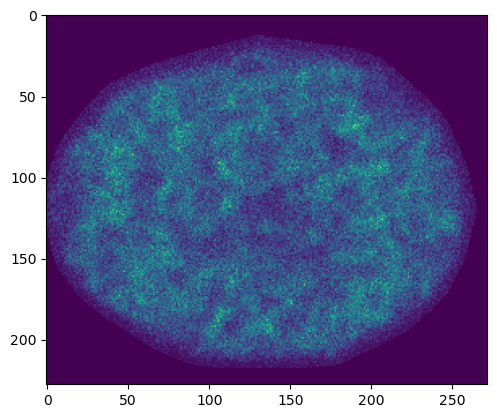

In [60]:
plt.imshow(image)

ValueError: 'c' argument has 190 elements, which is inconsistent with 'x' and 'y' with size 1.

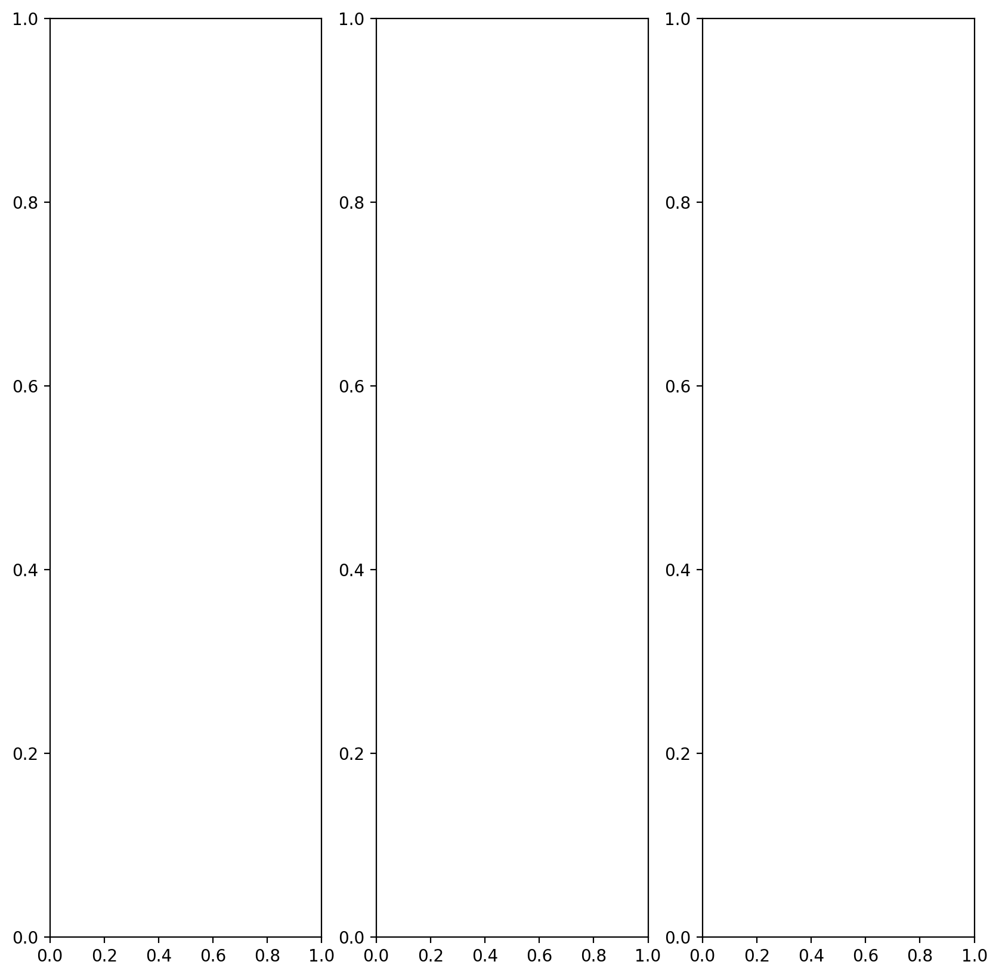

In [ ]:
tmpres = np.array(results)

x= np.arange(len(results))
fig, ax = plt.subplots(1,3, figsize=(10,10), dpi=200)
for i in range(3):
    ax[i].scatter(x, results[:,i], c=le)

ERROR! Session/line number was not unique in database. History logging moved to new session 1422


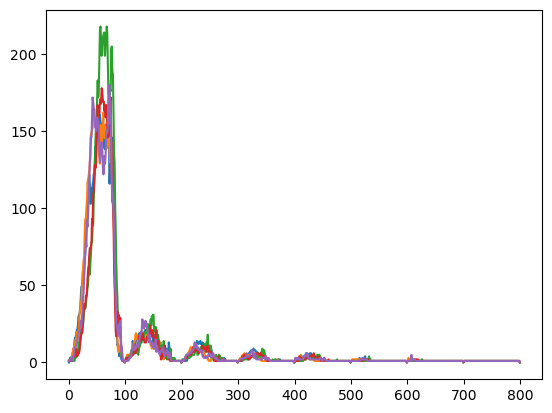

In [43]:
for bett in bettistack:
    plt.plot(bett)

/var/folders/1x/3dp0sbq930scn9c7wmp218800000gn/T/ipykernel_36364/2663465285.py:20: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  my_rainbow_palette = cm.get_cmap(name='viridis')


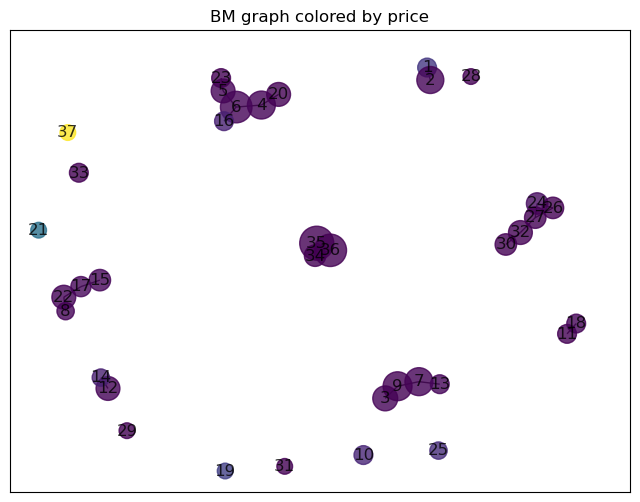

In [28]:
radius = 10
plotimg = filtered_images[radius]

cc = CubicalComplex(top_dimensional_cells=-plotimg)
cc.compute_persistence()
cofaces = cc.cofaces_of_persistence_pairs()
indices_birth = \
    [np.unravel_index(x[0], np.shape(plotimg),  order='F') for x in cofaces[0][0]] \
    + [np.unravel_index(cofaces[1][0][0], np.shape(plotimg),  order='F')]

pers0 = cc.persistence_intervals_in_dimension(0)
pers0[pers0 == np.inf] = -np.min(plotimg[image >= 0])
npindices_birth = np.array(indices_birth)
pers_values = np.abs(pers0[:, 1] - pers0[:,0])

bm = BallMapper(points = npindices_birth, # the pointcloud, as a numpy array
                coloring_df = pd.DataFrame(pers_values, columns=['persistence']), # a dataframe with the coloring functions (in this case the pointcloud itself)
                epsilon = 2*radius) # the radius of the balls

my_rainbow_palette = cm.get_cmap(name='viridis')

# we can color the graph by any column in coloring_df
bm.color_by_variable('persistence', my_rainbow_palette)

plt.figure(figsize= (8,6))

nx.draw_networkx(bm.Graph, 
                 pos=nx.spring_layout(bm.Graph, seed=42),
                 node_color = [bm.Graph.nodes[node]['color'] for node in bm.Graph.nodes],
                 node_size =  [bm.Graph.nodes[node]['size rescaled'] for node in bm.Graph.nodes],
                 alpha=0.8)

# plot a legend
sm = plt.cm.ScalarMappable(cmap = my_rainbow_palette,
                           norm = plt.Normalize(vmin=bm.min_color_value, 
                                                vmax=bm.max_color_value))
# plt.colorbar(sm)
plt.title('BM graph colored by price')
plt.show()

Text(0.5, 1.0, 'Local Maxima')

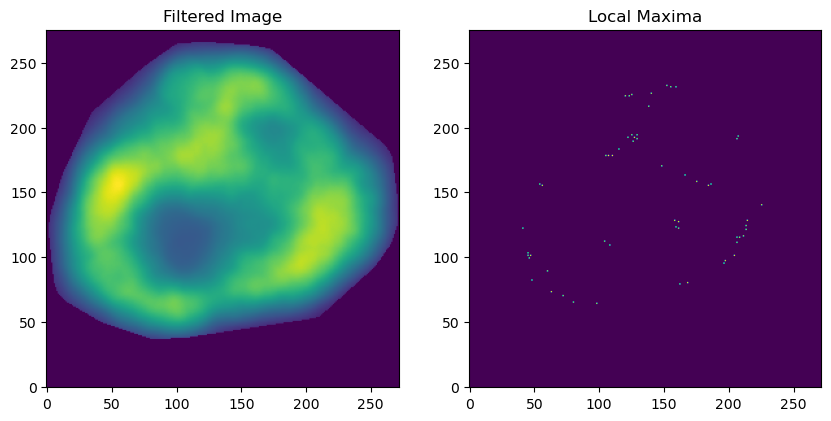

In [225]:
import numpy as np
from scipy.ndimage import maximum_filter, label

def find_local_maxima(image):
    """
    Find local maxima in a 2D image using an 8-connected neighborhood.
    
    Parameters:
        image (np.ndarray): 2D array representing the image.
        
    Returns:
        np.ndarray: A binary array where local maxima are marked with 1.
    """
    # Apply a maximum filter
    max_filtered = maximum_filter(image, footprint=mydisk(1.5), mode='constant')
    # Find local maxima by comparing the image to the maximum filter result
    local_maxima = (image == max_filtered)

    labelled, _ = label(local_maxima, structure=mydisk(1.5))
    local_maxima = np.zeros(image.shape, dtype=bool)
    for region in regionprops(labelled):
        coords = region.coords
        representant = coords[0]  # Pick the first coordinate as the representant
        local_maxima[representant[0], representant[1]] = True

    # Suppress non-maxima (usefulness depends on application)
    suppressed = (max_filtered > image.min())  # Optional: Exclude minima
    local_maxima = local_maxima & suppressed

    return local_maxima

# Example usage
fig, ax = plt.subplots(1,2, figsize=(10,5))
img = filtered_images[20]
maxima = find_local_maxima(img)
ax[0].imshow(img, cmap='viridis', origin='lower')
ax[0].set_title("Filtered Image")
ax[1].imshow(maxima, cmap='viridis', origin='lower')
ax[1].set_title("Local Maxima")

In [109]:
img0 = filtered_images[19]
maxima0 = find_local_maxima(img0)
img1 = filtered_images[20]
img1[(image == -1) | (np.isnan(image))] = -np.inf
maxima1 = find_local_maxima(img1)
img1[(image == -1) | (np.isnan(image))] = np.inf
minima1 = find_local_maxima(-img1)

In [131]:
import networkx as nx
from scipy.spatial.distance import pdist, squareform

In [226]:
stats = []
persistence1 = []
for radius in tqdm(np.arange(100)):
    if radius == 0:
        img = image.copy()
    else:
        img = sum_within_disk(image, radius)
    img[(image==-1) | (np.isnan(image))] = -1

    m0 = find_local_maxima(img)
    if radius == 0:
        stats.append([radius, np.sum(m0), np.sum(m0), np.sum(m0)])
        continue
    m0_points = np.argwhere(m0 > 0)
    G = nx.Graph()
    G.add_nodes_from(range(len(m0_points)))

    distances = squareform(pdist(m0_points))
    potential_pairs = np.vstack(np.where(distances <= radius)).T
    potential_pairs = potential_pairs[potential_pairs[:, 0] < potential_pairs[:, 1]]
    G.add_edges_from([tuple(x) for x in potential_pairs])
    ncc = nx.number_connected_components(G)

    potential_pairs = np.vstack(np.where((distances > radius) & (distances <= 2*radius))).T
    potential_pairs = potential_pairs[potential_pairs[:, 0] < potential_pairs[:, 1]]
    G.add_edges_from([tuple(x) for x in potential_pairs])
    ncc2 = nx.number_connected_components(G)

    # persistence
    cc = CubicalComplex(top_dimensional_cells=-img)
    cc.compute_persistence()
    pd0 = cc.persistence_intervals_in_dimension(0)
    pd0[pd0 == np.inf] = 0
    pd1 = cc.persistence_intervals_in_dimension(1)
    pd1[pd1 == np.inf] = 0
    persistence1.append(pd1)

    if np.shape(pd0)[0] != np.sum(m0):
        print('Mismatch: ', radius, np.shape(pd0)[0], np.sum(m0))

    stats.append([radius, np.sum(m0), ncc, ncc2])
    if ncc == 1:
        break

  2%|▏         | 2/100 [00:00<00:26,  3.70it/s]

Mismatch:  1 2165 2593


  3%|▎         | 3/100 [00:00<00:32,  3.00it/s]

Mismatch:  2 1119 1312


  4%|▍         | 4/100 [00:01<00:33,  2.86it/s]

Mismatch:  3 878 1020


  5%|▌         | 5/100 [00:01<00:33,  2.85it/s]

Mismatch:  4 547 626


  6%|▌         | 6/100 [00:02<00:33,  2.82it/s]

Mismatch:  5 430 481


  7%|▋         | 7/100 [00:02<00:34,  2.71it/s]

Mismatch:  6 320 345


  8%|▊         | 8/100 [00:02<00:33,  2.73it/s]

Mismatch:  7 253 282


  9%|▉         | 9/100 [00:03<00:33,  2.75it/s]

Mismatch:  8 233 255


 10%|█         | 10/100 [00:03<00:32,  2.77it/s]

Mismatch:  9 164 175


 11%|█         | 11/100 [00:03<00:32,  2.75it/s]

Mismatch:  10 151 166


 12%|█▏        | 12/100 [00:04<00:32,  2.73it/s]

Mismatch:  11 132 143


 13%|█▎        | 13/100 [00:04<00:32,  2.71it/s]

Mismatch:  12 109 124


 14%|█▍        | 14/100 [00:05<00:32,  2.66it/s]

Mismatch:  13 97 108


 15%|█▌        | 15/100 [00:05<00:32,  2.62it/s]

Mismatch:  14 78 87


 16%|█▌        | 16/100 [00:05<00:32,  2.57it/s]

Mismatch:  15 79 84


 17%|█▋        | 17/100 [00:06<00:32,  2.52it/s]

Mismatch:  16 71 73


 18%|█▊        | 18/100 [00:06<00:34,  2.37it/s]

Mismatch:  17 66 70


 19%|█▉        | 19/100 [00:07<00:34,  2.33it/s]

Mismatch:  18 52 55


 20%|██        | 20/100 [00:07<00:35,  2.29it/s]

Mismatch:  19 53 55


 21%|██        | 21/100 [00:08<00:35,  2.23it/s]

Mismatch:  20 54 57


 22%|██▏       | 22/100 [00:08<00:35,  2.17it/s]

Mismatch:  21 53 55


 23%|██▎       | 23/100 [00:09<00:36,  2.08it/s]

Mismatch:  22 45 49


 24%|██▍       | 24/100 [00:09<00:37,  2.01it/s]

Mismatch:  23 47 48


 25%|██▌       | 25/100 [00:10<00:38,  1.94it/s]

Mismatch:  24 45 46


 26%|██▌       | 26/100 [00:10<00:39,  1.87it/s]

Mismatch:  25 40 42


 27%|██▋       | 27/100 [00:11<00:40,  1.80it/s]

Mismatch:  26 45 47


 29%|██▉       | 29/100 [00:12<00:43,  1.62it/s]

Mismatch:  28 32 33


 31%|███       | 31/100 [00:14<00:45,  1.51it/s]

Mismatch:  30 33 34


 34%|███▍      | 34/100 [00:16<00:49,  1.34it/s]

Mismatch:  33 24 25


 41%|████      | 41/100 [00:23<01:02,  1.07s/it]

Mismatch:  40 18 19


 42%|████▏     | 42/100 [00:24<01:03,  1.10s/it]

Mismatch:  41 20 22


 43%|████▎     | 43/100 [00:26<01:08,  1.20s/it]

Mismatch:  42 21 22


 46%|████▌     | 46/100 [00:30<01:11,  1.32s/it]

Mismatch:  45 20 21


 52%|█████▏    | 52/100 [00:40<01:22,  1.73s/it]

Mismatch:  51 17 18


 53%|█████▎    | 53/100 [00:42<01:25,  1.81s/it]

Mismatch:  52 11 12


 55%|█████▌    | 55/100 [00:46<01:26,  1.92s/it]

Mismatch:  54 10 12


 58%|█████▊    | 58/100 [00:53<01:30,  2.16s/it]

Mismatch:  57 9 10


 61%|██████    | 61/100 [01:04<00:41,  1.05s/it]


### Clustering images (chatgpt)


In [7]:
image = images[0]

mask = image >= 0
points = np.argwhere(image > 0)
values = [image[tuple(p)] for p in points]

points_repetition = np.repeat(points, values, axis=0)


In [10]:
import numpy as np
from scipy.spatial import distance

def pair_correlation(points, mask, max_dist, bins):
    dists = distance.pdist(points)
    hist, bin_edges = np.histogram(dists, bins=bins, range=(0, max_dist))
    
    bin_width = bin_edges[1] - bin_edges[0]
    mask_area = np.sum(mask)  # Total area within the mask
    area = np.pi * (bin_edges[1:]**2 - bin_edges[:-1]**2)
    density = len(points) / mask_area
    pcf = hist / (area * density * len(points))
    
    return pcf, bin_edges[:-1]

# Example usage
pcf, distances = pair_correlation(points_repetition, mask, max_dist=50, bins=20)

: 

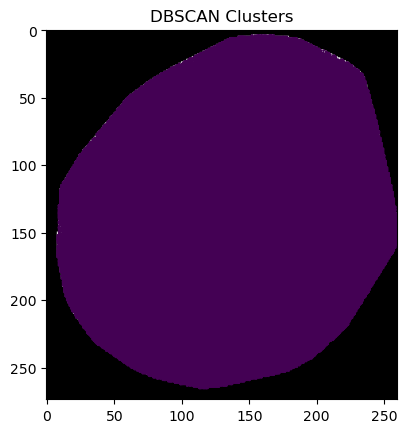

In [8]:
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt

# Perform DBSCAN
dbscan = DBSCAN(eps=5, min_samples=5).fit(points_repetition)
labels = dbscan.labels_

# Visualize clusters
plt.imshow(mask, cmap='gray')
plt.scatter(points_repetition[:, 1], points_repetition[:, 0], c=labels, cmap='viridis', s=1)
plt.title("DBSCAN Clusters")
plt.show()

In [ ]:
from scipy.spatial import cKDTree

def nearest_neighbor_distances(points, mask):
    kdtree = cKDTree(points)
    distances, _ = kdtree.query(points, k=2)  # k=2 because the first is the point itself
    return distances[:, 1]  # Skip distance to self (0 distance)

# Calculate NND
nnd = nearest_neighbor_distances(points_repetition, mask)

# Visualization of histogram
plt.hist(nnd, bins=30, edgecolor='black')
plt.title("Nearest-Neighbor Distance Distribution")
plt.xlabel("Distance")
plt.ylabel("Frequency")
plt.show()

In [ ]:
from scipy.spatial import Voronoi, voronoi_plot_2d
import matplotlib.pyplot as plt

# Compute Voronoi diagram
vor = Voronoi(points_repetition)

# Plot Voronoi diagram on the mask
plt.imshow(mask, cmap='gray')
voronoi_plot_2d(vor, show_vertices=False, show_points=False)
plt.scatter(points_repetition[:, 1], points_repetition[:, 0], s=1, c='blue')
plt.title("Voronoi Diagram")
plt.show()

In [ ]:
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt

# Perform GMM clustering
gmm = GaussianMixture(n_components=3).fit(points_repetition)
labels = gmm.predict(points_repetition)

# Visualize clusters
plt.imshow(mask, cmap='gray')
plt.scatter(points_repetition[:, 1], points_repetition[:, 0], c=labels, cmap='viridis', s=1)
plt.title("GMM Clusters")
plt.show()

In [ ]:
from sklearn.cluster import SpectralClustering
import matplotlib.pyplot as plt

# Perform Spectral Clustering
sc = SpectralClustering(n_clusters=3, affinity='nearest_neighbors', assign_labels='kmeans').fit(points_repetition)
labels = sc.labels_

# Visualize clusters
plt.imshow(mask, cmap='gray')
plt.scatter(points_repetition[:, 1], points_repetition[:, 0], c=labels, cmap='viridis', s=1)
plt.title("Spectral Clustering")
plt.show()

In [9]:
from scipy.ndimage import convolve

def radial_kernel(radius, shape):
    """
    Generates a radial kernel of given radius for convolution.
    
    Parameters:
    radius (int): Radius of the kernel.
    shape (tuple): Shape of the output kernel.
    
    Returns:
    kernel (ndarray): Radial kernel.
    """
    y, x = np.ogrid[-shape[0]//2:shape[0]//2+1, -shape[1]//2:shape[1]//2+1]
    mask = x**2 + y**2 <= radius**2
    kernel = mask.astype(float)
    kernel /= np.sum(kernel)  # Normalize
    return kernel

def radial_evolution(image, mask, max_radius, num_radii):
    """
    Performs radial kernel convolution and extracts descriptors.
    
    Parameters:
    image (ndarray): Input image.
    mask (ndarray): Binary mask for valid regions.
    max_radius (int): Maximum radius of the kernel.
    num_radii (int): Number of radii for evolution.
    
    Returns:
    radii (ndarray): Radii used for computation.
    descriptors (list): Aggregated values at each radius.
    """
    radii = np.linspace(1, max_radius, num_radii, dtype=int)
    descriptors = []
    
    for radius in tqdm(radii):
        kernel = radial_kernel(radius, image.shape)
        convolved = convolve(image * mask, kernel, mode='constant', cval=0)
        descriptor = np.sum(convolved[mask]) / np.sum(mask)
        descriptors.append(descriptor)
    
    return radii, descriptors

# Example usage
max_radius = 50
num_radii = 100
radii, descriptors = radial_evolution(image, mask, max_radius, num_radii)

# Plotting radial evolution
plt.plot(radii, descriptors, label="Radial Evolution")
plt.xlabel("Radius")
plt.ylabel("Descriptor")
plt.title("Radial Evolution of Image")
plt.legend()
plt.show()

KeyboardInterrupt: 

# Other ways (sumfilter)

0.14285714285714285 7.0


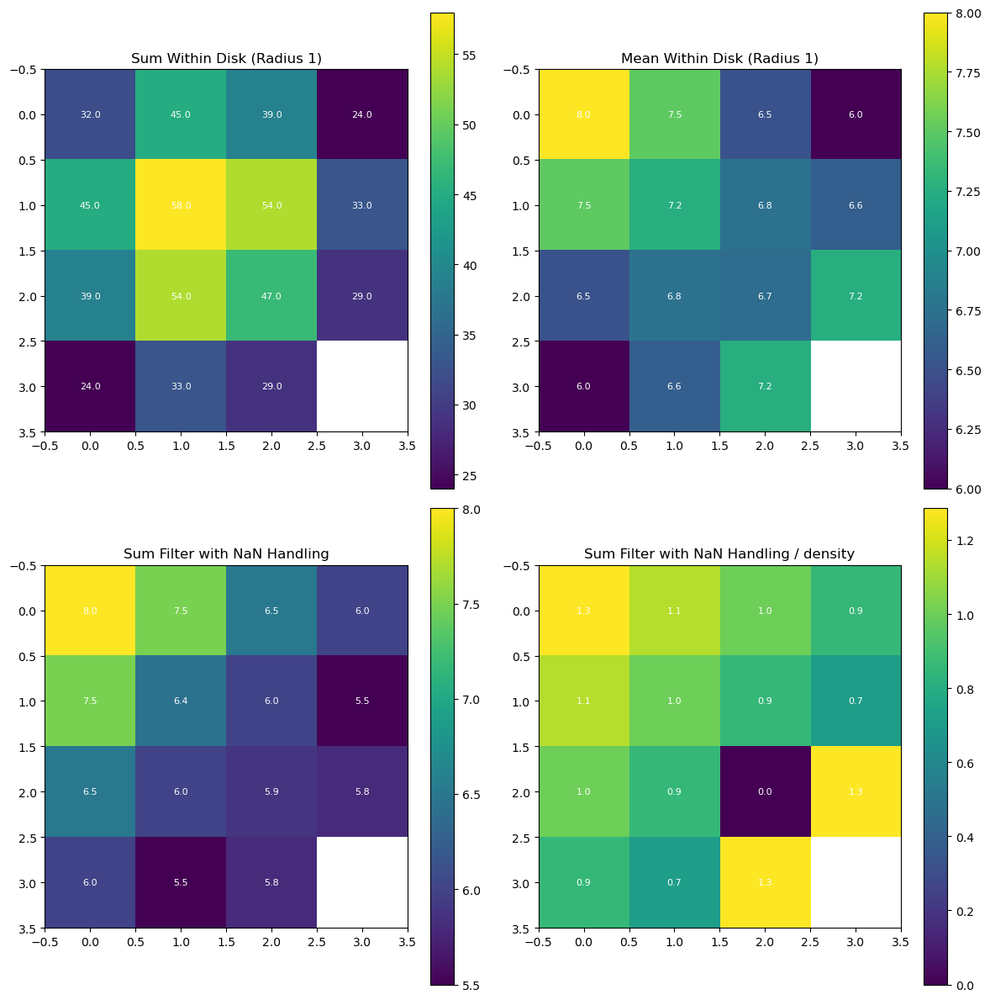

In [16]:
import numpy as np
from collections import deque

import numpy as np
from scipy.ndimage import generic_filter

def mydisk(radius):
    """
    Create a disk-shaped structuring element.
    """
    radiusmask = int(np.floor(radius))
    y, x = np.ogrid[-radiusmask:radiusmask+1, -radiusmask:radiusmask+1]
    mask = x**2 + y**2 <= radius**2
    return mask.astype(int)

def sum_within_disk(image, radius, adjust_filter=None, normalization=False):
    """
    Apply a filter to sum up all the values of the surrounding pixels within a disk of radius R.
    
    Parameters:
        image (numpy.ndarray): Input image.
        radius (int): Radius of the disk.
        
    Returns:
        numpy.ndarray: Filtered image with summed values.
    """
    # Create a disk-shaped footprint
    footprint = mydisk(radius)
    
    # Define a function to sum up the values within the footprint
    def sum_filter(values):
        center_value = values[len(values) // 2]  # Get the center value
        if np.isnan(center_value):  # Check if the center value is NaN
            return np.nan
        return np.nansum(values)
    def sum_filter_without_nan(values):
        center_value = values[len(values) // 2]  # Get the center value
        if np.isnan(center_value):  # Check if the center value is NaN
            return np.nan
        if np.nansum(values > 0) == 0:
            return 0
        return np.nansum(values)/(np.sum(~np.isnan(values)))
    def sum_filter_mean(values):
        center_value = values[len(values) // 2]  # Get the center value
        if np.isnan(center_value):  # Check if the center value is NaN
            return np.nan
        if np.nansum(values > 0) == 0:
            return 0
        return np.nansum(values)/np.nansum(values > 0)
    
    # Apply the generic filter with the sum function and the disk footprint
    if adjust_filter == 'nan':
        filtered_image = generic_filter(image, sum_filter_without_nan, footprint=footprint, mode='constant', cval=np.nan)
    elif adjust_filter == 'mean':
        filtered_image = generic_filter(image, sum_filter_mean, footprint=footprint, mode='constant', cval=np.nan)
    elif adjust_filter == 'mean_averagetotaldensity':
        density_per_pixel = np.nansum(image > 0) / np.nansum(image)
        filtered_image = generic_filter(image.astype(np.float64)*density_per_pixel, sum_filter_mean, footprint=footprint, mode='constant', cval=np.nan)
    else:
        filtered_image = generic_filter(image, sum_filter, footprint=footprint, mode='constant', cval=np.nan)

    if normalization:
        filtered_image = filtered_image / np.nansum(image)
    return filtered_image

def compute_descending_manifold(image, start_pixel, maxdist=None):
    """
    Compute the descending manifold mask for a given pixel in an image.
    
    Parameters:
        image (np.ndarray): 2D array representing the image.
        start_pixel (tuple): Coordinates (row, col) of the starting pixel.
        
    Returns:
        np.ndarray: Binary mask representing the descending manifold.
    """
    # Initialize the mask with zeros
    descending_mask = np.zeros_like(image, dtype=bool)
    
    # Get image dimensions
    rows, cols = image.shape
    
    #Directions for 8-connectivity
    directions = [
        (-1, -1), (-1, 0), (-1, 1),  # Top row
        (0, -1),          (0, 1),    # Middle row
        (1, -1), (1, 0), (1, 1)     # Bottom row
    ]
    # # Directions for 4-connectivity
    # directions = [
    #      (-1, 0), # Top row
    #     (0, -1), (0, 1),    # Middle row
    #      (1, 0), # Bottom row
    # ]
    
    # Starting pixel value
    start_value = image[start_pixel]
    
    # BFS or DFS using a stack or queue
    stack = deque([start_pixel])
    while stack:
        x, y = stack.pop()
        if maxdist is not None and np.linalg.norm(np.array(start_pixel) - np.array((x, y))) > maxdist:
            continue
        if descending_mask[x, y]:
            continue
        descending_mask[x, y] = True

        # Explore 8-connected neighbors
        for dx, dy in directions:
            nx, ny = x + dx, y + dy
            if 0 <= nx < rows and 0 <= ny < cols:  # Ensure within bounds
                if not descending_mask[nx, ny] and image[nx, ny] <= image[x, y]:
                    stack.append((nx, ny))
    
    return descending_mask

# Example image
test = np.array([
    [9, 8, 7, 6],
    [8, 7, 6, 5],
    [7, 6, 0, 9],
    [6, 5, 9, np.nan]
])

# Create subplots
fig, ax = plt.subplots(2, 2, figsize=(12, 12))

# Function to annotate values on the plots
def annotate_with_values(ax, data):
    rows, cols = data.shape
    for i in range(rows):
        for j in range(cols):
            value = data[i, j]
            text = "NaN" if np.isnan(value) else f"{value:.1f}"
            ax.text(j, i, text, ha="center", va="center", color="white", fontsize=8)

# First subplot: Sum within disk
result1 = sum_within_disk(test, 1.5)
im1 = ax[0, 0].imshow(result1, cmap='viridis')
annotate_with_values(ax[0, 0], result1)
fig.colorbar(im1, ax=ax[0, 0])
ax[0, 0].set_title("Sum Within Disk (Radius 1)")

# Second subplot: Mean filter
result2 = sum_within_disk(test, 1.5, adjust_filter='mean')
im2 = ax[0, 1].imshow(result2, cmap='viridis')
annotate_with_values(ax[0, 1], result2)
fig.colorbar(im2, ax=ax[0, 1])
ax[0, 1].set_title("Mean Within Disk (Radius 1)")

# Third subplot: Filter handling NaNs
result3 = sum_within_disk(test, 1.5, adjust_filter='nan')
im3 = ax[1, 0].imshow(result3, cmap='viridis')
annotate_with_values(ax[1, 0], result3)
fig.colorbar(im3, ax=ax[1, 0])
ax[1, 0].set_title("Sum Filter with NaN Handling")

# # Fourth subplot: Descending manifold
# result4 = compute_descending_manifold(test, (1, 1))
# im4 = ax[1, 1].imshow(result4, cmap='viridis')
# annotate_with_values(ax[1, 1], result4.astype(float))
# fig.colorbar(im4, ax=ax[1, 1])
# ax[1, 1].set_title("Descending Manifold (Start: (1, 1))")

# Third subplot: Filter handling NaNs and / average density
result4 = sum_within_disk(test, 1.5, adjust_filter='mean_averagetotaldensity')
density_per_pixel = np.nansum(test > 0) / np.nansum(test)
print(density_per_pixel, 1/density_per_pixel)
result4 = test.astype(np.float64) * density_per_pixel
im4 = ax[1, 1].imshow(result4, cmap='viridis')
annotate_with_values(ax[1, 1], result4)
fig.colorbar(im4, ax=ax[1, 1])
ax[1, 1].set_title("Sum Filter with NaN Handling / density")

# Adjust layout
plt.tight_layout()
plt.show()

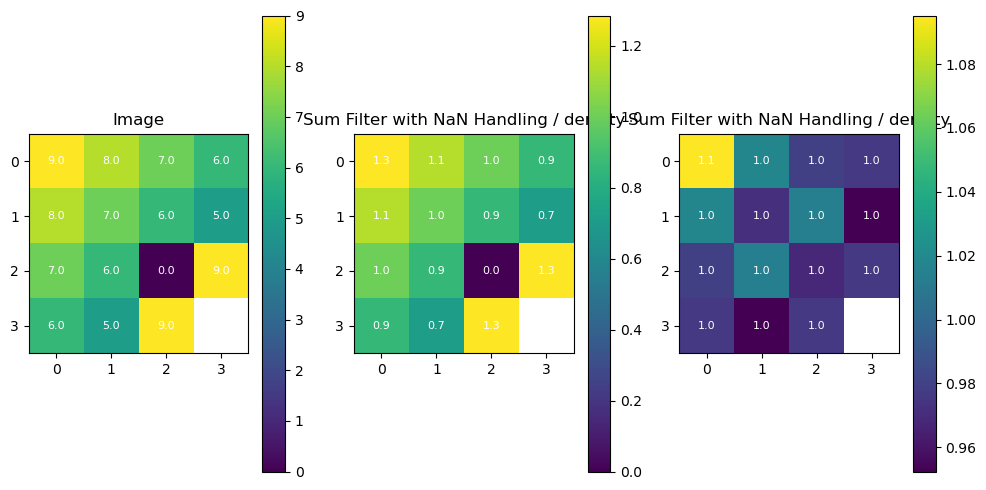

In [28]:
fig, ax = plt.subplots(1,3, figsize=(10,5))

im4 = ax[0].imshow(test, cmap='viridis')
annotate_with_values(ax[0], test)
fig.colorbar(im4, ax=ax[0])
ax[0].set_title("Image")

# Third subplot: Filter handling NaNs and / average density

density_per_pixel = np.nansum(test > 0) / np.nansum(test)
result4 = test.astype(np.float64) * density_per_pixel
im4 = ax[1].imshow(result4, cmap='viridis')
annotate_with_values(ax[1], result4)
fig.colorbar(im4, ax=ax[1])
ax[1].set_title("Sum Filter with NaN Handling / density")

result4 = sum_within_disk(test, 2, adjust_filter='mean_averagetotaldensity')
im4 = ax[2].imshow(result4, cmap='viridis')
annotate_with_values(ax[2], result4)
fig.colorbar(im4, ax=ax[2])
ax[2].set_title("Sum Filter with NaN Handling / density")

fig.tight_layout()

In [5]:
images_nan = []
for img in images:
    img_nan = img.copy()
    img_nan[img_nan == -1] = np.nan
    images_nan.append(img_nan)



In [30]:
filtered_image = []
radii = [0,1,1.5,2,2.5,3, 5, 10, 15, 20, 25, 30, 35, 100, 150]
for radius in tqdm(radii):
    filtered_image.append(sum_within_disk(images_nan[0], radius, adjust_filter='mean_averagetotaldensity'))

100%|██████████| 13/13 [00:23<00:00,  1.84s/it]


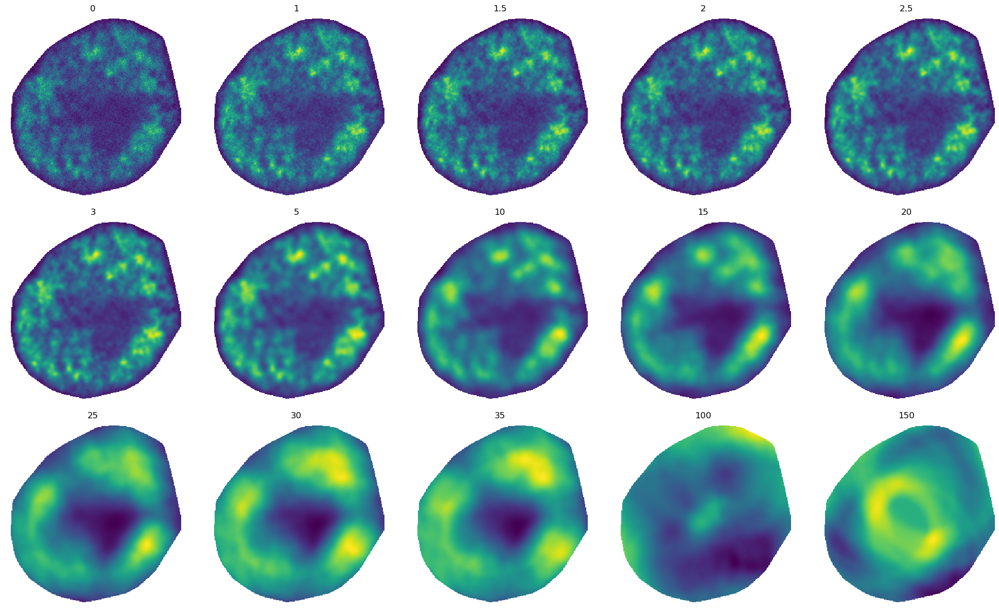

In [60]:
import matplotlib.pyplot as plt

# Determine vmin and vmax for consistent color scaling
vmin = np.nanmin([np.nanmin(img) for img in filtered_image[1:]])
vmax = np.nanmax([np.nanmax(img) for img in filtered_image[1:]])

# Create subplots
fig, axes = plt.subplots(3, 5, figsize=(20, 12))

# Flatten axes for easy iteration
axes = axes.flatten()

# Plot each filtered image
for i, img in enumerate(filtered_image):
    ax = axes[i]
    if radii[i] == 0:
        im = ax.imshow(img, cmap='viridis')
    else:
        # im = ax.imshow(img, cmap='viridis', vmin=vmin, vmax=vmax)
        im = ax.imshow(img, cmap='viridis')
    ax.set_title(f'{radii[i]}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [222]:
from gudhi import CubicalComplex

diags0 = []
diags1 = []
cc_0_pixels = []

fimg = filtered_image[0]
band_around_border = 2
fimgcc = fimg.copy()
fimgcc[np.isnan(fimg)] = -1
minfiltered = scipy.ndimage.minimum_filter(fimgcc, size=2*band_around_border+1)
mask = (minfiltered == -1) & (fimgcc != -1)

for fimg in tqdm(filtered_image):
    fimgcc = fimg.copy()
    fimgcc[np.isnan(fimg)] = 0
    cc = CubicalComplex(top_dimensional_cells=-fimgcc)
    cc.compute_persistence()

    # cofaces and dim 0 persistence
    pers = cc.persistence_intervals_in_dimension(0)
    pers[pers[:, 1] == np.inf] = 0

    cofaces = cc.cofaces_of_persistence_pairs()
    idx_cofaces_0 = np.hstack([cofaces[0][0][:,0], cofaces[1][0]])
    idx_cofaces_0 = np.array([np.unravel_index(x, fimgcc.shape, order='F') for x in idx_cofaces_0])

    # remove points at border
    idx_cofaces = []
    pers_values = []
    for i, idx in enumerate(idx_cofaces_0):
        if mask[idx[0], idx[1]]:
            continue
        pers_values.append(pers[i, :])
        idx_cofaces.append(idx)

    idx_cofaces = np.array(idx_cofaces)
    pers = np.array(pers_values)
    
    # dim 0
    idx = np.where(pers[:,0] != 0)[0]
    diags0.append(pers[idx, :].copy())
    cc_0_pixels.append(idx_cofaces[idx].copy())

    # dim 1
    diags1.append(cc.persistence_intervals_in_dimension(1))

bc = BettiCurve()
betti0 = bc.fit_transform(diags0[1:])
bett0_grid = bc.grid_

bc = BettiCurve()
betti1 = bc.fit_transform(diags1[1:])
bett1_grid = bc.grid_

100%|██████████| 15/15 [00:01<00:00, 10.03it/s]


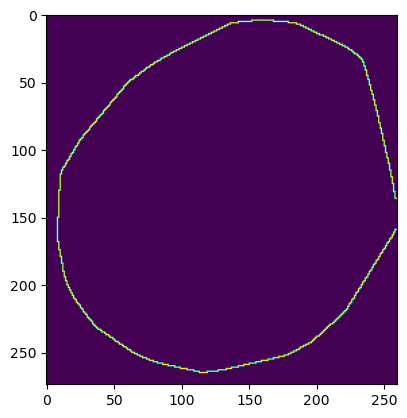

In [88]:
import scipy
minfiltered = scipy.ndimage.minimum_filter(fimgcc, size=3)
mask = (minfiltered == -1) & (fimgcc != -1)
plt.imshow(mask)

In [116]:
from scipy.ndimage import maximum_filter

test = np.zeros([5,5])
test[2,2] = 3
test[3,3] = 2
maximum_filter(test, size=3)

array([[0., 0., 0., 0., 0.],
       [0., 3., 3., 3., 0.],
       [0., 3., 3., 3., 2.],
       [0., 3., 3., 3., 2.],
       [0., 0., 2., 2., 2.]])

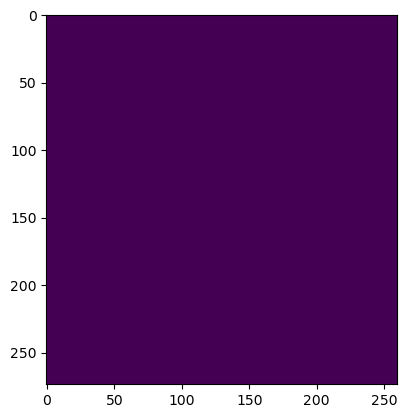

In [120]:
plt.imshow(mask)

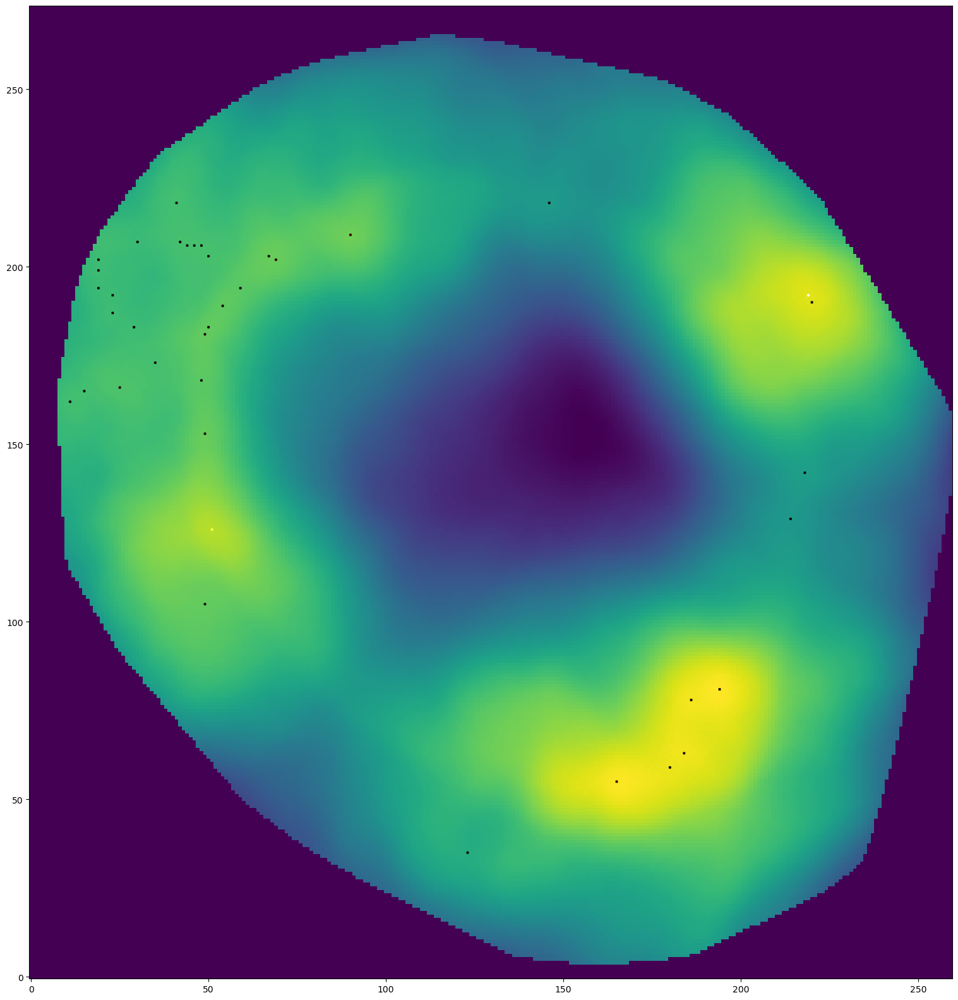

In [211]:
fimg = filtered_image[-3]
band_around_border = 2

fimgcc = fimg.copy()
fimgcc[np.isnan(fimg)] = -1
minfiltered = scipy.ndimage.minimum_filter(fimgcc, size=2*band_around_border+1)
mask = (minfiltered == -1) & (fimgcc != -1)

fimgcc[np.isnan(fimg)] = 0
cc = CubicalComplex(top_dimensional_cells=-fimgcc)
cc.compute_persistence()
pers = cc.persistence_intervals_in_dimension(0)
pers[pers[:,1] == np.inf] = 0

cofaces = cc.cofaces_of_persistence_pairs()
idx_cofaces_0 = np.hstack([cofaces[0][0][:,0], cofaces[1][0]])
idx_cofaces_0 = np.array([np.unravel_index(x, fimgcc.shape, order='F') for x in idx_cofaces_0])

# remove points at border
idx_cofaces = []
pers_values = []
for i, idx in enumerate(idx_cofaces_0):
    if mask[idx[0], idx[1]]:
        continue
    pers_values.append(pers[i, :])
    idx_cofaces.append(idx)

idx_cofaces = np.array(idx_cofaces)
pers = np.array(pers_values)

fig, ax = plt.subplots(1,1, figsize=(20,20))
ax.imshow(fimgcc, cmap='viridis', origin='lower', vmin=np.unique(fimgcc)[1])
ax.scatter(idx_cofaces[:,1], idx_cofaces[:,0],
        #    s=pers[:,1] - pers[:,0],
        s= 5,
           c=pers[:,1] - pers[:,0], cmap='hot', marker='x')

In [213]:
# prepare_for_ballmapper = {}
# for i, idx in enumerate(idx_cofaces):
#     prepare_for_ballmapper[f'{i}'] = [idx[1], idx[0], pers[i,0], pers[i,1]]
# prepare_for_ballmapper['filtered_image'] = filtered_image
# prepare_for_ballmapper['radii'] = radii

# np.savez_compressed('prepare_for_ballmapper.npz', **prepare_for_ballmapper)

In [219]:
idx_cofaces

array([[ 78, 186],
       [ 59, 180],
       [ 63, 184],
       [ 55, 165],
       [190, 220],
       [203,  67],
       [153,  49],
       [105,  49],
       [183,  50],
       [189,  54],
       [168,  48],
       [202,  69],
       [194,  59],
       [181,  49],
       [209,  90],
       [203,  50],
       [206,  46],
       [206,  48],
       [206,  44],
       [207,  42],
       [166,  25],
       [173,  35],
       [218,  41],
       [165,  15],
       [162,  11],
       [183,  29],
       [202,  19],
       [199,  19],
       [187,  23],
       [192,  23],
       [194,  19],
       [207,  30],
       [ 35, 123],
       [142, 218],
       [126,  51],
       [218, 146],
       [129, 214],
       [192, 219],
       [ 81, 194]])

In [232]:
diags0[index][:,0].shape

(40,)

array([[ 2.60299058e-03, -1.50093959e+00, -1.49833659e+00],
       [ 1.82998126e-02, -1.51375734e+00, -1.49545753e+00],
       [ 1.18317754e-04, -1.45826632e+00, -1.45814800e+00],
       [ 1.57757005e-03, -1.38053155e+00, -1.37895398e+00],
       [ 3.15514010e-04, -1.37816520e+00, -1.37784968e+00],
       [ 3.15514010e-03, -1.37907230e+00, -1.37591716e+00],
       [ 5.40317742e-03, -1.37950613e+00, -1.37410295e+00],
       [ 1.01753268e-02, -1.38108370e+00, -1.37090837e+00],
       [ 3.94392513e-04, -1.36041753e+00, -1.36002314e+00],
       [ 8.67663528e-04, -1.36037809e+00, -1.35951043e+00],
       [ 1.97196256e-04, -1.35742015e+00, -1.35722295e+00],
       [ 2.25592517e-02, -1.37887510e+00, -1.35631585e+00],
       [ 8.67663528e-04, -1.34065847e+00, -1.33979080e+00],
       [ 6.31028020e-04, -1.33190295e+00, -1.33127193e+00],
       [ 3.15514010e-04, -1.32969436e+00, -1.32937884e+00],
       [ 1.02542053e-03, -1.32819566e+00, -1.32717024e+00],
       [ 9.85981282e-04, -1.32799847e+00

,persistence,birth,death
0,0.002603,-1.500940,-1.498337
1,0.018300,-1.513757,-1.495458
2,0.000118,-1.458266,-1.458148
3,0.001578,-1.380532,-1.378954
4,0.000316,-1.378165,-1.377850
5,0.003155,-1.379072,-1.375917
6,0.005403,-1.379506,-1.374103
7,0.010175,-1.381084,-1.370908
8,0.000394,-1.360418,-1.360023
9,0.000868,-1.360378,-1.359510


In [243]:
from python_ball_mapper.pyBallMapper import BallMapper
from matplotlib.colors import ListedColormap
from matplotlib import cm
import networkx as nx


index = 10
npindices_birth = cc_0_pixels[index]
pers_values = diags0[index][:, 1] - diags0[index][:, 0]
coloring_df = pd.DataFrame(np.vstack([pers_values, diags0[index][:,0], diags0[index][:,1]]).T, columns=['persistence', 'birth', 'death'])

bm = BallMapper(points = npindices_birth, # the pointcloud, as a numpy array
                coloring_df = coloring_df, # a dataframe with the coloring functions (in this case the pointcloud itself)
                epsilon = 2*10) # the radius of the balls

my_rainbow_palette = cm.get_cmap(name='viridis')

# we can color the graph by any column in coloring_df
bm.color_by_variable('persistence', my_rainbow_palette)

plt.figure(figsize= (8,6))

nx.draw_networkx(bm.Graph, 
                 pos=nx.spring_layout(bm.Graph, seed=42),
                 node_color = [bm.Graph.nodes[node]['color'] for node in bm.Graph.nodes],
                 node_size =  [bm.Graph.nodes[node]['size rescaled'] for node in bm.Graph.nodes],
                 alpha=0.8)

# plot a legend
sm = plt.cm.ScalarMappable(cmap = my_rainbow_palette,
                           norm = plt.Normalize(vmin=bm.min_color_value, 
                                                vmax=bm.max_color_value))
# plt.colorbar(sm)
plt.title('BM graph colored by price')
plt.show()

AttributeError: 'Series' object has no attribute 'iteritems'

In [221]:
### DUPLIOCATE

# from gudhi import CubicalComplex

# diags0 = []
# diags1 = []
# cc_0_pixels = []

# fimg = filtered_image[0]
# band_around_border = 2
# fimgcc = fimg.copy()
# fimgcc[np.isnan(fimg)] = -1
# minfiltered = scipy.ndimage.minimum_filter(fimgcc, size=2*band_around_border+1)
# mask = (minfiltered == -1) & (fimgcc != -1)

# for fimg in tqdm(filtered_image):
#     fimgcc = fimg.copy()
#     fimgcc[np.isnan(fimg)] = 0
#     cc = CubicalComplex(top_dimensional_cells=-fimgcc)
#     cc.compute_persistence()

#     # cofaces and dim 0 persistence
#     pers = cc.persistence_intervals_in_dimension(0)
#     pers[pers[:, 1] == np.inf] = 0

#     cofaces = cc.cofaces_of_persistence_pairs()
#     idx_cofaces_0 = np.hstack([cofaces[0][0][:,0], cofaces[1][0]])
#     idx_cofaces_0 = np.array([np.unravel_index(x, fimgcc.shape, order='F') for x in idx_cofaces_0])

#     # remove points at border
#     idx_cofaces = []
#     pers_values = []
#     for i, idx in enumerate(idx_cofaces_0):
#         if mask[idx[0], idx[1]]:
#             continue
#         pers_values.append(pers[i, :])
#         idx_cofaces.append(idx)

#     idx_cofaces = np.array(idx_cofaces)
#     pers = np.array(pers_values)
    
#     # dim 0
#     idx = np.where(pers[:,0] != 0)[0]
#     diags0.append(pers[idx, :].copy())
#     cc_0_pixels.append(idx_cofaces[idx].copy())

#     # dim 1
#     diags1.append(cc.persistence_intervals_in_dimension(1))

# bc = BettiCurve()
# betti0 = bc.fit_transform(diags0[1:])
# bett0_grid = bc.grid_

# bc = BettiCurve()
# betti1 = bc.fit_transform(diags1[1:])
# bett1_grid = bc.grid_

100%|██████████| 15/15 [00:01<00:00, 10.24it/s]


## Ballmapper

In [ ]:
from python_ball_mapper.pyBallMapper import BallMapper
from matplotlib.colors import ListedColormap
from matplotlib import cm
import networkx as nx

## distribution of distances

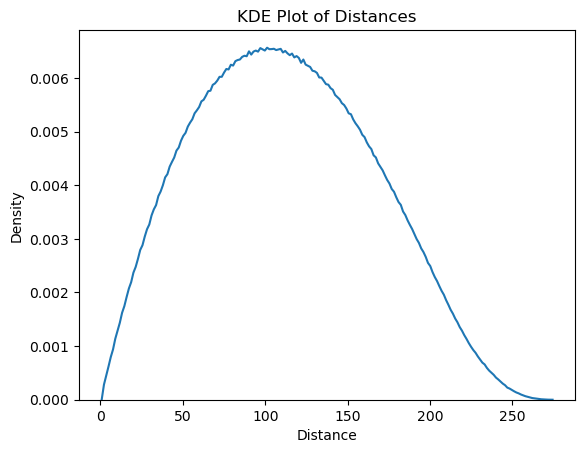

In [167]:
from scipy.spatial.distance import pdist
import seaborn as sns

distances = pdist(cc_0_pixels[0])
val, count = np.unique(distances, return_counts=True)
hist, bins = np.histogram(pdist(cc_0_pixels[0]), bins=1000)
# plt.plot((bins[:-1]+bins[1:])/2, hist)
# plt.scatter(count, val)

sns.kdeplot(distances, bw_adjust=0.2)
plt.title("KDE Plot of Distances")
plt.xlabel("Distance")
plt.ylabel("Density")
plt.show()

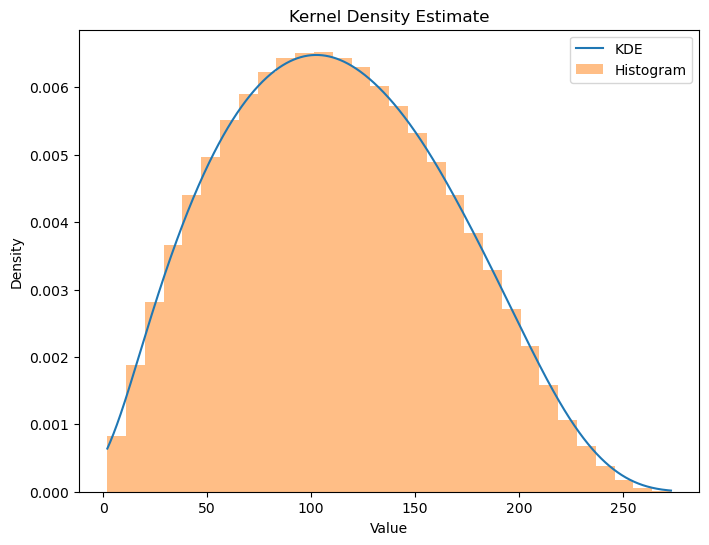

In [170]:
# Evaluate KDE on a grid
x_grid = np.linspace(min(distances), max(distances), 3000)
kde_values = kde(x_grid)

# Plot the KDE
plt.figure(figsize=(8, 6))
plt.plot(x_grid, kde_values, label='KDE')
plt.hist(distances, bins=30, density=True, alpha=0.5, label='Histogram')
plt.xlabel('Value')
plt.ylabel('Density')
plt.title('Kernel Density Estimate')
plt.legend()
plt.show()

In [176]:
import numpy as np
from scipy.spatial import distance

def max_distance_in_mask(mask):
    # Get the coordinates of all points in the mask
    points = np.argwhere(mask)
    
    # Compute the pairwise distances between all points
    pairwise_distances = distance.pdist(points)
    
    # Find the maximum distance
    max_distance = np.max(pairwise_distances)
    
    return max_distance

# Example usage
mask = (img != -1).astype(bool)
max_dist = max_distance_in_mask(mask)
print(f"Maximal distance between two points in the mask: {max_dist}")

Maximal distance between two points in the mask: 376.31104156003715


Diameter: 281.04270138183625
4544 10321696 17054
2223 2469753 16215
1843 1697403 15596
1177 692076 14395
962 462241 13827
953 453628 13759
432 93096 10060
166 13695 5271
93 4278 2799
49 1176 1042
40 780 736
34 561 531
38 703 639
32 496 462
68 2278 1577


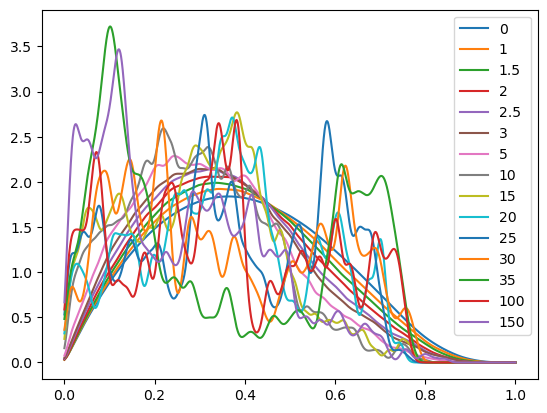

In [205]:
for region in regionprops(label(~np.isnan(fimg))):
    diameter = region.feret_diameter_max
    print(f"Diameter: {diameter}")
    break
x_grid = np.linspace(0, 1, 3000)

KDEs = []
for cc_0_pixel in cc_0_pixels:
    distances = pdist(cc_0_pixel) / diameter
    val, counts = np.unique(distances, return_counts=True)
    print(len(cc_0_pixel), len(distances), len(val))

    # kde = gaussian_kde(val, bw_method=0.007, weights=counts)
    kde = gaussian_kde(val, bw_method=0.05, weights=counts)
    KDEs.append(kde(x_grid))

KDEs = np.array(KDEs)

for i, kde in enumerate(KDEs):
    plt.plot(x_grid, kde, label=f'{radii[i]}')
plt.legend()

Diameter: 281.04270138183625


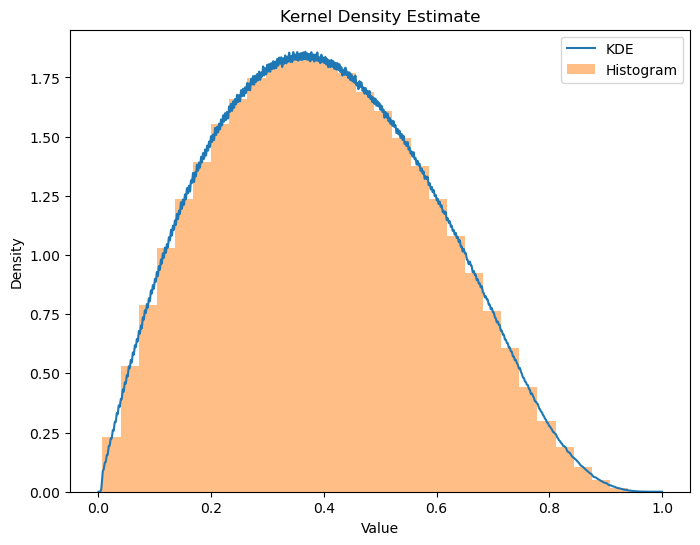

In [194]:
from scipy.stats import gaussian_kde

for region in regionprops(label(~np.isnan(fimg))):
    diameter = region.feret_diameter_max
    print(f"Diameter: {diameter}")
    break
distances = pdist(cc_0_pixels[0]) / diameter
val, counts = np.unique(distances, return_counts=True)

x_grid = np.linspace(0, 1, 3000)

kde = gaussian_kde(val, bw_method=0.007, weights=counts)
kde_values = kde(x_grid)

plt.figure(figsize=(8, 6))
plt.plot(x_grid, kde_values, label='KDE')
plt.hist(distances, bins=30, density=True, alpha=0.5, label='Histogram')
plt.xlabel('Value')
plt.ylabel('Density')
plt.title('Kernel Density Estimate')
plt.legend()
plt.show()

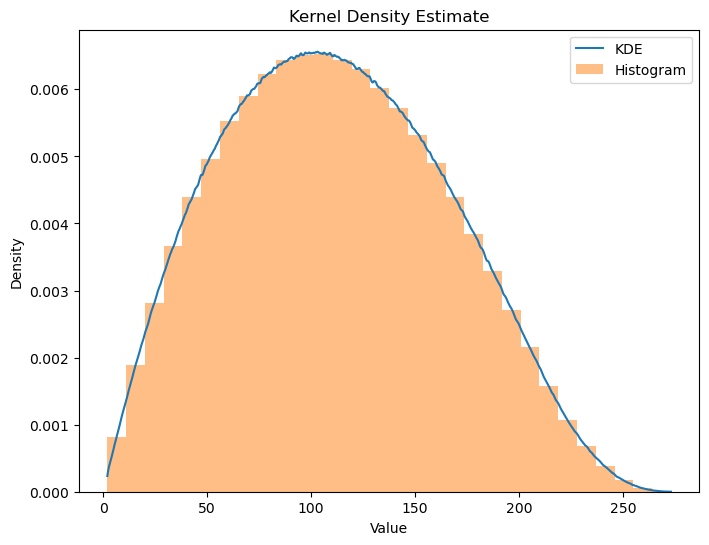

In [174]:
import numpy as np
from scipy.stats import gaussian_kde

import matplotlib.pyplot as plt

# Create KDE
val, counts = np.unique(distances, return_counts=True)
kde = gaussian_kde(val, bw_method=0.01, weights=counts)

# Evaluate KDE on a grid
x_grid = np.linspace(min(distances), max(distances), 3000)
kde_values = kde(x_grid)

# Plot the KDE
plt.figure(figsize=(8, 6))
plt.plot(x_grid, kde_values, label='KDE')
plt.hist(distances, bins=30, density=True, alpha=0.5, label='Histogram')
plt.xlabel('Value')
plt.ylabel('Density')
plt.title('Kernel Density Estimate')
plt.legend()
plt.show()

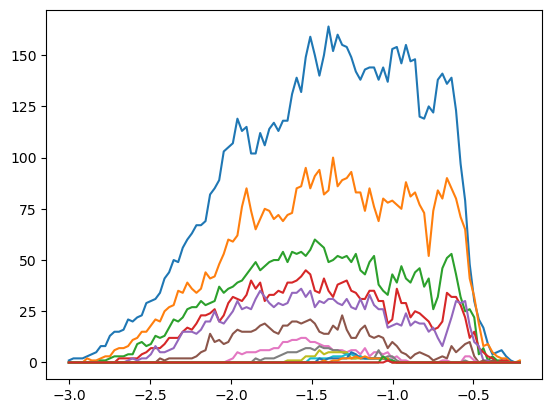

In [137]:
plt.plot(bett0_grid, betti0.T)